In [2]:
import pandas as pd
import tsfresh
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import LabelEncoder, StandardScaler

In [4]:
df = pd.read_csv('../data/graded_data.csv')


In [6]:
target = pd.read_csv('../data/last_attempt.csv')

In [7]:
target

,Slide ID,Well,Morphological Grade - Value
0,D2018.04.21_S01773_I0149_D,9,2.5
1,D2018.09.17_S01862_I0149_D,9,3
2,D2016.02.27_S1244_I149,8,2.5
3,D2016.02.27_S1244_I149,9,1
4,D2016.10.23_S1422_I149,3,3.5
...,...,...,...
3995,D2019.05.29_S02006_I0149_D,1,2
3996,D2016.11.24_S1437_I149,11,3
3997,D2018.05.18_S01807_I0149_D,4,2
3998,D2016.02.08_S1220_I149,7,1.5


In [8]:
target['id'] = target['Slide ID'] + '_' + target['Well'].astype(str)

In [10]:
zoe = pd.read_excel('../data/latest_Zoe central.xlsx')

In [11]:
columns_of_interest = [
    'Well', 'Slide ID', 'Grade at approx. 65h - Zoe',
    'Grade at approx. 65h - Chrysa', 'HCG Test', 'Gestational Sacs',
    'Fetal Heart Beat', 'pgs', 'Morphological Grade - Value', 'tPNf', 't2',
    't3', 't4', 't5', 't6', 't7'
]

In [12]:
with_fetal_heart = zoe.loc[zoe['Fetal Heart Beat'].notnull()]

In [13]:
failed = with_fetal_heart.loc[with_fetal_heart['Fetal Heart Beat'] == 0]

In [14]:
succeesfull = with_fetal_heart.drop(
    failed.index).loc[with_fetal_heart['Fetal Heart Beat'] != 'Unknown']

In [15]:
temp = zoe.loc[failed['Slide ID'].unique()][columns_of_interest[-7:]].dropna()

KeyError: "None of [Index(['D2011.06.24_S0076_I149', 'D2011.07.07_S0083_I149',\n       'D2011.09.24_S0092_I149', 'D2011.10.18_S0104_I149',\n       'D2011.10.19_S0108_I149', 'D2011.11.21_S0138_I149',\n       'D2011.12.02_S0139_I149', 'D2012.01.10_S0154_I149',\n       'D2012.01.13_S0159_I149', 'D2012.05.03_S0246_I149',\n       ...\n       'D2020.06.12_S02252_I0149_D', 'D2020.06.13_S02254_I0149_D',\n       'D2020.06.27_S02259_I0149_D', 'D2020.06.27_S02260_I0149_D',\n       'D2020.07.06_S02268_I0149_D', 'D2020.07.07_S02269_I0149_D',\n       'D2020.07.09_S02271_I0149_D', 'D2020.07.11_S02273_I0149_D',\n       'D2020.09.10_S02288_I0149_D', 'D2020.09.12_S02290_I0149_D'],\n      dtype='object', length=423)] are in the [index]"

In [16]:
temp.groupby(temp.index).apply(lambda x: x.shape[0]).head(150)

NameError: name 'temp' is not defined

In [17]:
zoe.loc['D2017.01.24_S1481_I149'][columns_of_interest + ['Decision']]

KeyError: 'D2017.01.24_S1481_I149'

In [18]:
zoe.loc[[
    'D2016.03.08_S1253_I149', 'D2017.01.24_S1481_I149',
    'D2017.09.19_S1622_I149', 'D2018.05.05_S01789_I0149_D'
]].reset_index(drop=True).to_excel('cases_for_reports.xlsx', index=False)

KeyError: "None of [Index(['D2016.03.08_S1253_I149', 'D2017.01.24_S1481_I149',\n       'D2017.09.19_S1622_I149', 'D2018.05.05_S01789_I0149_D'],\n      dtype='object')] are in the [index]"

In [19]:
zoe.loc['']['Decision']

KeyError: ''

In [20]:
zoe.loc['D2018.05.05_S01789_I0149_D']['HCG Test']

KeyError: 'D2018.05.05_S01789_I0149_D'

In [21]:
zoe.loc['D2020.07.06_S02267_I0149_D', 'D2020.07.13_S02274_I0149_D']

KeyError: 'D2020.07.13_S02274_I0149_D'

In [22]:
successfull_full

NameError: name 'successfull_full' is not defined

In [23]:
zoe['embryo_id'] = zoe['Slide ID'] + '_' + zoe['Well'].astype(str)

In [24]:
zoe['Day3 Cells'].value_counts().sum()

np.int64(2264)

In [25]:
with_grades = zoe[pd.to_numeric(zoe['Morphological Grade - Value'],
                                errors='coerce').notnull()]

In [26]:
with_grades['Morphological Grade - Value'].value_counts()

Morphological Grade - Value
2      3405
2.5    2340
1.5    2068
3      1646
1      1195
3.5     771
4       334
Name: count, dtype: int64

In [27]:
import glob

all_extracted = pd.concat(
    [pd.read_csv(f) for f in glob.glob('all_extracted/*')])

ValueError: No objects to concatenate

In [28]:
all_extracted.embryo_id.unique()

NameError: name 'all_extracted' is not defined

In [29]:
zoe.index = zoe['embryo_id']


In [30]:
zoe_extracted = zoe.loc[all_extracted.embryo_id.unique()]

NameError: name 'all_extracted' is not defined

In [31]:
extracted_with_grades = zoe_extracted[pd.to_numeric(
    zoe_extracted['Morphological Grade - Value'], errors='coerce').notnull()]

NameError: name 'zoe_extracted' is not defined

In [303]:
all_extracted.index = all_extracted['embryo_id']


In [305]:
all_extracted_graded = all_extracted.loc[extracted_with_grades.index]

In [315]:
all_extracted_graded['time_hours'] = 24*all_extracted_graded.reset_index(drop=True).groupby('embryo_id').apply(lambda x: x['Time']-x['Time'].min()).values

In [316]:
data_d2 = all_extracted_graded.loc[all_extracted_graded['time_hours']<=48]

In [328]:
data_d2['time_hours']

embryo_id
D2011.06.01_S0060_I149_2          0.000000
D2011.06.01_S0060_I149_2          0.334557
D2011.06.01_S0060_I149_2          0.668048
D2011.06.01_S0060_I149_2          1.001372
D2011.06.01_S0060_I149_2          1.334797
                                   ...    
D2019.05.31_S02009_I0149_D_12    46.770824
D2019.05.31_S02009_I0149_D_12    47.020903
D2019.05.31_S02009_I0149_D_12    47.271026
D2019.05.31_S02009_I0149_D_12    47.521128
D2019.05.31_S02009_I0149_D_12    47.771352
Name: time_hours, Length: 1675476, dtype: float64

In [319]:
y = extracted_with_grades['Morphological Grade - Value']

,embryo_id,time_hours,eccentricity,minor_axis_length,major_axis_length,solidity,area,area_diff,major_axis_length_diff,eccentricity_diff,minor_axis_length_diff,solidity_diff,perimeter,equivalent_diameter,inertia_tensor-0-0,inertia_tensor-0-1,inertia_tensor-1-0,inertia_tensor-1-1
embryo_id,,,,,,,,,,,,,,,,,,
D2011.06.01_S0060_I149_2,D2011.06.01_S0060_I149_2,0.000000,0.315276,103.735,109.31,0.988225,8896,NaN,NaN,NaN,NaN,NaN,351.948,106.427,678.6,-20.2878,-20.2878,740.759
D2011.06.01_S0060_I149_2,D2011.06.01_S0060_I149_2,0.334557,0.310186,103.979,109.374,0.989026,8922,26,0.063308,-0.00509047,0.243391,0.000800768,350.777,106.583,682.148,-20.5146,-20.5146,741.236
D2011.06.01_S0060_I149_2,D2011.06.01_S0060_I149_2,0.668048,0.298713,103.776,108.741,0.987393,8850,-72,-0.632587,-0.0114725,-0.20264,-0.00163299,350.191,106.152,678.136,-17.5249,-17.5249,733.994
D2011.06.01_S0060_I149_2,D2011.06.01_S0060_I149_2,1.001372,0.334924,103.368,109.704,0.988775,8897,47,0.962643,0.0362111,-0.40849,0.00138267,349.948,106.433,675.74,-24.6293,-24.6293,744.244
D2011.06.01_S0060_I149_2,D2011.06.01_S0060_I149_2,1.334797,0.328083,103.438,109.498,0.98777,8884,-13,-0.205192,-0.00684111,0.0698707,-0.00100566,351.362,106.355,674.469,-20.7737,-20.7737,743.607
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
D2019.05.31_S02009_I0149_D_12,D2019.05.31_S02009_I0149_D_12,46.770824,0.564736,95.884,116.185,0.966611,8685,-45,-0.0777212,0.00403666,-0.383613,-0.00414401,363.605,105.157,634.93,112.215,112.215,783.359
D2019.05.31_S02009_I0149_D_12,D2019.05.31_S02009_I0149_D_12,47.020903,0.57292,95.6017,116.643,0.967104,8702,17,0.457968,0.00818369,-0.282262,0.000492782,363.848,105.26,637.316,118.652,118.652,784.258
D2019.05.31_S02009_I0149_D_12,D2019.05.31_S02009_I0149_D_12,47.271026,0.588032,94.6594,117.031,0.96492,8637,-65,0.388723,0.0151123,-0.942275,-0.00218368,364.434,104.866,627.893,124.429,124.429,788.154


In [339]:

def extract_ts_features(df, column_sort, column_id, features_to_extract):
    if features_to_extract:
        extracted_features = extract_features(df,
                         column_sort=column_sort,
                         kind_to_fc_parameters=features_to_extract,
                         column_id=column_id)
    else:
        settings = EfficientFCParameters()
        extracted_features = extract_features(df,
                         column_sort=column_sort,
                          default_fc_parameters=settings,
                         column_id=column_id,n_jobs=15)
        
    return extracted_features

In [45]:
morpho_task_keys = [
    '36_hours_morpho',
     '48_hours_morpho',
     '60_hours_morpho', 
     '72_hours_morpho',
            ]

In [331]:
features = [
                'embryo_id', 'time_hours', 'eccentricity', 'minor_axis_length',
                'major_axis_length', 'solidity', 'area', 'area_diff',
                'major_axis_length_diff', 'eccentricity_diff',
                'minor_axis_length_diff', 'solidity_diff', 'perimeter',
                'equivalent_diameter', 'inertia_tensor-0-0',
                'inertia_tensor-0-1', 'inertia_tensor-1-0',
                'inertia_tensor-1-1'
            ]

ValueError: could not convert string to float: '[]'

In [346]:
new_df = data_d2.copy()

In [347]:
new_cols = []
for c in features[1:]:
    new_df = new_df[pd.to_numeric(
        new_df[c],
        errors='coerce').notnull()]
    

In [354]:
new_df[features[1:]] = new_df[features[1:]].astype(float)

In [356]:
new_df = new_df.fillna(0)

In [ ]:
extracted_features_d2 = extract_ts_features(new_df[features].reset_index(drop=True),
                                            column_sort='time_hours',
                                           column_id='embryo_id'
                                            ,features_to_extract=None)


Feature Extraction:   0%|                            | 0/75 [00:00<?, ?it/s]

In [337]:
data_d2[features]

,embryo_id,time_hours,eccentricity,minor_axis_length,major_axis_length,solidity,area,area_diff,major_axis_length_diff,eccentricity_diff,minor_axis_length_diff,solidity_diff,perimeter,equivalent_diameter,inertia_tensor-0-0,inertia_tensor-0-1,inertia_tensor-1-0,inertia_tensor-1-1
embryo_id,,,,,,,,,,,,,,,,,,
D2011.06.01_S0060_I149_2,D2011.06.01_S0060_I149_2,0.000000,0.315276,103.735,109.31,0.988225,8896,NaN,NaN,NaN,NaN,NaN,351.948,106.427,678.6,-20.2878,-20.2878,740.759
D2011.06.01_S0060_I149_2,D2011.06.01_S0060_I149_2,0.334557,0.310186,103.979,109.374,0.989026,8922,26,0.063308,-0.00509047,0.243391,0.000800768,350.777,106.583,682.148,-20.5146,-20.5146,741.236
D2011.06.01_S0060_I149_2,D2011.06.01_S0060_I149_2,0.668048,0.298713,103.776,108.741,0.987393,8850,-72,-0.632587,-0.0114725,-0.20264,-0.00163299,350.191,106.152,678.136,-17.5249,-17.5249,733.994
D2011.06.01_S0060_I149_2,D2011.06.01_S0060_I149_2,1.001372,0.334924,103.368,109.704,0.988775,8897,47,0.962643,0.0362111,-0.40849,0.00138267,349.948,106.433,675.74,-24.6293,-24.6293,744.244
D2011.06.01_S0060_I149_2,D2011.06.01_S0060_I149_2,1.334797,0.328083,103.438,109.498,0.98777,8884,-13,-0.205192,-0.00684111,0.0698707,-0.00100566,351.362,106.355,674.469,-20.7737,-20.7737,743.607
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
D2019.05.31_S02009_I0149_D_12,D2019.05.31_S02009_I0149_D_12,46.770824,0.564736,95.884,116.185,0.966611,8685,-45,-0.0777212,0.00403666,-0.383613,-0.00414401,363.605,105.157,634.93,112.215,112.215,783.359
D2019.05.31_S02009_I0149_D_12,D2019.05.31_S02009_I0149_D_12,47.020903,0.57292,95.6017,116.643,0.967104,8702,17,0.457968,0.00818369,-0.282262,0.000492782,363.848,105.26,637.316,118.652,118.652,784.258
D2019.05.31_S02009_I0149_D_12,D2019.05.31_S02009_I0149_D_12,47.271026,0.588032,94.6594,117.031,0.96492,8637,-65,0.388723,0.0151123,-0.942275,-0.00218368,364.434,104.866,627.893,124.429,124.429,788.154


In [47]:
merged_r_alligned['area_diff'] = merged_r_alligned.groupby('id').area.diff().fillna(0)
merged_r_alligned['solidity_diff'] = merged_r_alligned.groupby('id').solidity.diff().fillna(0)
merged_r_alligned['eccentricity_diff'] = merged_r_alligned.groupby('id').eccentricity.diff().fillna(0)
merged_r_alligned['major_axis_length_diff'] = merged_r_alligned.groupby('id').major_axis_length.diff().fillna(0)
merged_r_alligned['minor_axis_length_diff'] = merged_r_alligned.groupby('id').minor_axis_length.diff().fillna(0)

In [48]:
merged_r_alligned[features]

,id,Time,eccentricity,minor_axis_length,major_axis_length,solidity,area,area_diff,major_axis_length_diff,eccentricity_diff,minor_axis_length_diff,solidity_diff,perimeter,equivalent_diameter,inertia_tensor-0-0,inertia_tensor-0-1,inertia_tensor-1-0,inertia_tensor-1-1
0,D2016.09.23_S1395_I149_2,0.000000,0.099899,98.509856,99.005117,0.990429,7658,0.0,0.000000,0.000000,0.000000,0.000000,324.391919,98.744460,610.292279,2.970105,2.970105,608.845527
1,D2016.09.23_S1395_I149_2,0.010500,0.146446,98.179546,99.249588,0.990933,7650,-8.0,0.244470,0.046547,-0.330310,0.000503,324.048773,98.692870,615.547939,1.184343,1.184343,602.558554
2,D2016.09.23_S1395_I149_2,0.020999,0.083017,98.262906,98.603273,0.990883,7608,-42.0,-0.646315,-0.063429,0.083360,-0.000050,322.977705,98.421575,607.619274,-0.424927,-0.424927,603.518490
3,D2016.09.23_S1395_I149_2,0.031499,0.121893,97.977473,98.713551,0.990350,7594,-14.0,0.110278,0.038876,-0.285433,-0.000534,323.563492,98.330977,605.558191,-4.398515,-4.398515,603.438709
4,D2016.09.23_S1395_I149_2,0.041999,0.171513,97.500385,98.966883,0.991235,7577,-17.0,0.253331,0.049620,-0.477088,0.000885,322.735065,98.220853,599.533999,-8.246114,-8.246114,606.764058
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
771521,D2019.05.29_S02006_I0149_D_8,4.903332,0.246710,100.568652,103.776437,0.963081,8139,44.0,0.094692,-0.010096,0.364086,0.004185,352.433550,101.798314,633.996666,-8.546979,-8.546979,671.228500
771522,D2019.05.29_S02006_I0149_D_8,4.913832,0.287239,99.483118,103.859890,0.965927,8051,-88.0,0.083453,0.040530,-1.085535,0.002846,349.119841,101.246489,622.240707,-13.834648,-13.834648,670.494763
771523,D2019.05.29_S02006_I0149_D_8,4.924332,0.285921,99.659998,104.001748,0.965839,8086,35.0,0.141857,-0.001318,0.176880,-0.000088,350.776695,101.466324,630.076176,-20.692383,-20.692383,666.703742
771524,D2019.05.29_S02006_I0149_D_8,4.934831,0.271358,100.189609,104.095413,0.963757,8137,51.0,0.093665,-0.014564,0.529611,-0.002082,352.190909,101.785805,633.136534,-15.944452,-15.944452,671.476759


In [49]:
timestep_per_morpho_task = {}
for morpho_task in morpho_task_keys:
    step = 12
    total_t = morpho_task.split('_')[0]
    dts = [(i,i+step) for i in range(0,int(1*total_t), step)]
    timestep_per_morpho_task[morpho_task] = dts
    

In [50]:
from tsfresh.feature_extraction import EfficientFCParameters, MinimalFCParameters
settings = EfficientFCParameters()
#settings = MinimalFCParameters()
# Set here the options of the settings object as shown in the paragraphs below
from tsfresh.feature_extraction import extract_features

extracted_feats_per_timestep = {}
step = 12
total_t = 72
all_dts = [(i,i+step) for i in range(0,int(1*total_t), step)]

for dt in dts:
    msk = (24*merged_r_alligned.Time<=dt[1])&(24*merged_r_alligned.Time>dt[0])
    df_masked = merged_r_alligned.loc[msk][features].fillna(0)
    extracted_features = extract_ts_features(df=df_masked,
                        column_sort='Time',
                        column_id='id',
                        features_to_extract=None
                       )

    extracted_features.columns = [f"{c}__{dt}" for c in extracted_features.columns]
    extracted_feats_per_timestep[f"{dt}"] = extracted_features

Feature Extraction: 100%|████████████████████████████████████████████████████████████| 140/140 [01:41<00:00,  1.38it/s]


In [109]:
extracted_feats_per_task = {}
for key, dts in timestep_per_morpho_task.items():
    task_df = pd.concat([extracted_feats_per_timestep[f"{dt}"] for dt in dts], axis=1)
    extracted_feats_per_task[key] = task_df

In [52]:
import pickle
blasto_settings = pickle.load(open('trained_models/features_to_extract_tsfresh.pkl', 'rb'))

In [53]:
extracted_features_blasto = extract_ts_features(df=merged_r_alligned[features].fillna(0),
                        column_sort='Time',
                        column_id='id',
                        features_to_extract=blasto_settings
                       )

Feature Extraction: 100%|████████████████████████████████████████████████████████████| 140/140 [00:40<00:00,  3.50it/s]


In [136]:
blasto_target

id
D2016.09.23_S1395_I149_2        -946.283497
D2016.09.23_S1395_I149_3        -996.571049
D2016.09.23_S1395_I149_4        -872.703030
D2016.09.23_S1395_I149_5         505.539114
D2016.09.26_S1397_I149_1        1425.756284
                                   ...     
D2019.05.29_S02006_I0149_D_2    -197.150849
D2019.05.29_S02006_I0149_D_4      47.228272
D2019.05.29_S02006_I0149_D_5     843.890609
D2019.05.29_S02006_I0149_D_7     220.738761
D2019.05.29_S02006_I0149_D_8     166.341658
Length: 1717, dtype: float64

In [135]:
y_area = blasto_target.loc[extracted_features_blasto.index]

In [75]:
merged_r_alligned

,Unnamed: 0,area,eccentricity,equivalent_diameter,inertia_tensor-0-0,inertia_tensor-0-1,inertia_tensor-1-0,inertia_tensor-1-1,major_axis_length,minor_axis_length,...,group_grade,Diagnosis,Fetal Heart Beat,DT,Time,area_diff,solidity_diff,eccentricity_diff,major_axis_length_diff,minor_axis_length_diff
0,0,7658,0.099899,98.744460,610.292279,2.970105,2.970105,608.845527,99.005117,98.509856,...,Medium,unexplained,NaN,0.0105,0.000000,0.0,0.000000,0.000000,0.000000,0.000000
1,0,7650,0.146446,98.692870,615.547939,1.184343,1.184343,602.558554,99.249588,98.179546,...,Medium,unexplained,NaN,0.0105,0.010500,-8.0,0.000503,0.046547,0.244470,-0.330310
2,0,7608,0.083017,98.421575,607.619274,-0.424927,-0.424927,603.518490,98.603273,98.262906,...,Medium,unexplained,NaN,0.0105,0.020999,-42.0,-0.000050,-0.063429,-0.646315,0.083360
3,0,7594,0.121893,98.330977,605.558191,-4.398515,-4.398515,603.438709,98.713551,97.977473,...,Medium,unexplained,NaN,0.0105,0.031499,-14.0,-0.000534,0.038876,0.110278,-0.285433
4,0,7577,0.171513,98.220853,599.533999,-8.246114,-8.246114,606.764058,98.966883,97.500385,...,Medium,unexplained,NaN,0.0105,0.041999,-17.0,0.000885,0.049620,0.253331,-0.477088
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
771521,0,8139,0.246710,101.798314,633.996666,-8.546979,-8.546979,671.228500,103.776437,100.568652,...,Medium,Male factor,NaN,0.0105,4.903332,44.0,0.004185,-0.010096,0.094692,0.364086
771522,0,8051,0.287239,101.246489,622.240707,-13.834648,-13.834648,670.494763,103.859890,99.483118,...,Medium,Male factor,NaN,0.0105,4.913832,-88.0,0.002846,0.040530,0.083453,-1.085535
771523,0,8086,0.285921,101.466324,630.076176,-20.692383,-20.692383,666.703742,104.001748,99.659998,...,Medium,Male factor,NaN,0.0105,4.924332,35.0,-0.000088,-0.001318,0.141857,0.176880
771524,0,8137,0.271358,101.785805,633.136534,-15.944452,-15.944452,671.476759,104.095413,100.189609,...,Medium,Male factor,NaN,0.0105,4.934831,51.0,-0.002082,-0.014564,0.093665,0.529611


In [76]:
a = pd.Series(y_area.index.map(with_grades['Fetal Heart Beat']))

In [77]:
{'Fetal Heart Beat':a, 'id' :y_area.index}

{'Fetal Heart Beat': 0       NaN
 1       NaN
 2       NaN
 3       NaN
 4       NaN
        ... 
 1712      0
 1713    NaN
 1714    NaN
 1715    NaN
 1716    NaN
 Length: 1717, dtype: object,
 'id': Index(['D2016.09.23_S1395_I149_2', 'D2016.09.23_S1395_I149_3',
        'D2016.09.23_S1395_I149_4', 'D2016.09.23_S1395_I149_5',
        'D2016.09.26_S1397_I149_1', 'D2016.09.26_S1397_I149_10',
        'D2016.09.26_S1397_I149_11', 'D2016.09.26_S1397_I149_2',
        'D2016.09.26_S1397_I149_3', 'D2016.09.26_S1397_I149_4',
        ...
        'D2019.05.22_S02001_I0149_D_5', 'D2019.05.22_S02001_I0149_D_6',
        'D2019.05.22_S02001_I0149_D_7', 'D2019.05.22_S02001_I0149_D_9',
        'D2019.05.29_S02006_I0149_D_1', 'D2019.05.29_S02006_I0149_D_2',
        'D2019.05.29_S02006_I0149_D_4', 'D2019.05.29_S02006_I0149_D_5',
        'D2019.05.29_S02006_I0149_D_7', 'D2019.05.29_S02006_I0149_D_8'],
       dtype='object', length=1717)}

In [78]:
final_result_df = pd.DataFrame({'Fetal Heart Beat':a, 'id' :y_area.index}).dropna()

In [79]:
final_result_df['Fetal Heart Beat'].value_counts()

0          154
1           91
Unknown     62
2           23
3            4
unknown      2
Name: Fetal Heart Beat, dtype: int64

In [80]:
msk1 = (final_result_df['Fetal Heart Beat']!='Unknown')
msk2 = (final_result_df['Fetal Heart Beat']!='unknown')
final_result_df['Fetal Heart Beat'] = final_result_df['Fetal Heart Beat'].replace('Unknown', 0)
final_result_df['Fetal Heart Beat'] = final_result_df['Fetal Heart Beat'].replace('unknown', 0)
# final_result_df = final_result_df.loc[msk1]
# final_result_df = final_result_df.loc[msk2]

In [81]:
msk1

14       True
50       True
51       True
53       True
74       True
        ...  
1666     True
1698     True
1702    False
1704    False
1712     True
Name: Fetal Heart Beat, Length: 336, dtype: bool

In [82]:
final_result_df

,Fetal Heart Beat,id
14,0,D2016.09.27_S1399_I149_1
50,1,D2016.10.12_S1410_I149_4
51,0,D2016.10.12_S1410_I149_5
53,1,D2016.10.12_S1410_I149_8
74,1,D2016.10.18_S1418_I149_1
...,...,...
1666,0,D2019.04.22_S01986_I0149_D_10
1698,0,D2019.05.18_S01999_I0149_D_3
1702,0,D2019.05.22_S02001_I0149_D_1
1704,0,D2019.05.22_S02001_I0149_D_2


In [83]:
test_ids = final_result_df.id.values

In [65]:
train_ids = [id_ for id_ in y_area.index if id_ not in test_ids]

In [66]:
 merged_r_alligned.reset_index(drop=True).groupby('id')\
    .apply(lambda x: x.group_grade.values[0]).loc[y_area.index].value_counts()

Medium    958
Best      413
Bad       345
dtype: int64

In [67]:
y_grade = merged_r_alligned.reset_index(drop=True).groupby('id').apply(lambda x: x.group_grade.values[0])

In [68]:
y_grade_train = y_grade.loc[train_ids]

y_grade_test = y_grade.loc[test_ids]


In [69]:
extra_bads_test = y_grade_train.loc[y_grade_train=='Bad'].sample(46)
extra_best_train = y_grade_test.loc[y_grade_test=='Best'].sample(46)


In [70]:
y_grade_train = y_grade_train.drop(extra_bads_test.index)
y_grade_train = pd.concat([y_grade_train, extra_best_train])

y_grade_test = y_grade_test.drop(extra_best_train.index)
y_grade_test = pd.concat([y_grade_test, extra_bads_test])

In [71]:
train_ids = y_grade_train.index
test_ids = y_grade_test.index

In [72]:
from sklearn.ensemble import RandomForestClassifier, RandomForestRegressor
from sklearn.model_selection import KFold, train_test_split
from sklearn.metrics import roc_auc_score

In [73]:
X = timesteps_features.drop('group_grade',axis=1).iloc[:,:-1].fillna(0)
y = timesteps_features['group_grade'].fillna('Bad')=='Bad'

NameError: name 'timesteps_features' is not defined

In [916]:
X_train.shape[0], X_test.shape[0]

(1396, 264)

In [917]:
y_train.shape[0], y_test.shape[0]

NameError: name 'y_test' is not defined

In [918]:
kfolds = KFold(5)

In [919]:
import lightgbm as lgb
from sklearn.metrics import confusion_matrix,roc_auc_score, accuracy_score
from tqdm import tqdm

In [92]:
def train_classifier(clf, X, y):
    kfolds = KFold(5)
    import_feats = []
    clfs = []
    aucs = []
    count = 1
    for train, test in tqdm(kfolds.split(X_train, y_train)):
        #clf = RandomForestClassifier(n_jobs=-1)
        clf.fit(X_train.iloc[train].values, y_train.iloc[train])
        pred_porba = clf.predict_proba(X_train.iloc[test].values)

        clfs.append(clfs)
        import_feats.extend(list(np.argsort(clf.feature_importances_)[-600:]))
        auc = roc_auc_score(y_train.iloc[test], pred_porba[:,1])
        preds = clf.predict(X_train.iloc[test].values)
       # auc = confusion_matrix(y_train.iloc[test], preds)
       # print(auc)
        aucs.append(auc)
        #count+=1
    #print(f"Fold {count}")
    print(f"AUC: {np.mean(aucs)} +-{np.std(aucs)}")
       
    return list(set(import_feats))

In [137]:
from random import shuffle
from tqdm import tqdm
shuffle(list(train_ids))

In [138]:
blasto_target = blasto_target.fillna(8000)
extracted_features_blasto = extracted_features_blasto.fillna(0)

In [144]:
y_area_target = blasto_target>2000

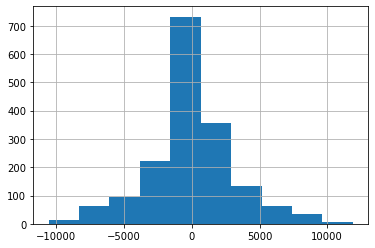

In [145]:
blasto_target.diff().hist()

In [146]:
y_train_blasto

id
D2016.09.23_S1395_I149_2        -946.283497
D2016.09.23_S1395_I149_3        -996.571049
D2016.09.23_S1395_I149_4        -872.703030
D2016.09.23_S1395_I149_5         505.539114
D2016.09.26_S1397_I149_1        1425.756284
                                   ...     
D2017.11.20_S01664_I0149_D_2    7237.519883
D2018.03.07_S01737_I0149_D_9    4330.737762
D2017.02.01_S1487_I149_5         258.336247
D2016.10.28_S1424_I149_4         374.196387
D2017.11.01_S01643_I0149_D_2    8466.610723
Length: 1381, dtype: float64

In [147]:
predictions_per_task = {}
feats_per_task = {}
for morpho_task in morpho_task_keys:
    print(morpho_task)
    clf = RandomForestClassifier(n_jobs=-1)
    
    X = extracted_feats_per_task[morpho_task].fillna(0)
    train_ids_lst = list(train_ids)
    shuffle(train_ids_lst)
    
    X_train, X_test = X.loc[train_ids_lst],  X.loc[test_ids]
    y_train =  y_area_target.loc[train_ids_lst]#.fillna('Bad')!='Bad'
    feats = train_classifier(clf, X_train, y_train)
    feats_per_task[morpho_task] = feats
    
    clf.fit(X_train.iloc[:,feats], y_train)
    
    predictions_per_task[morpho_task] = clf.predict_proba(X_test.iloc[:,feats])[:,1]
        


X_train, X_test = extracted_features_blasto.loc[train_ids_lst],  extracted_features_blasto.loc[test_ids]
y_train_blasto = blasto_target.loc[train_ids]
regr = RandomForestRegressor(n_jobs=-1)
regr.fit(X_train, y_train_blasto)

predictions_per_task["blasto_stage"] = regr.predict(X_test)

36_hours_morpho


5it [00:07,  1.50s/it]


AUC: 0.5748039763667067 +-0.022034946647839282
48_hours_morpho


5it [00:08,  1.73s/it]


AUC: 0.5867060517456427 +-0.03890801622227211
60_hours_morpho


5it [00:09,  1.88s/it]


AUC: 0.5920066446699778 +-0.022605299558308985
72_hours_morpho


5it [00:10,  2.15s/it]


AUC: 0.6721073010356164 +-0.03789909237783577


In [148]:
y_train.sum()

374

In [87]:
all_predictions = pd.DataFrame(predictions_per_task)

NameError: name 'predictions_per_task' is not defined

In [926]:
all_predictions.index = test_ids

In [927]:
final_result_df.index = final_result_df.id

In [85]:
all_predictions['blasto_stage']


NameError: name 'all_predictions' is not defined

In [929]:
from sklearn.metrics import f1_score, classification_report
threshs = np.linspace(0,.999,1000)
for task in all_predictions.columns:
    f1s = []
    for thresh in threshs:
        f1s.append(f1_score(y_grade_test!='72_hours_morpho', all_predictions[task]>thresh))
    
    best_thresh = threshs[np.argmax(f1s)]
    print(confusion_matrix(y_grade_test!='Bad', all_predictions[task]>best_thresh))
    print(max(f1s))


[[  0  59]
 [  0 269]]
1.0
[[  0  59]
 [  0 269]]
1.0
[[  0  59]
 [  0 269]]
1.0
[[  0  59]
 [  0 269]]
1.0
[[  0  59]
 [  0 269]]
1.0


In [930]:
mean_preds = all_predictions[morpho_task_keys].mean(axis=1)

(array([ 2., 11., 11., 13., 21., 38., 32., 50., 66., 84.]),
 array([0.4   , 0.4575, 0.515 , 0.5725, 0.63  , 0.6875, 0.745 , 0.8025,
        0.86  , 0.9175, 0.975 ]),
 <a list of 10 Patch objects>)

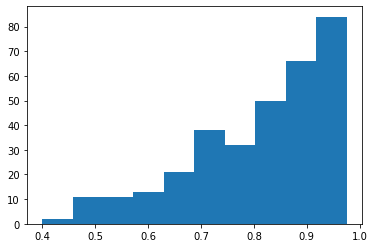

In [931]:
plt.hist(mean_preds)

In [932]:
roc_auc_score(y_grade_test!='Bad',mean_preds)

0.8386050028353601

In [933]:
f1s = []
threshs = np.linspace(0,.7,500)
for thresh in threshs:
    f1s.append(f1_score(y_grade_test!='Bad', mean_preds>thresh))

best_thresh = threshs[np.argmax(f1s)]
print(confusion_matrix(y_grade_test!='Bad', mean_preds>best_thresh))

[[ 22  37]
 [  9 260]]


In [934]:
best_thresh

0.5961923847695391

In [935]:
print(confusion_matrix(y_grade_test!='Bad', mean_preds>.7))

[[ 30  29]
 [ 35 234]]


In [941]:
final_result_df

,Fetal Heart Beat,id
id,,
D2016.10.12_S1410_I149_4,1,D2016.10.12_S1410_I149_4
D2016.10.12_S1410_I149_5,0,D2016.10.12_S1410_I149_5
D2016.10.12_S1410_I149_8,1,D2016.10.12_S1410_I149_8
D2016.10.18_S1418_I149_1,1,D2016.10.18_S1418_I149_1
D2016.10.18_S1418_I149_6,1,D2016.10.18_S1418_I149_6
...,...,...
D2019.04.22_S01986_I0149_D_10,0,D2019.04.22_S01986_I0149_D_10
D2019.05.18_S01999_I0149_D_3,0,D2019.05.18_S01999_I0149_D_3
D2019.05.22_S02001_I0149_D_1,0,D2019.05.22_S02001_I0149_D_1


KeyError: 'Passing list-likes to .loc or [] with any missing labels is no longer supported, see https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#deprecate-loc-reindex-listlike'

In [942]:
fetal_heart =  final_result_df.loc[all_predictions.index]['Fetal Heart Beat']

KeyError: 'Passing list-likes to .loc or [] with any missing labels is no longer supported, see https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#deprecate-loc-reindex-listlike'

In [937]:
pred_good = fetal_heart.loc[mean_preds>.7].dropna()
pred_bad = fetal_heart.loc[mean_preds<.7].dropna()

In [940]:
pred_good

id
D2016.10.12_S1410_I149_4               1
D2016.10.12_S1410_I149_5               0
D2016.10.18_S1418_I149_1               1
D2016.10.18_S1418_I149_6               1
D2016.10.18_S1419_I149_3               0
                                  ...   
D2019.02.23_S01958_I0149_D_2           0
D2019.02.23_S01962_I0149_D_1     Unknown
D2019.02.28_S01965_I0149_D_1           1
D2019.04.22_S01986_I0149_D_10          0
D2019.05.29_S02006_I0149_D_2           0
Name: Fetal Heart Beat, Length: 241, dtype: object

In [939]:
104+79

183

In [892]:
104/183

0.5683060109289617

In [885]:
(pred_bad>0).value_counts()

False    23
True     12
Name: Fetal Heart Beat, dtype: int64

In [888]:
23/35

0.6571428571428571

In [620]:
final_result_df_clean = y_grade_test#with_grades.loc[all_predictions.index]['Fetal Heart Beat'].dropna()

In [621]:
final_result_df_clean = final_result_df_clean.replace(2,1)
final_result_df_clean = final_result_df_clean.replace(3,1)

In [622]:
X_final, y_final = all_predictions.loc[final_result_df_clean.index], final_result_df_clean

In [629]:
y_final = y_grade.loc[y_final.index]#!='Bad'

In [630]:
X_train_final, X_test_final, y_train_final, y_test_final = train_test_split(X_final, y_final)

In [631]:
from sklearn.linear_model import LogisticRegression, BayesianRidge, SGDClassifier, Perceptron

In [632]:
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.svm import SVC

In [633]:
clf = RandomForestClassifier()

scaler = StandardScaler()

clf.fit(X_train_final, y_train_final)
probas_final = clf.predict_proba(X_test_final)

In [634]:
probas_final

array([[0.1 , 0.32, 0.58],
       [0.07, 0.26, 0.67],
       [0.05, 0.21, 0.74],
       [0.11, 0.09, 0.8 ],
       [0.02, 0.57, 0.41],
       [0.73, 0.  , 0.27],
       [0.66, 0.01, 0.33],
       [0.01, 0.51, 0.48],
       [0.36, 0.01, 0.63],
       [0.21, 0.39, 0.4 ],
       [0.28, 0.02, 0.7 ],
       [0.16, 0.14, 0.7 ],
       [0.1 , 0.1 , 0.8 ],
       [0.05, 0.43, 0.52],
       [0.81, 0.  , 0.19],
       [0.03, 0.3 , 0.67],
       [0.11, 0.36, 0.53],
       [0.06, 0.23, 0.71],
       [0.98, 0.  , 0.02],
       [0.18, 0.02, 0.8 ],
       [0.08, 0.51, 0.41],
       [0.  , 0.65, 0.35],
       [0.47, 0.  , 0.53],
       [0.04, 0.55, 0.41],
       [0.26, 0.27, 0.47],
       [0.18, 0.03, 0.79],
       [0.25, 0.07, 0.68],
       [0.02, 0.27, 0.71],
       [0.08, 0.11, 0.81],
       [0.04, 0.43, 0.53],
       [0.3 , 0.03, 0.67],
       [0.88, 0.12, 0.  ],
       [0.03, 0.54, 0.43],
       [0.05, 0.37, 0.58],
       [0.1 , 0.62, 0.28],
       [0.46, 0.12, 0.42],
       [0.04, 0.2 , 0.76],
 

In [635]:
decisions = with_grades.loc[y_grade_test.index]['Decision']

In [608]:
decisions = decisions.loc[decisions!='Not decided']
decisions = decisions.loc[decisions!='Freeze']

In [636]:
X_final['36_hours_morpho']

id
D2016.10.12_S1410_I149_4        0.55
D2016.10.12_S1410_I149_8        0.37
D2016.10.18_S1418_I149_1        0.26
D2016.10.18_S1419_I149_3        0.40
D2016.10.18_S1419_I149_7        0.49
                                ... 
D2016.10.06_S1406_I149_2        0.04
D2016.11.28_S1440_I149_3        0.05
D2016.11.26_S1439_I149_4        0.27
D2019.01.09_S01929_I0149_D_8    0.06
D2018.05.08_S01792_I0149_D_1    0.05
Name: 36_hours_morpho, Length: 264, dtype: float64

In [590]:
from
accuracy_score(y_grade_test!='Bad', X_final['36_hours_morpho'])

0.7944317315026697

In [591]:
roc_auc_score(y_grade_test!='Bad', X_final['48_hours_morpho'])

0.804305449614374

In [592]:
roc_auc_score(y_grade_test!='Bad', X_final['60_hours_morpho'])

0.8173150266971777

In [593]:
roc_auc_score(y_grade_test!='Bad', X_final['72_hours_morpho'])

0.8055343673192643

In [611]:
roc_auc_score(y_grade_test!='Bad', X_final['48_hours_morpho'])

0.804305449614374

In [513]:
preds = clf.predict_proba(X_test.values[:,final_feats])

NameError: name 'final_feats' is not defined

In [1016]:
print(roc_auc_score(y_test, preds[:,1]))

0.8333333333333333


In [993]:
[c.split('_')[-1] for c in X_test.iloc[:,final_feats].columns]

['(0, 12)',
 '(12, 24)',
 '(24, 36)',
 '(24, 36)',
 '(12, 24)',
 '(24, 36)',
 '(12, 24)',
 '(24, 36)',
 '(24, 36)',
 '(24, 36)',
 '(24, 36)',
 '(12, 24)',
 '(24, 36)',
 '(24, 36)',
 '(12, 24)',
 '(12, 24)',
 '(0, 12)',
 '(12, 24)',
 '(24, 36)',
 '(12, 24)',
 '(24, 36)',
 '(0, 12)',
 '(12, 24)',
 '(0, 12)',
 '(0, 12)',
 '(12, 24)',
 '(24, 36)',
 '(0, 12)',
 '(24, 36)',
 '(24, 36)',
 '(24, 36)',
 '(24, 36)',
 '(24, 36)',
 '(12, 24)',
 '(0, 12)',
 '(0, 12)',
 '(12, 24)',
 '(12, 24)',
 '(12, 24)',
 '(0, 12)',
 '(24, 36)',
 '(24, 36)',
 '(24, 36)',
 '(24, 36)',
 '(0, 12)',
 '(24, 36)',
 '(0, 12)',
 '(24, 36)',
 '(24, 36)',
 '(24, 36)',
 '(24, 36)',
 '(24, 36)',
 '(12, 24)',
 '(24, 36)',
 '(12, 24)',
 '(24, 36)',
 '(12, 24)',
 '(12, 24)',
 '(24, 36)',
 '(24, 36)',
 '(24, 36)',
 '(0, 12)',
 '(24, 36)',
 '(0, 12)',
 '(24, 36)',
 '(24, 36)',
 '(24, 36)',
 '(12, 24)',
 '(0, 12)',
 '(24, 36)',
 '(24, 36)',
 '(24, 36)',
 '(24, 36)',
 '(0, 12)',
 '(24, 36)',
 '(24, 36)',
 '(24, 36)',
 '(24, 36)',
 

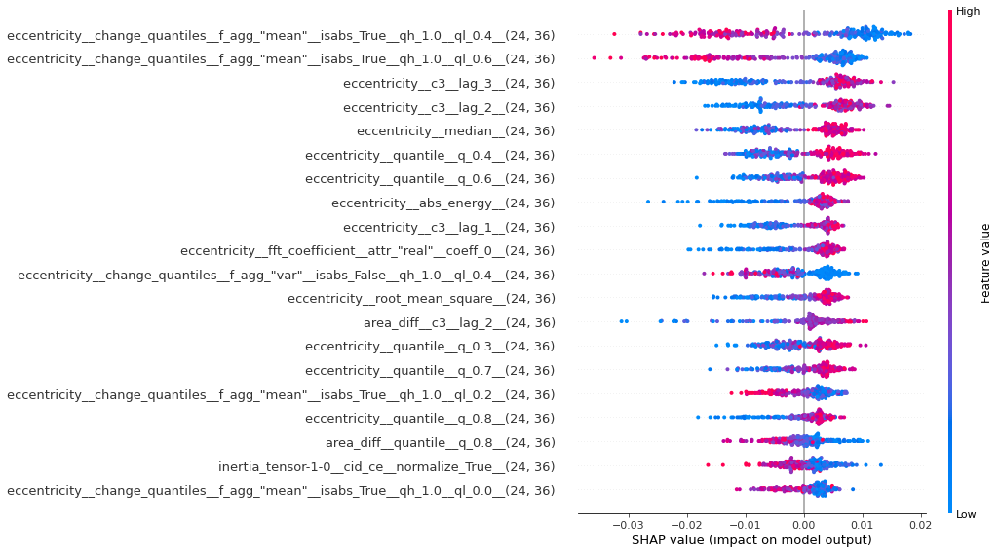

In [994]:
import shap
shap_values = shap.TreeExplainer(clf).shap_values(X_test.iloc[:,final_feats])
shap.summary_plot(shap_values[0], X_test.iloc[:,final_feats])

inertia_tensor-1-1__autocorrelation__lag_7__(0, 12)


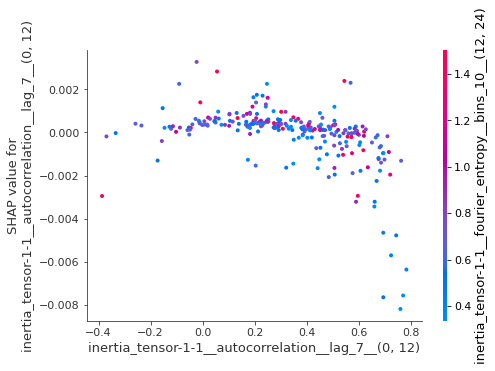

solidity__agg_linear_trend__attr_"intercept"__chunk_len_5__f_agg_"min"__(0, 12)


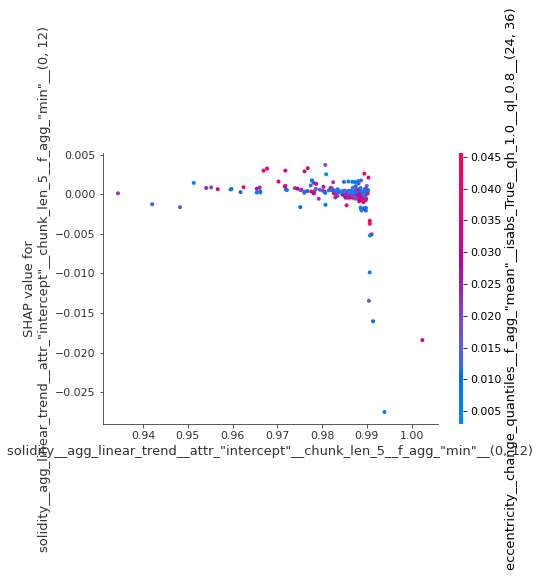

inertia_tensor-1-0__ar_coefficient__coeff_6__k_10__(24, 36)


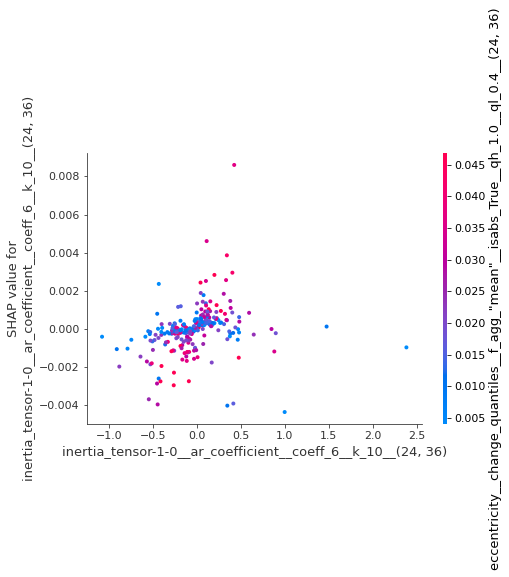

inertia_tensor-1-0__change_quantiles__f_agg_"var"__isabs_True__qh_0.6__ql_0.4__(12, 24)


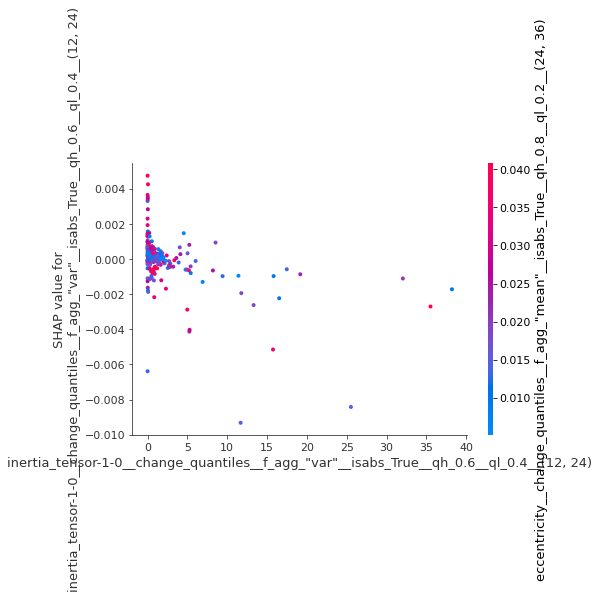

inertia_tensor-0-0__cwt_coefficients__coeff_1__w_5__widths_(2, 5, 10, 20)__(24, 36)


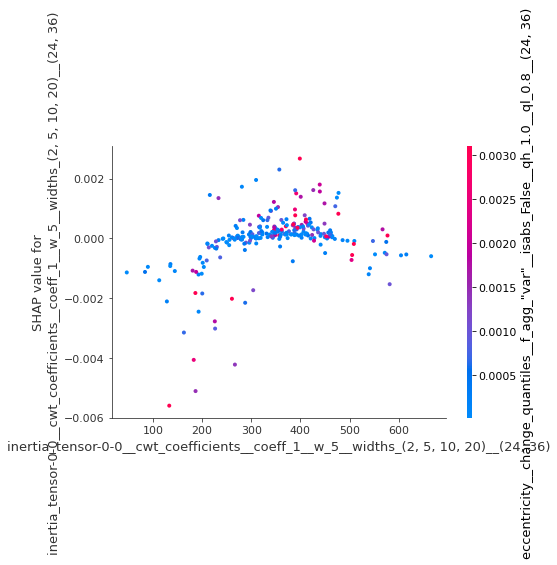

minor_axis_length__agg_linear_trend__attr_"slope"__chunk_len_5__f_agg_"min"__(12, 24)


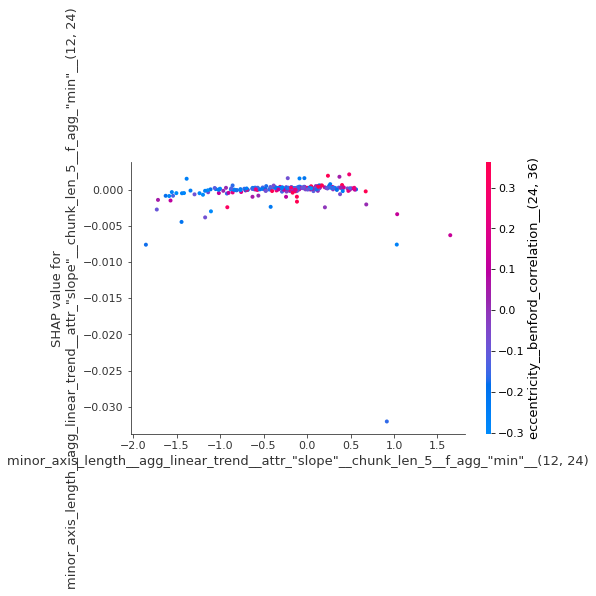

major_axis_length__change_quantiles__f_agg_"var"__isabs_True__qh_1.0__ql_0.6__(12, 24)


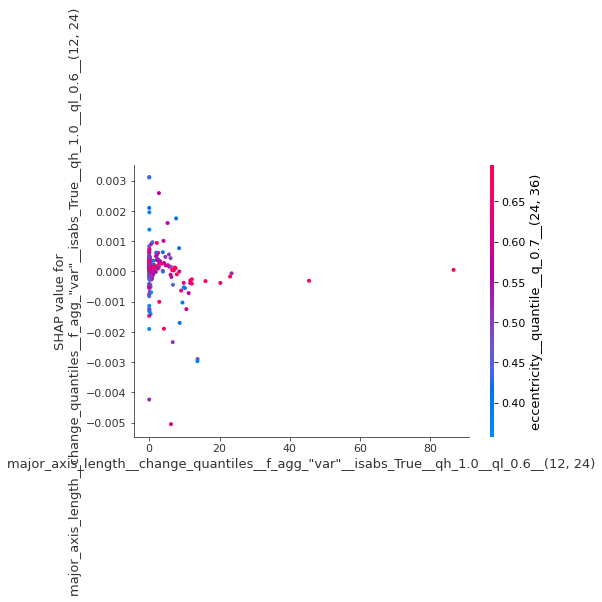

perimeter__change_quantiles__f_agg_"mean"__isabs_False__qh_1.0__ql_0.6__(24, 36)


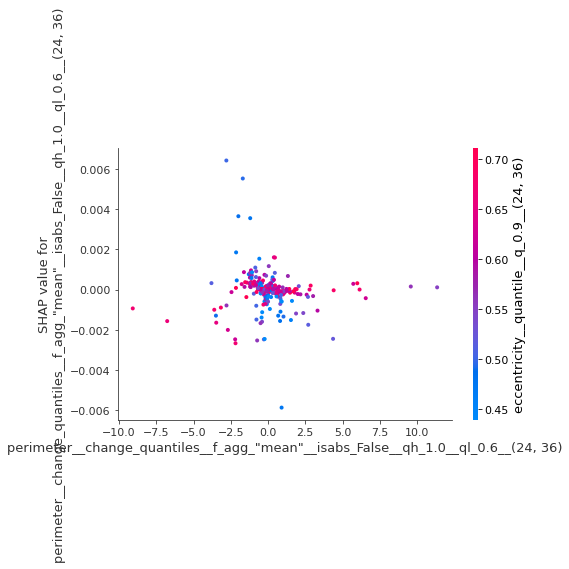

inertia_tensor-0-0__ar_coefficient__coeff_7__k_10__(24, 36)


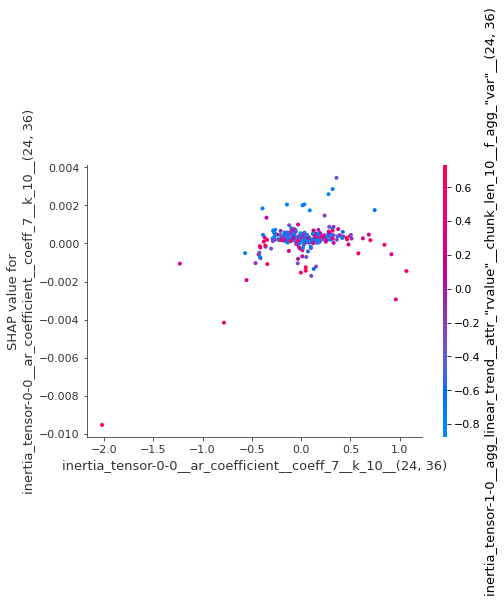

eccentricity__index_mass_quantile__q_0.4__(24, 36)


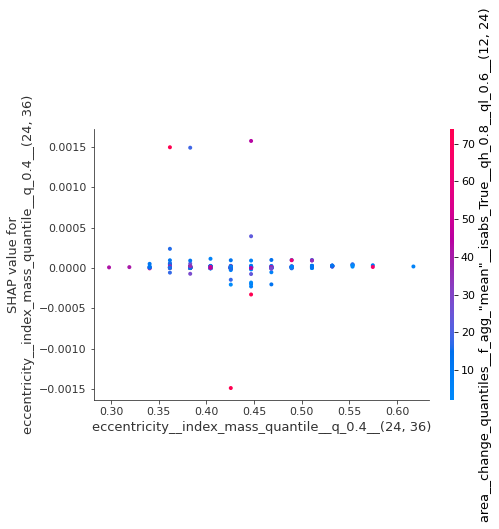

area__fft_coefficient__attr_"abs"__coeff_18__(12, 24)


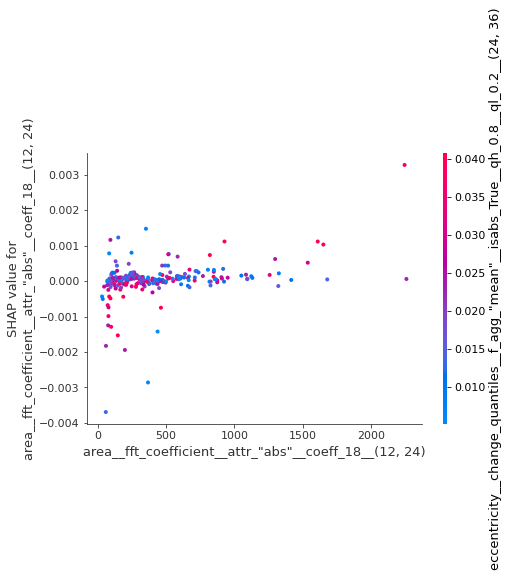

inertia_tensor-1-0__change_quantiles__f_agg_"mean"__isabs_False__qh_1.0__ql_0.0__(24, 36)


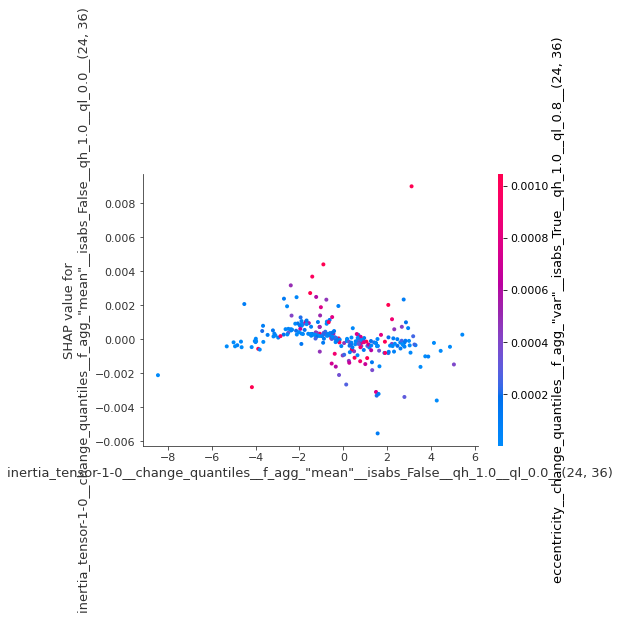

major_axis_length__cwt_coefficients__coeff_8__w_20__widths_(2, 5, 10, 20)__(24, 36)


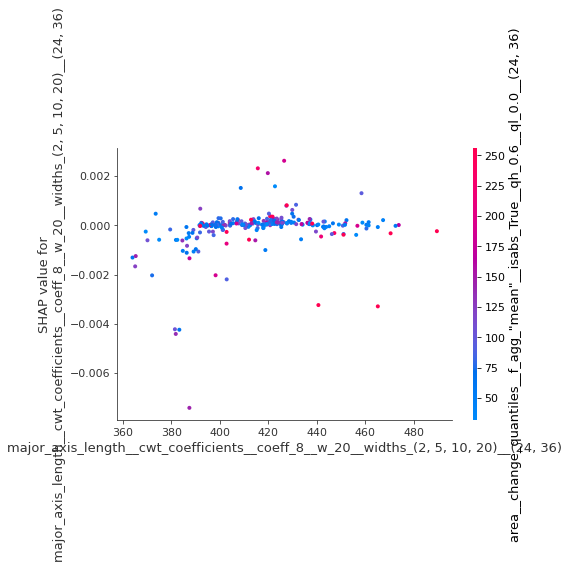

inertia_tensor-0-1__agg_linear_trend__attr_"stderr"__chunk_len_10__f_agg_"max"__(24, 36)


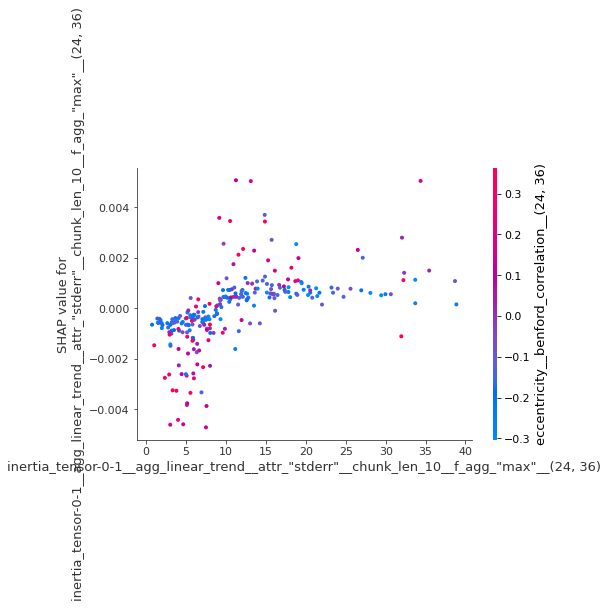

perimeter__fourier_entropy__bins_5__(24, 36)


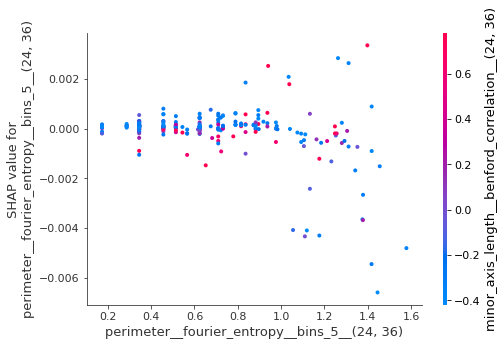

inertia_tensor-0-0__fft_coefficient__attr_"imag"__coeff_23__(24, 36)


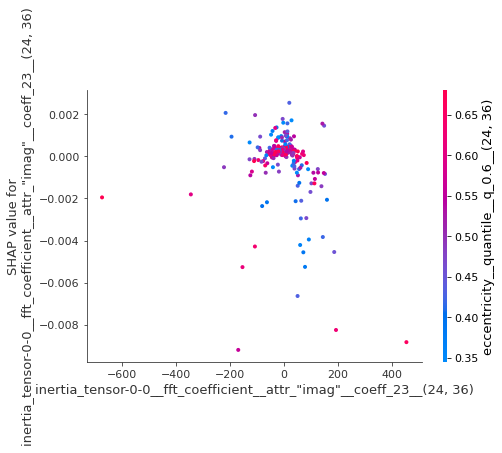

minor_axis_length__energy_ratio_by_chunks__num_segments_10__segment_focus_1__(24, 36)


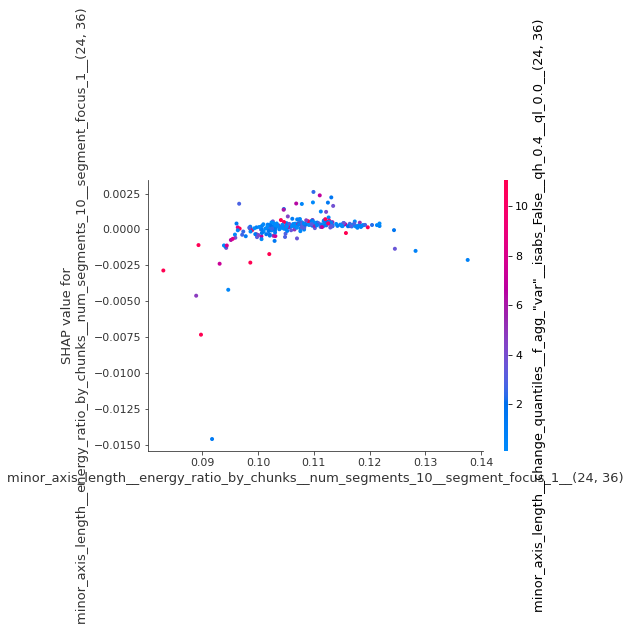

area_diff__agg_linear_trend__attr_"stderr"__chunk_len_5__f_agg_"mean"__(12, 24)


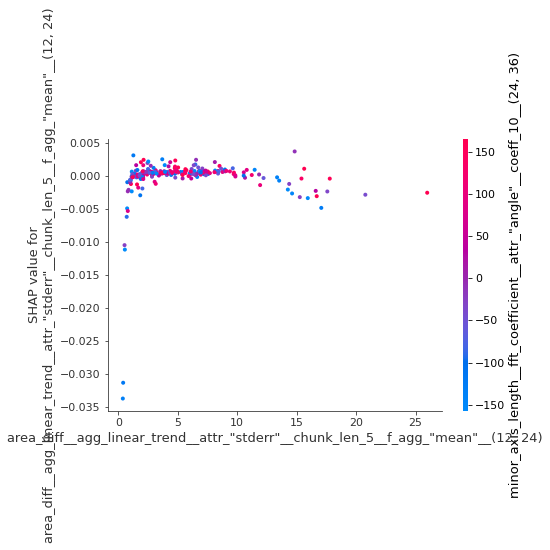

equivalent_diameter__change_quantiles__f_agg_"mean"__isabs_True__qh_0.8__ql_0.4__(24, 36)


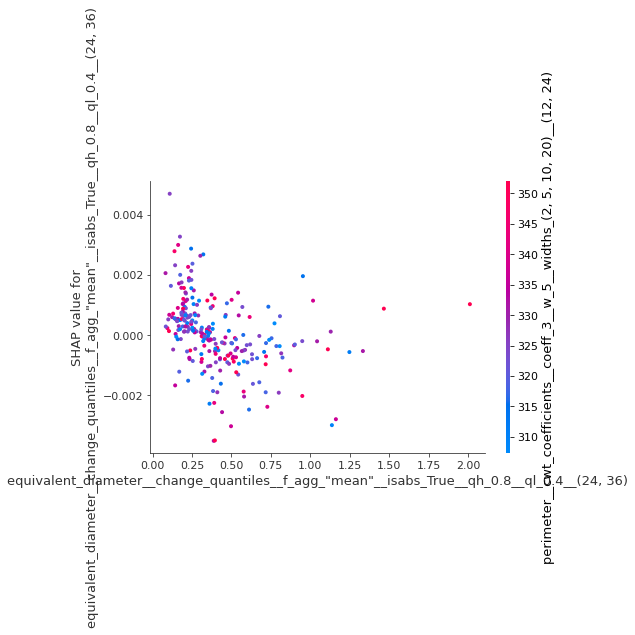

area_diff__fft_coefficient__attr_"angle"__coeff_22__(24, 36)


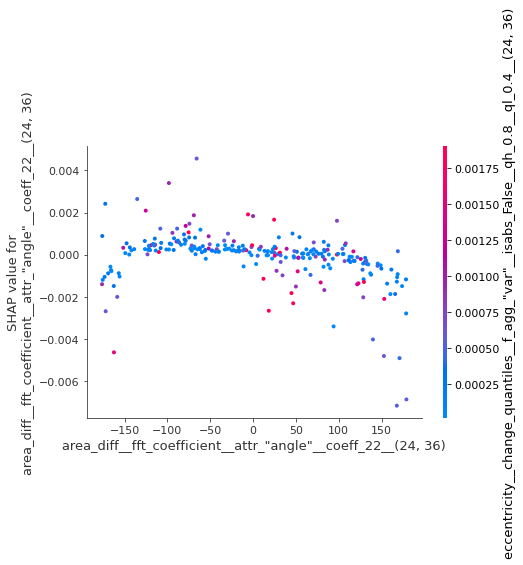

inertia_tensor-1-0__change_quantiles__f_agg_"var"__isabs_False__qh_0.8__ql_0.0__(24, 36)


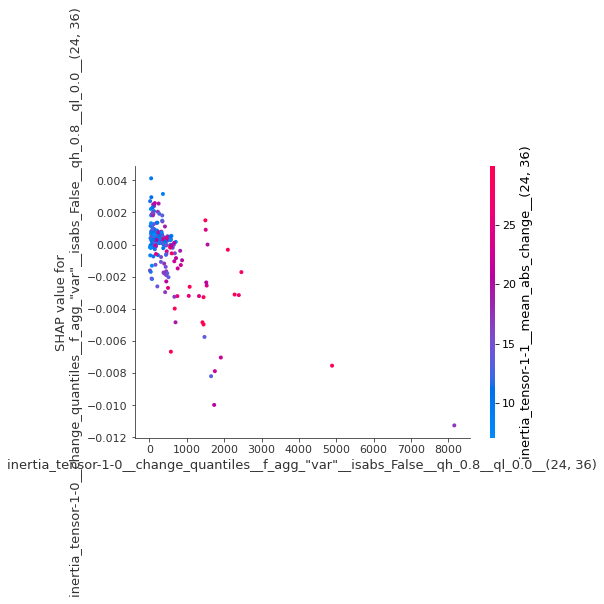

minor_axis_length__fft_coefficient__attr_"angle"__coeff_1__(24, 36)


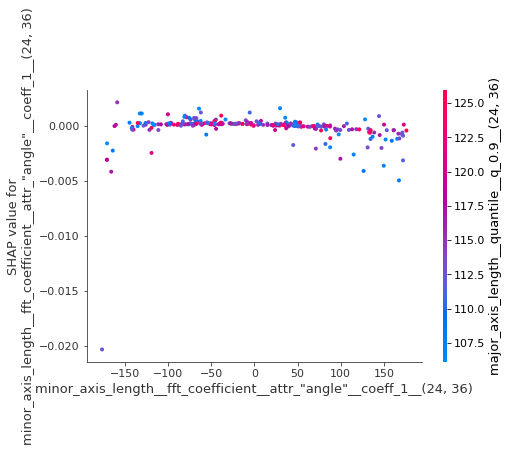

inertia_tensor-1-1__change_quantiles__f_agg_"var"__isabs_True__qh_0.6__ql_0.4__(24, 36)


KeyboardInterrupt: 

In [968]:
for c in X_test.iloc[:,final_feats].columns:
    print(c)
    shap.dependence_plot(c, shap_values[0], X_test.iloc[:,final_feats])


In [1022]:
>>> import numpy as np
>>> from sklearn.linear_model import SGDClassifier
>>> from sklearn.preprocessing import StandardScaler
>>> from sklearn.pipeline import make_pipeline
>>> X = np.array([[-1, -1], [-2, -1], [1, 1], [2, 1]])
>>> Y = np.array([1, 1, 2, 2])
>>> # Always scale the input. The most convenient way is to use a pipeline.
>>> clf = SGDClassifier(max_iter=1000, tol=1e-3)
...                     
>>> clf.fit(X, Y)
print(clf.predict([[-0.8, -1]]))


[1]


In [1025]:
clf.densify()

SGDClassifier()

In [602]:
all_resampled = []
from tqdm import tqdm
for id_ in tqdm(ids):
    emb_dict = {}
    t_id = id_
    data = merged_r.loc[merged_r.id==id_]
    print('Time steps: ', data.shape[0])
    print('hours: ', 24*data.Time.max())
    for i, t in enumerate(options):

        temp = pd.DataFrame(columns=[t])
        
        temp[t] = data[t]#.rolling(5).mean()
        index = pd.date_range('00:00:00',periods=data[t].shape[0], freq='T')
        series = pd.Series(data[t].values, index=index)
        if series.shape[0] <500:
            inter = series.resample(f'{len(series)/501:.3f}T').mean()#.interpolate(method='linear')
            
            plt.plot(series.resample(f'{len(series)/501:.3f}T').interpolate(method='linear'))
            plt.plot(inter.interpolate(method='linear'))
            plt.show()
        else:
            try:
                inter = series.resample(f'{len(series)/500:.3f}T').mean()
            except:
                print(id_)
                print(series.shape)
                continue
        emb_dict[t] = inter
    all_resampled.append(emb_dict)

 50%|██████████████████████████████████████████                                          | 1/2 [00:00<00:00,  5.26it/s]

Time steps:  669
hours:  111.69297805434356
Time steps:  472
hours:  117.79249139036936


ValueError: Invalid frequency: 0.942T

In [ ]:
inter = series.resample(f'.95T').mean().interpolate(method='linear')

In [197]:
print(inter.shape)

(496,)


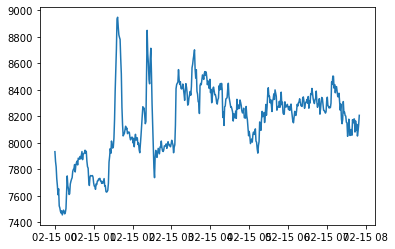

In [198]:
plt.plot(inter)

In [37]:
# merged_r = df.merge(with_grades.reset_index(drop=True), left_on='id', right_on='id')

In [122]:
merged_r

,Unnamed: 0,area,eccentricity,equivalent_diameter,inertia_tensor-0-0,inertia_tensor-0-1,inertia_tensor-1-0,inertia_tensor-1-1,major_axis_length,minor_axis_length,...,moments_normalized-3-0,moments_normalized-3-1,moments_normalized-3-2,moments_normalized-3-3,perimeter,solidity,id,t,group_grade,Diagnosis
0,0,7932,0.180185,100.495453,628.573860,-10.004083,-10.004083,634.405509,101.343774,99.685051,...,-0.000358,0.000161,0.000025,0.000022,331.220346,0.989644,D2016.01.05_S1181_I149_10,1,Medium,NaN
1,0,7803,0.236842,99.674912,622.325329,-17.902466,-17.902466,620.354356,101.135111,98.257643,...,-0.000130,0.000340,-0.000004,0.000042,327.806133,0.989475,D2016.01.05_S1181_I149_10,12,Medium,NaN
2,0,7896,0.296763,100.267140,623.140292,-28.353816,-28.353816,635.116674,102.614443,97.991773,...,-0.000087,0.000566,0.000011,0.000068,331.220346,0.988854,D2016.01.05_S1181_I149_10,23,Medium,NaN
3,0,7737,0.241269,99.252478,614.385805,-18.390996,-18.390996,617.773185,100.760970,97.784307,...,0.000141,0.000337,-0.000008,0.000044,327.806133,0.988880,D2016.01.05_S1181_I149_10,34,Medium,NaN
4,0,7814,0.312012,99.745144,624.975317,-31.809920,-31.809920,620.930018,102.358338,97.248425,...,-0.000258,0.000569,0.000042,0.000083,328.735065,0.987988,D2016.01.05_S1181_I149_10,45,Medium,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1168715,0,8139,0.246710,101.798314,633.996666,-8.546979,-8.546979,671.228500,103.776437,100.568652,...,0.000120,-0.000043,-0.000034,0.000025,352.433550,0.963081,D2019.05.29_S02006_I0149_D_8,467,Medium,Male factor
1168716,0,8051,0.287239,101.246489,622.240707,-13.834648,-13.834648,670.494763,103.859890,99.483118,...,0.000325,0.000023,-0.000044,0.000039,349.119841,0.965927,D2019.05.29_S02006_I0149_D_8,468,Medium,Male factor
1168717,0,8086,0.285921,101.466324,630.076176,-20.692383,-20.692383,666.703742,104.001748,99.659998,...,0.000385,0.000252,-0.000044,0.000054,350.776695,0.965839,D2019.05.29_S02006_I0149_D_8,469,Medium,Male factor
1168718,0,8137,0.271358,101.785805,633.136534,-15.944452,-15.944452,671.476759,104.095413,100.189609,...,0.000208,0.000130,-0.000052,0.000039,352.190909,0.963757,D2019.05.29_S02006_I0149_D_8,470,Medium,Male factor


In [30]:
merged_.id.nunique()

2332

In [19]:
inlcusive_ids = [i for i in list(df.id.unique()) if i in list(with_grades['id'].values)]

In [21]:
len(inlcusive_ids)

2328

In [211]:
with_grades.loc[inlcusive_ids]['group_grade']=='Best'
with_grades.loc[inlcusive_ids]['group_grade']=='Medium'
with_grades.loc[inlcusive_ids]['group_grade']=='Bad'
with_grades.loc[inlcusive_ids]['group_grade']=='Worse'

id
D2016.01.05_S1181_I149_10       False
D2016.01.05_S1181_I149_3        False
D2016.01.05_S1181_I149_5        False
D2016.01.05_S1181_I149_6        False
D2016.01.05_S1181_I149_7        False
                                ...  
D2019.05.29_S02006_I0149_D_2    False
D2019.05.29_S02006_I0149_D_4    False
D2019.05.29_S02006_I0149_D_5    False
D2019.05.29_S02006_I0149_D_7    False
D2019.05.29_S02006_I0149_D_8    False
Name: group_grade, Length: 2328, dtype: bool

In [146]:
from scipy import stats
def q1(x):
    q_low = x.quantile(0.01)
    q_hi  = x.quantile(0.99)
    print(x)
    return x.loc[(x < q_hi) & (x > q_low)]

In [151]:
all_feats = [
            'tPNf',
            't2',
            't3',
            't4',
            't5',
            't6',
            't2-tPNf',
            't3-tPNf',
            't4-tPNf',
            't5-tPNf',
            't3-t2',
            't4-t2',
            't4-t3',
            't5-t3',
            't5-t4',
            't6-t2',
            't6-t3',
            't6-t4',
            't6-t5',
        ]


In [148]:
with_grades[['t2','t6']].info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 11759 entries, 25 to 26531
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   t2      11686 non-null  float64
 1   t6      9910 non-null   float64
dtypes: float64(2)
memory usage: 595.6 KB


In [225]:
aggregated_data = pd.pivot_table(
                with_grades, 
                values=all_feats,
                index=['group_grade'],
                aggfunc=[np.mean, np.std]
              )

upper = aggregated_data.columns.get_level_values(0)
lower = aggregated_data.columns.get_level_values(1)
aggregated_data.columns = [f"{j}_{i}" for i, j in zip(upper,lower)]

In [226]:
aggregated_data.columns = [f"{j}_{i}" for i, j in zip(upper,lower)]
#aggregated_data.columns = [' '.join(col).strip() for col in aggregated_data.columns.values]

In [227]:
 aggregated_data.reset_index().to_csv('aggregated_grades.csv')

In [228]:
import json

In [295]:
import json
with open('aggregated_grades.json', 'w') as f:
    json.dump(aggregated_data.to_json(), f)

In [285]:
json.parse(aggregated_data.to_json())

AttributeError: module 'json' has no attribute 'parse'

In [286]:
%%time
j = pd.read_csv('aggregated_grades.csv')
print(j.loc[j['group_grade']=='Bad','t2_mean'])

0    29.418062
Name: t2_mean, dtype: float64
Wall time: 6.97 ms


In [291]:
def load_json():
    with open('aggregated_grades.json', 'rb') as f:
        j = json.loads(json.load(f))
        t = j['t2_mean']['Bad']

def load_csv():
    j = pd.read_csv('aggregated_grades.csv')
    t = j.loc[j['group_grade']=='Bad','t2_mean']

In [292]:
%timeit load_json()

236 µs ± 4.55 µs per loop (mean ± std. dev. of 7 runs, 1000 loops each)


In [293]:
%timeit load_csv()

3.73 ms ± 54.7 µs per loop (mean ± std. dev. of 7 runs, 100 loops each)


In [62]:
columns = ['id', 'tPNf', 't2', 't3', 't4', 't5', 't6', 'Dynamic Score - Time',
          'Dynamic Score - Value' ,
           'Morphological Grade - Time', 
           'Grade at approx. 65h - Zoe',
          'Day3 Grade', 'Day3 Cells', 
           'Fragmentation - Time 1',
        'Fragmentation - Value 1',
           'Multi Nucleation - Time 1',
        'Multi Nucleation - Value 1',
          'Blastomere Size - Time 1',
        'Blastomere Size - Value 1',
           'Pronuclei - Time 1',
          'Pronuclei - Value 1']

In [63]:
df.drop_duplicates('id', keep='first')

,Unnamed: 0,area,eccentricity,equivalent_diameter,inertia_tensor-0-0,inertia_tensor-0-1,inertia_tensor-1-0,inertia_tensor-1-1,major_axis_length,minor_axis_length,...,moments_normalized-2-2,moments_normalized-2-3,moments_normalized-3-0,moments_normalized-3-1,moments_normalized-3-2,moments_normalized-3-3,perimeter,solidity,id,t
0,0,7932,0.180185,100.495453,628.573860,-10.004083,-10.004083,634.405509,101.343774,99.685051,...,0.004253,-0.000026,-0.000358,0.000161,0.000025,0.000022,331.220346,0.989644,D2016.01.05_S1181_I149_10,1
669,0,8223,0.377047,102.322279,703.766674,18.678980,18.678980,610.400956,106.385334,98.533460,...,0.004218,0.000047,0.000089,-0.000398,-0.000027,-0.000040,337.705627,0.988579,D2016.01.05_S1181_I149_3,0
1338,0,8315,0.224020,102.893084,656.745024,16.169247,16.169247,667.513330,104.243660,101.594257,...,0.004233,0.000029,-0.000221,-0.000252,0.000018,-0.000037,338.877200,0.989763,D2016.01.05_S1181_I149_5,0
2007,0,8453,0.269989,103.743404,675.076172,-25.467340,-25.467340,672.813487,105.787507,101.858912,...,0.004254,0.000036,-0.000506,0.000561,0.000047,0.000059,344.291414,0.986463,D2016.01.05_S1181_I149_6,0
2676,0,8305,0.129375,102.831194,661.205610,5.580470,5.580470,661.279821,103.291689,102.423601,...,0.004256,0.000044,-0.000379,-0.000129,0.000021,-0.000013,338.877200,0.989279,D2016.01.05_S1181_I149_7,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1166360,0,7782,0.212748,99.540696,633.396352,3.583485,3.583485,605.616661,100.705604,98.400150,...,0.004221,-0.000011,0.000178,-0.000077,-0.000022,-0.000011,327.220346,0.990454,D2019.05.29_S02006_I0149_D_2,0
1166832,0,8206,0.201091,102.216455,642.047700,7.522344,7.522344,664.419838,103.283214,101.173407,...,0.004231,-0.000011,-0.000222,-0.000153,0.000021,-0.000016,335.462987,0.990584,D2019.05.29_S02006_I0149_D_4,0
1167304,0,8503,0.150955,104.049776,671.373232,-5.429832,-5.429832,682.578709,104.673063,103.473576,...,0.004234,0.000004,-0.000514,0.000073,0.000034,0.000011,342.877200,0.990102,D2019.05.29_S02006_I0149_D_5,0
1167776,0,8298,0.180518,102.787848,671.494401,-0.411655,-0.411655,649.627856,103.653434,101.950585,...,0.004239,0.000004,-0.000261,-0.000042,0.000019,0.000001,337.220346,0.991635,D2019.05.29_S02006_I0149_D_7,0


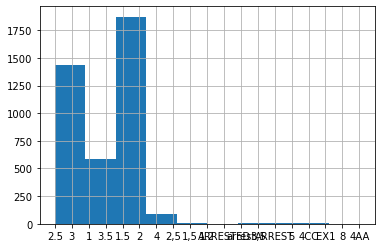

In [64]:
target['Morphological Grade - Value'].hist()

In [65]:
graded_embryoscope = pd.merge(target, zoe[columns].drop_duplicates('id', keep='first'), on='id', how='left')

In [66]:
whole = pd.merge(df.drop_duplicates('id', keep='first'), graded_embryoscope, on='id', how='left')

In [67]:
#target = testing.groupby('id').apply(lambda x: x['Morphological Grade - Value'].iloc[0])

In [68]:
extra_feats_cols = ['id', 'Morphological Grade - Value', 'tPNf', 't2', 't3', 't4', 't5', 't6',
       'Dynamic Score - Time', 
       'Morphological Grade - Time', 
      'Fragmentation - Time 1',
       'Fragmentation - Value 1', 'Multi Nucleation - Time 1',
       'Multi Nucleation - Value 1', 'Blastomere Size - Time 1',
       'Blastomere Size - Value 1', 'Pronuclei - Time 1',
       'Pronuclei - Value 1']

In [69]:
extra_feats = whole[extra_feats_cols].fillna(value=whole[extra_feats_cols].mean())

In [70]:
extra_feats['diff_65'] = extra_feats['t6'] - extra_feats['t5']
extra_feats['diff_64'] = extra_feats['t6'] - extra_feats['t4']
extra_feats['diff_63'] = extra_feats['t6'] - extra_feats['t3']
extra_feats['diff_62'] = extra_feats['t6'] - extra_feats['t2']
extra_feats['diff_61'] = extra_feats['t6'] - extra_feats['tPNf']

extra_feats['diff_54'] = extra_feats['t5'] - extra_feats['t4']
extra_feats['diff_53'] = extra_feats['t5'] - extra_feats['t3']
extra_feats['diff_52'] = extra_feats['t5'] - extra_feats['t2']
extra_feats['diff_51'] = extra_feats['t5'] - extra_feats['tPNf']


extra_feats['diff_43'] = extra_feats['t4'] - extra_feats['t3']
extra_feats['diff_42'] = extra_feats['t4'] - extra_feats['t2']
extra_feats['diff_41'] = extra_feats['t4'] - extra_feats['tPNf']

extra_feats['diff_32'] = extra_feats['t3'] - extra_feats['t2']
extra_feats['diff_31'] = extra_feats['t3'] - extra_feats['tPNf']

extra_feats['diff_21'] = extra_feats['t2'] - extra_feats['tPNf']


In [71]:
#df_pixel = pd.read_csv('pixel_features.csv')

In [23]:
#df_pixel.shape

In [24]:
#df = pd.merge(df, df_pixel,'inner', on=['id','t'])

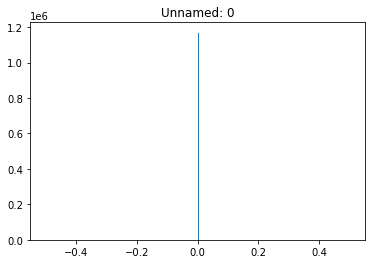

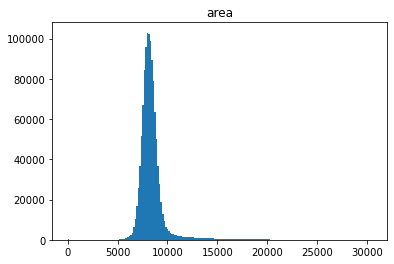

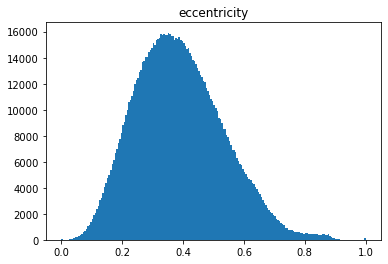

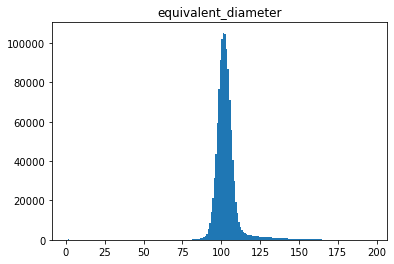

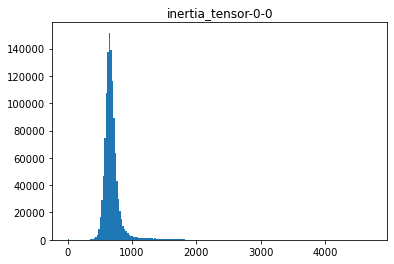

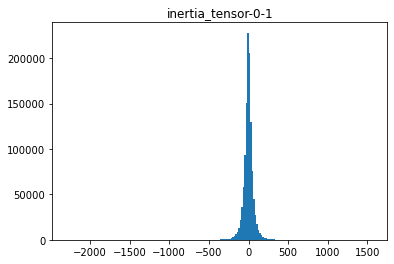

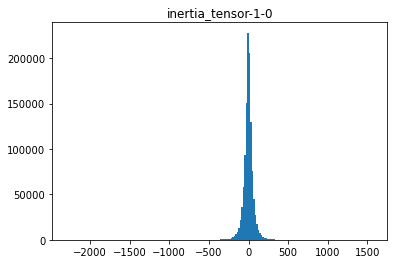

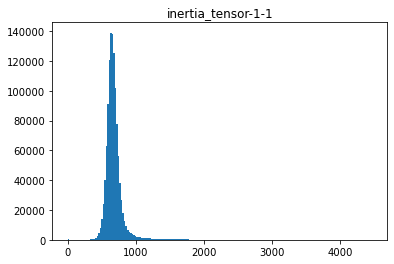

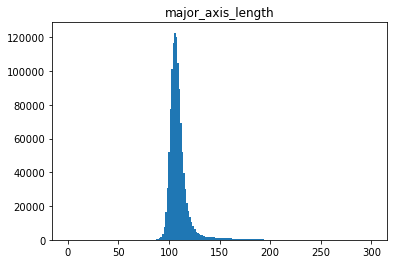

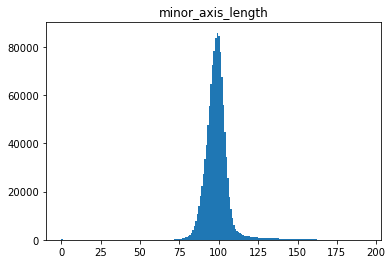

C:\Users\hp\anaconda3\lib\site-packages\matplotlib\axes\_axes.py:6630: RuntimeWarning: All-NaN slice encountered
  xmin = min(xmin, np.nanmin(xi))
C:\Users\hp\anaconda3\lib\site-packages\matplotlib\axes\_axes.py:6631: RuntimeWarning: All-NaN slice encountered
  xmax = max(xmax, np.nanmax(xi))


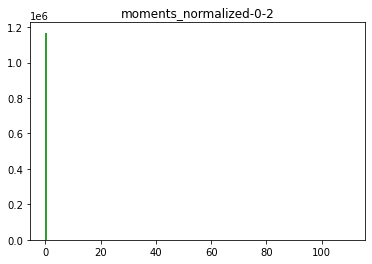

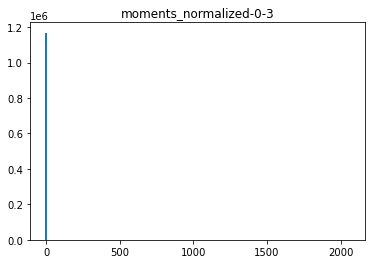

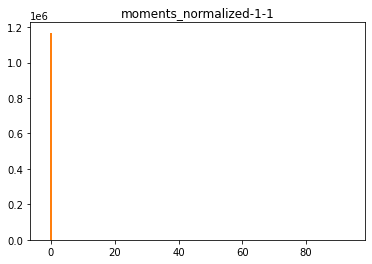

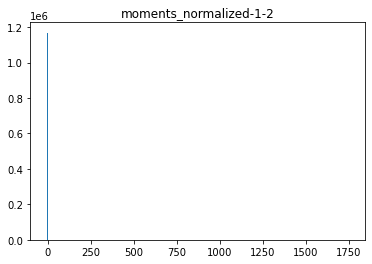

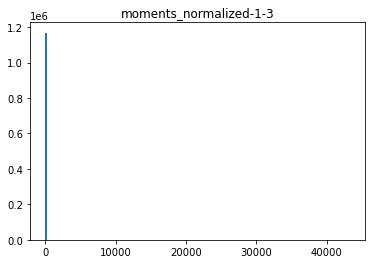

...

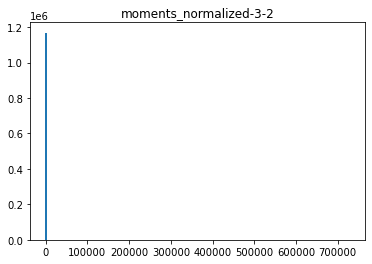

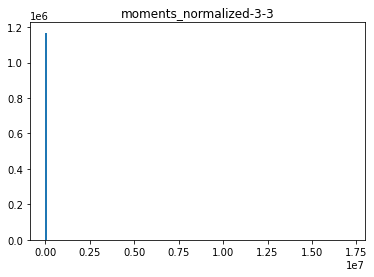

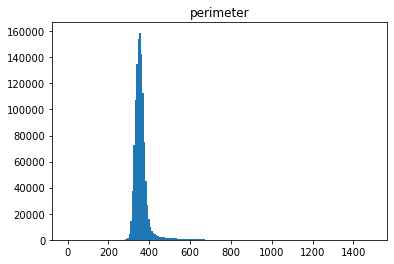

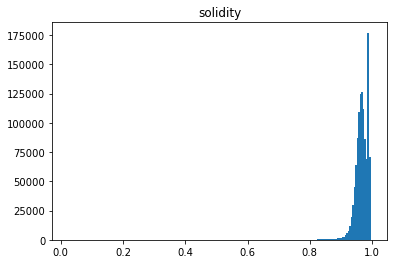

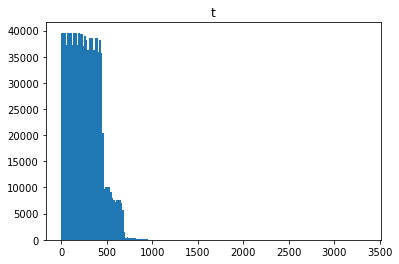

In [25]:
%matplotlib inline
for col in df.columns:
    try:
        plt.hist(df[col], bins=200)
        plt.title(col)
        plt.show()
    except:
        pass

In [72]:
timesteps = pd.read_csv('../files/grade_timesteps.csv')

In [73]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1168720 entries, 0 to 1168719
Data columns (total 30 columns):
 #   Column                  Non-Null Count    Dtype  
---  ------                  --------------    -----  
 0   Unnamed: 0              1168720 non-null  int64  
 1   area                    1168720 non-null  int64  
 2   eccentricity            1168720 non-null  float64
 3   equivalent_diameter     1168720 non-null  float64
 4   inertia_tensor-0-0      1168720 non-null  float64
 5   inertia_tensor-0-1      1168720 non-null  float64
 6   inertia_tensor-1-0      1168720 non-null  float64
 7   inertia_tensor-1-1      1168720 non-null  float64
 8   major_axis_length       1168720 non-null  float64
 9   minor_axis_length       1168720 non-null  float64
 10  moments_normalized-0-0  0 non-null        float64
 11  moments_normalized-0-1  0 non-null        float64
 12  moments_normalized-0-2  1168720 non-null  float64
 13  moments_normalized-0-3  1168720 non-null  float64
 14  mo

In [74]:
timesteps

,id,dt
0,D2018.04.21_S01773_I0149_D_9,0.013425
1,D2018.04.21_S01773_I0149_D_9,0.024170
2,D2018.04.21_S01773_I0149_D_9,0.034594
3,D2018.04.21_S01773_I0149_D_9,0.045023
4,D2018.04.21_S01773_I0149_D_9,0.055439
...,...,...
1195354,D2016.02.08_S1220_I149_7,4.786479
1195355,D2016.02.08_S1220_I149_7,4.793438
1195356,D2016.02.08_S1220_I149_7,4.800382
1195357,D2016.02.08_S1220_I149_7,4.807327


In [75]:
target['Morphological Grade - Value'].value_counts().sum()

4000

In [76]:
import gc
gc.collect()

26778

In [77]:
dts = timesteps.groupby('id').apply(lambda x: x.dt.diff().mean())

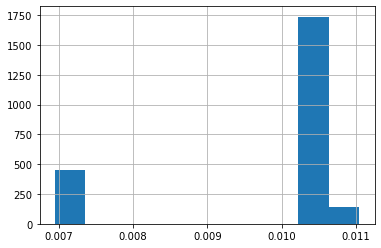

In [78]:
dts.hist()

In [79]:
timesteps.index = timesteps.id

In [80]:
time

Wall time: 0 ns


In [81]:
df = df.reset_index(drop=True)
df['DT'] = df.id.map(dts)

In [82]:
df['Time'] = df.groupby('id').DT.cumsum()

In [83]:
#test['Time'] = test.groupby('id').apply(lambda x: x['0'].cumsum()).reset_index(drop=True)

In [84]:
%matplotlib inline
df.groupby('id').apply(lambda x: x['Time'].max()).reset_index(drop=True)

0       4.660841
1       4.660659
2       4.660663
3       4.660754
4       4.660756
          ...   
2327    4.918251
2328    4.918364
2329    4.918368
2330    4.918416
2331    4.918441
Length: 2332, dtype: float64

In [85]:
import gc
gc.collect()

28

In [92]:
zoe.index = zoe.id

In [ ]:
all_feats = [
            'tPNf',
            't2',
            't3',
            't4',
            't5',
            't6',
            't2-tPNf',
            't3-tPNf',
            't4-tPNf',
            't5-tPNf',
            't3-t2',
            't4-t2',
            't4-t3',
            't5-t3',
            't5-t4',
            't6-t2',
            't6-t3',
            't6-t4',
            't6-t5',
        ]

In [94]:
find_outcomes = zoe.loc[df.id.unique()]

In [ ]:
find_outcomes['Gestational Sacs'].

In [100]:
succesful =  find_outcomes.loc[find_outcomes['Fetal Heart Beat']==1]
unsuccesful =  find_outcomes.loc[find_outcomes['Fetal Heart Beat']==0]

In [105]:
pd.concat([succesful, unsuccesful])[['Well', 'Slide ID', 'Fetal Heart Beat', 'Morphological Grade - Value']]

,Well,Slide ID,Fetal Heart Beat,Morphological Grade - Value
id,,,,
D2016.01.21_S1198_I149_10,3,D2012.05.25_S0274_I149,1,1.5
D2016.01.30_S1210_I149_4,3,D2012.05.12_S0261_I149,1,2
D2016.02.19_S1233_I149_10,1,D2012.11.21_S0381_I149,1,1.5
D2016.07.13_S1373_I149_11,8,D2012.05.25_S0274_I149,1,1.5
D2016.10.08_S1407_I149_6,3,D2012.03.24_S0224_I149,1,1.5
...,...,...,...,...
D2018.11.15_S01899_I0149_D_9,6,D2012.07.17_S0319_I149,0,1.5
D2018.12.05_S01916_I0149_D_9,7,D2012.06.07_S0286_I149,0,3
D2019.02.04_S01943_I0149_D_12,4,D2012.09.15_S0326_I149,0,2


In [419]:
find_outcomes

NameError: name 'find_outcomes' is not defined

In [106]:
zoe

,Slide ID,Patient ID,Well,Birth Year,Birth Month,BMI,Diagnosis,Basal Serum FSH,Fertilization,Age,...,Pronuclei - Value 1,Pronuclei - Time 2,Pronuclei - Value 2,Pronuclei - Time 3,Pronuclei - Value 3,Pronuclei - Time 4,Pronuclei - Value 4,Pronuclei - Time 5,Pronuclei - Value 5,id
id,,,,,,,,,,,,,,,,,,,,,
D2018.04.21_S01773_I0149_D_9,D2011.05.31_S0057_I149,478113,1,1970.0,1.0,0.0,NaN,0.0,40694.56944,41.4,...,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,D2018.04.21_S01773_I0149_D_9
D2018.09.17_S01862_I0149_D_9,D2011.05.31_S0057_I149,478113,2,1970.0,1.0,0.0,NaN,0.0,40694.56944,41.4,...,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,D2018.09.17_S01862_I0149_D_9
D2016.02.27_S1244_I149_8,D2011.05.31_S0057_I149,478113,3,1970.0,1.0,0.0,NaN,0.0,40694.56944,41.4,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,D2016.02.27_S1244_I149_8
D2016.02.27_S1244_I149_9,D2011.05.31_S0057_I149,478113,4,1970.0,1.0,0.0,NaN,0.0,40694.56944,41.4,...,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,D2016.02.27_S1244_I149_9
D2016.10.23_S1422_I149_3,D2011.05.31_S0057_I149,478113,5,1970.0,1.0,0.0,NaN,0.0,40694.56944,41.4,...,2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,D2016.10.23_S1422_I149_3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
NaN,D2020.09.18_S02297_I0149_D,512316,8,NaN,NaN,NaN,NaN,NaN,44091.57639,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
NaN,D2020.09.18_S02297_I0149_D,512316,9,NaN,NaN,NaN,NaN,NaN,44091.57639,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
NaN,D2020.09.18_S02297_I0149_D,512316,10,NaN,NaN,NaN,NaN,NaN,44091.57639,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [43]:
df['id'] = LabelEncoder().fit_transform(df['id'])

In [44]:
df = df.fillna(value=df.mean())


In [45]:
df = df.dropna(axis=1)

In [46]:
#df = df.groupby('id').apply(lambda x: x.iloc[:300]).reset_index(drop=True)

In [47]:
df.groupby('id')

In [48]:
def drop_empty(x):
    area = x.area.values
    if area.min()>3000:
        return x
    
def get_small_t(x):
    if x.Time.iloc[-1]>3:
        return x

def drop_no_fert(x):
    if x.area.values[-1]>5500:
        return x

def drop_early(x):
    if x.Time.max()>4.65:
        return x

In [49]:
test = df.groupby('id').apply(get_small_t).reset_index(drop=True)
clean = test.groupby('id').apply(drop_empty).reset_index(drop=True)
#clean = clean.groupby('id').apply(drop_no_fert).reset_index(drop=True)
clean = clean.groupby('id').apply(drop_early).reset_index(drop=True)
target_area = clean.groupby('id').apply(lambda x: x.loc[x.Time>4.65].area.iloc[0])
#target_means = clean.groupby('id').apply(lambda x: x.loc[x.Time>4.65].means.iloc[0])


area 2136741.4681425844


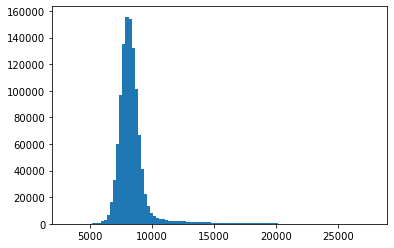

eccentricity 0.02070440588360755


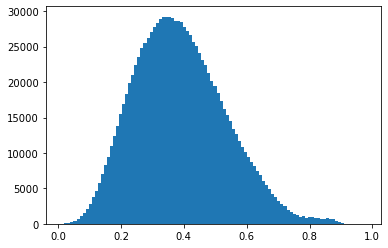

equivalent_diameter 62.71164288906904


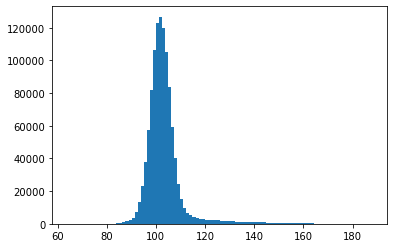

inertia_tensor-0-0 26032.022002000565


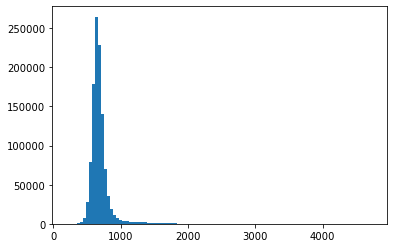

inertia_tensor-0-1 6176.19417186526


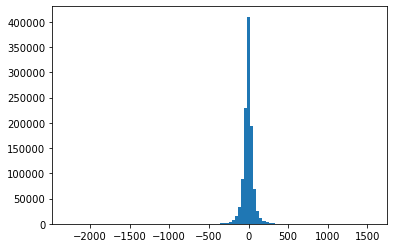

inertia_tensor-1-0 6176.19417186526


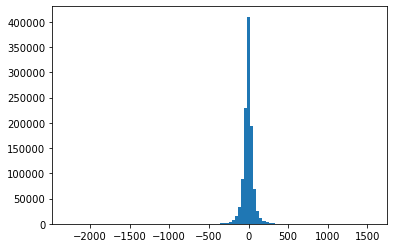

inertia_tensor-1-1 22335.29987077889


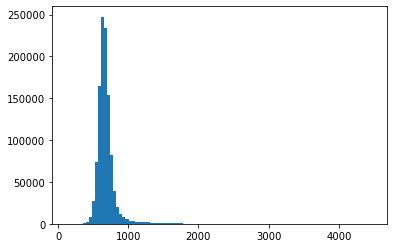

major_axis_length 131.4605304695826


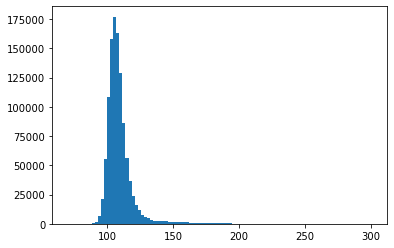

minor_axis_length 67.32522410090698


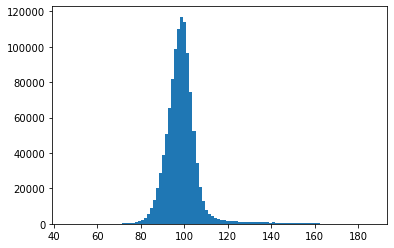

moments_normalized-0-2 7.8564857654934e-05


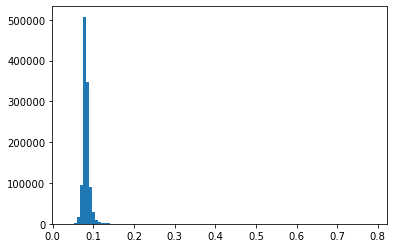

moments_normalized-0-3 4.7375512077303735e-06


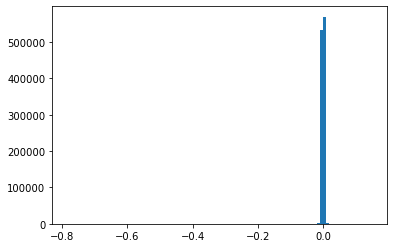

moments_normalized-1-1 6.438965126177239e-05


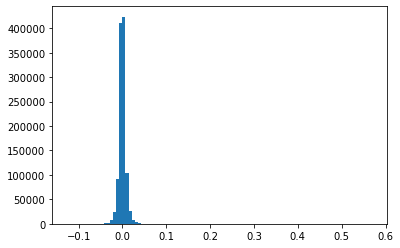

moments_normalized-1-2 2.959325248034104e-06


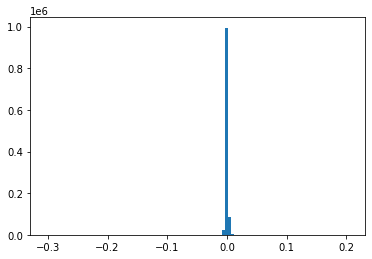

moments_normalized-1-3 3.406609070522956e-06


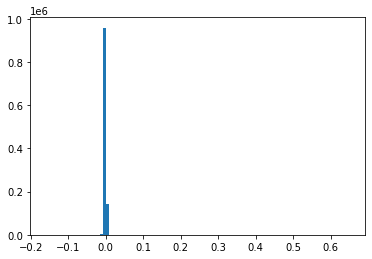

moments_normalized-2-0 7.318784479034814e-05


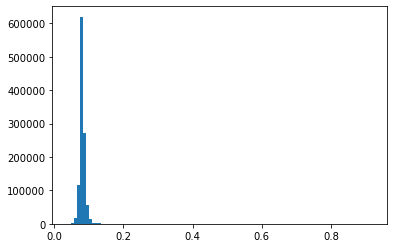

moments_normalized-2-1 2.8206204789204374e-06


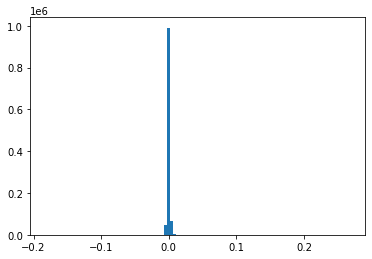

moments_normalized-2-2 1.3248164574695312e-06


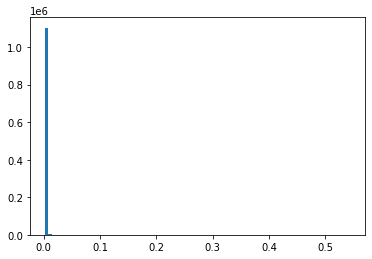

moments_normalized-2-3 6.861067285356053e-07


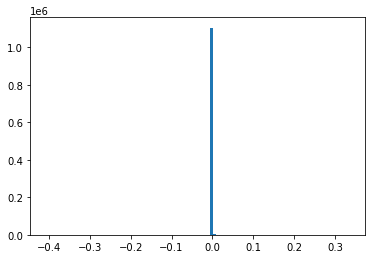

moments_normalized-3-0 3.674506415695889e-06


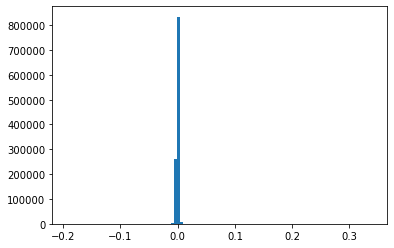

moments_normalized-3-1 3.4416664765704576e-06


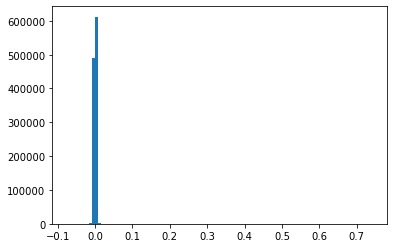

moments_normalized-3-2 6.503460966399727e-07


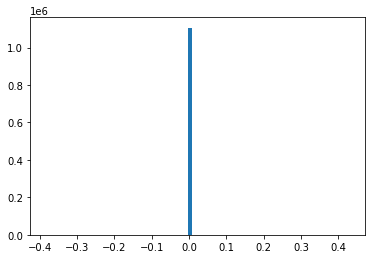

moments_normalized-3-3 9.693470516360788e-07


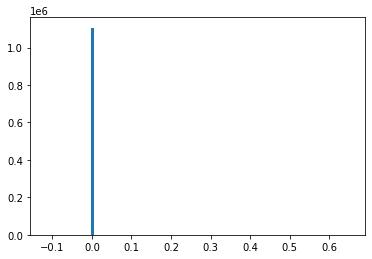

perimeter 1689.8559687637212


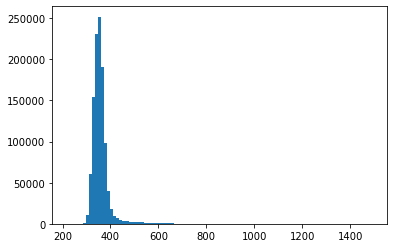

solidity 0.0004911576123530182


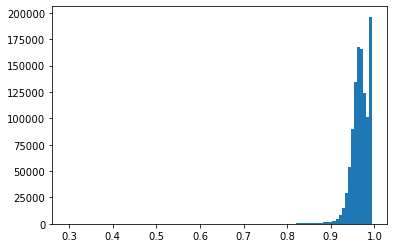

In [50]:
for c in clean.columns[1:-4]:
    print(c, clean[c].var())
    plt.hist(clean[c],bins=100)
    
    plt.show()

In [79]:
clean.columns[1:-4]

Index(['area', 'eccentricity', 'equivalent_diameter', 'inertia_tensor-0-0',
       'inertia_tensor-0-1', 'inertia_tensor-1-0', 'inertia_tensor-1-1',
       'major_axis_length', 'minor_axis_length', 'moments_normalized-0-2',
       'moments_normalized-0-3', 'moments_normalized-1-1',
       'moments_normalized-1-2', 'moments_normalized-1-3',
       'moments_normalized-2-0', 'moments_normalized-2-1',
       'moments_normalized-2-2', 'moments_normalized-2-3',
       'moments_normalized-3-0', 'moments_normalized-3-1',
       'moments_normalized-3-2', 'moments_normalized-3-3', 'perimeter',
       'solidity'],
      dtype='object')

In [51]:
features_list = ['area', 'eccentricity', 'equivalent_diameter', 'inertia_tensor-0-0',
       'inertia_tensor-0-1', 'inertia_tensor-1-0', 'inertia_tensor-1-1',
       'major_axis_length', 'minor_axis_length',  'perimeter',
       'solidity', 'Time',]

In [53]:
def resample_(x):
    period = '30min'
    new_df = pd.DataFrame()
    
    for c in x.columns:
        if c!='id':
            ts = x.loc[x['Time']<=6][c]

            ts.index = pd.DatetimeIndex(x.loc[x['Time']<=6]['Time']*8.64e+13)
            ts = ts.resample('30min').mean()
            new_df[c] = ts
        else:
            continue
    return new_df


resampled_df = clean[['id']+features_list].groupby('id').apply(resample_)

resampled_df['Time_1'] = resampled_df['Time']
del resampled_df['Time']

resampled_df = resampled_df.reset_index()
resampled_df['Time_1'] = resampled_df['Time_1']-0.01043



In [84]:
#%debug

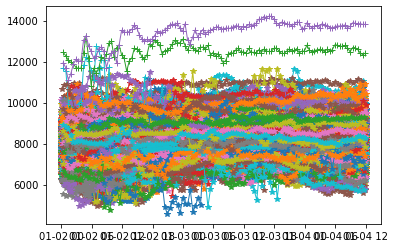

In [85]:
count = 0
%matplotlib inline
count_big = 0
count_small = 0 
for g, val in resampled_df.groupby('id'):
   # if val.area.values[-1]>5500:
    filt = (val['Time_1']<=3.5)&(val['Time_1']>=1)
    ts = val.loc[filt]['area']
    ts.index = pd.DatetimeIndex(val.loc[filt]['Time_1']*8.64e+13)
    
    if ts.max()>12000:
        
        plt.plot(ts,marker='+', linewidth=1)
        #plt.show()
        count_big+=1
    else:
        
        plt.plot(ts,marker='*', linewidth=1)
        
        count_small+=1
    
    if (count_small>10)&(count_big>10):
        continue
plt.show()

In [95]:

X_ = resampled_df.groupby('id').apply(lambda x: x.loc[x.Time_1<4]).reset_index(drop=True)


In [96]:
area_35 = X_.groupby('id').apply(lambda x: x.area.iloc[-1])

In [97]:
#resampled_df.to_csv('resampled_data_30_min.csv', index=False)

In [52]:
%matplotlib inline
for idx, g in resampled_df.groupby('id'):
    #print(g['Weeks'].shape[0])
    plt.plot(g['Time'], g['area'])

NameError: name 'resampled_df' is not defined

In [99]:
%matplotlib inline
diff.hist(bins=100)

NameError: name 'diff' is not defined

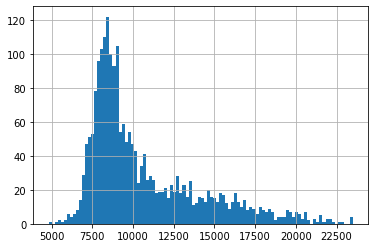

In [100]:
target_area.hist(bins=100)

In [154]:
target_area = resampled_df.groupby('id').apply(lambda x: x.loc[x.Time_1>4.5].area.mean())
diff = target_area - area_35

In [161]:
resampled_df.id.nunique()

2170

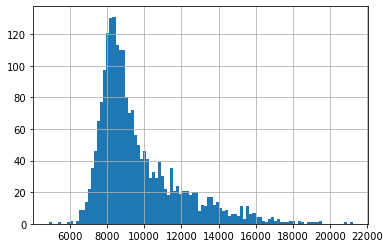

In [102]:
%matplotlib inline
target_area.hist(bins=100)

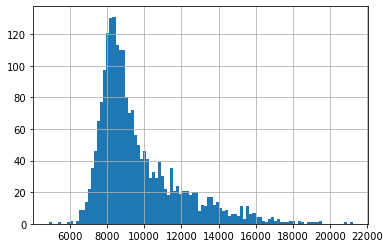

In [103]:
%matplotlib inline
target_area.hist(bins=100)

In [104]:
diff = target_area- clean.groupby('id').apply(lambda x: x.iloc[0].area)

In [107]:
X_

,id,Time,area,eccentricity,equivalent_diameter,inertia_tensor-0-0,inertia_tensor-0-1,inertia_tensor-1-0,inertia_tensor-1-1,major_axis_length,minor_axis_length,perimeter,solidity,Time_1,area_diff
0,0,1970-01-01 00:00:00,7867.500000,0.208513,100.085183,625.449594,-13.953275,-13.953275,627.379933,101.239442,98.971347,329.513239,0.989560,0.000020,0.000000
1,0,1970-01-01 00:30:00,7815.666667,0.283348,99.754921,620.833804,-26.184911,-26.184911,624.606626,101.911250,97.674835,329.253848,0.988574,0.017438,-51.833333
2,0,1970-01-01 01:00:00,7827.000000,0.300453,99.828000,625.269519,-29.494106,-29.494106,622.217182,102.241119,97.500569,328.230159,0.990090,0.038338,11.333333
3,0,1970-01-01 01:30:00,7850.333333,0.316826,99.976591,618.879123,-32.416499,-32.416499,632.713835,102.679014,97.377210,329.772631,0.988915,0.059239,23.333333
4,0,1970-01-01 02:00:00,7863.666667,0.329900,100.061159,615.069630,-34.016742,-34.016742,639.010988,103.005285,97.236790,329.577369,0.988643,0.080139,13.333333
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
417817,2331,1970-01-04 22:00:00,8283.500000,0.408424,102.697995,670.990244,-60.849522,-60.849522,667.794500,108.097944,98.667827,368.826948,0.951853,3.912860,60.500000
417818,2331,1970-01-04 22:30:00,8305.000000,0.403222,102.831191,665.888092,-59.145567,-59.145567,674.007385,108.017216,98.846354,362.190909,0.956742,3.933701,21.500000
417819,2331,1970-01-04 23:00:00,8306.500000,0.398998,102.840359,658.368699,-56.739343,-56.739343,680.588998,107.879727,98.920375,362.554870,0.955537,3.954542,1.500000
417820,2331,1970-01-04 23:30:00,8275.500000,0.409446,102.648399,661.260400,-60.762880,-60.762880,675.114698,108.026660,98.550204,363.898016,0.954451,3.975383,-31.000000


In [108]:
features_list

['area',
 'eccentricity',
 'equivalent_diameter',
 'inertia_tensor-0-0',
 'inertia_tensor-0-1',
 'inertia_tensor-1-0',
 'inertia_tensor-1-1',
 'major_axis_length',
 'minor_axis_length',
 'perimeter',
 'solidity',
 'Time']

In [110]:
X_['area_diff'] = X_.groupby('id').area.diff()
X_['solidity_diff'] = X_.groupby('id').solidity.diff()
X_['eccentricity_diff'] = X_.groupby('id').eccentricity.diff()
X_['equivalent_diameter_diff'] = X_.groupby('id').equivalent_diameter.diff()
X_['major_axis_length_diff'] = X_.groupby('id').major_axis_length.diff()
X_['minor_axis_length_diff'] = X_.groupby('id').minor_axis_length.diff()
X_['inertia_tensor-0-1_diff'] = X_.groupby('id')['inertia_tensor-0-1'].diff()
X_['inertia_tensor-0-0_diff'] = X_.groupby('id')['inertia_tensor-0-0'].diff()
X_['inertia_tensor-1-0_diff'] = X_.groupby('id')['inertia_tensor-1-0'].diff()
X_['inertia_tensor-1-1_diff'] = X_.groupby('id')['inertia_tensor-1-1'].diff()

X_ = X_.fillna(0)

In [162]:
X_.id.nunique()

2170

In [112]:
features_list = ['eccentricity','minor_axis_length', 'major_axis_length',
                 'area','area_diff', 'solidity_diff',
       'eccentricity_diff', 'equivalent_diameter_diff',
       'major_axis_length_diff', 'minor_axis_length_diff',
       'inertia_tensor-0-1_diff', 'inertia_tensor-0-0_diff',
       'inertia_tensor-1-0_diff', 'inertia_tensor-1-1_diff', 'Time_1',]
'''
'means', 'std',
'equivalent_diameter', 'inertia_tensor-0-0',
                'inertia_tensor-1-1', 'perimeter', 'convex_area', 'moments_normalized-0-2', 
                 'moments_normalized-1-1', 'moments_normalized-2-0']
                 

       , , 'inertia_tensor-0-1',
       'inertia_tensor-1-0', , 'major_axis_length',
       'minor_axis_length', 'moments-0-0', 'moments-0-1', 'moments-0-2',
       'moments-0-3', 'moments-1-0', 'moments-1-1', 'moments-1-2',
       'moments-1-3', 'moments-2-0', 'moments-2-1', 'moments-2-2',
       'moments-2-3', 'moments-3-0', 'moments-3-1', 'moments-3-2',
       'moments-3-3', 'orientation',
       , , 'solidity', 'id']'''

"\n'means', 'std',\n'equivalent_diameter', 'inertia_tensor-0-0',\n                'inertia_tensor-1-1', 'perimeter', 'convex_area', 'moments_normalized-0-2', \n                 'moments_normalized-1-1', 'moments_normalized-2-0']\n                 \n\n       , , 'inertia_tensor-0-1',\n       'inertia_tensor-1-0', , 'major_axis_length',\n       'minor_axis_length', 'moments-0-0', 'moments-0-1', 'moments-0-2',\n       'moments-0-3', 'moments-1-0', 'moments-1-1', 'moments-1-2',\n       'moments-1-3', 'moments-2-0', 'moments-2-1', 'moments-2-2',\n       'moments-2-3', 'moments-3-0', 'moments-3-1', 'moments-3-2',\n       'moments-3-3', 'orientation',\n       , , 'solidity', 'id']"

In [446]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()

In [129]:
X_[features_list] = scaler.fit_transform(X_[features_list])

In [113]:
X_[features_list]

,eccentricity,minor_axis_length,major_axis_length,area,area_diff,solidity_diff,eccentricity_diff,equivalent_diameter_diff,major_axis_length_diff,minor_axis_length_diff,inertia_tensor-0-1_diff,inertia_tensor-0-0_diff,inertia_tensor-1-0_diff,inertia_tensor-1-1_diff,Time_1
0,0.208513,98.971347,101.239442,7867.500000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000020
1,0.283348,97.674835,101.911250,7815.666667,-51.833333,-0.000985,0.074835,-0.330262,0.671808,-1.296512,-12.231636,-4.615790,-12.231636,-2.773307,0.017438
2,0.300453,97.500569,102.241119,7827.000000,11.333333,0.001516,0.017105,0.073079,0.329869,-0.174266,-3.309195,4.435714,-3.309195,-2.389443,0.038338
3,0.316826,97.377210,102.679014,7850.333333,23.333333,-0.001176,0.016373,0.148592,0.437895,-0.123359,-2.922394,-6.390396,-2.922394,10.496653,0.059239
4,0.329900,97.236790,103.005285,7863.666667,13.333333,-0.000272,0.013074,0.084567,0.326271,-0.140420,-1.600243,-3.809493,-1.600243,6.297153,0.080139
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
417817,0.408424,98.667827,108.097944,8283.500000,60.500000,-0.002369,0.005594,0.375771,0.573438,0.254834,-2.476230,12.481000,-2.476230,-1.614263,3.912860
417818,0.403222,98.846354,108.017216,8305.000000,21.500000,0.004890,-0.005202,0.133196,-0.080729,0.178527,1.703954,-5.102152,1.703954,6.212886,3.933701
417819,0.398998,98.920375,107.879727,8306.500000,1.500000,-0.001206,-0.004224,0.009168,-0.137489,0.074021,2.406224,-7.519394,2.406224,6.581613,3.954542
417820,0.409446,98.550204,108.026660,8275.500000,-31.000000,-0.001086,0.010449,-0.191960,0.146933,-0.370171,-4.023537,2.891701,-4.023537,-5.474300,3.975383


In [115]:
from tsfresh.feature_extraction import EfficientFCParameters, MinimalFCParameters
settings = EfficientFCParameters()
# Set here the options of the settings object as shown in the paragraphs below
from tsfresh.feature_extraction import extract_features
extracted_feats = extract_features(X_[['id']+features_list].dropna(),column_sort='Time_1',
                                   default_fc_parameters=settings, column_id='id')

Feature Extraction: 100%|████████████████████████████████████████████████████████████| 140/140 [02:39<00:00,  1.14s/it]


In [403]:
from tsfresh.feature_extraction import EfficientFCParameters, MinimalFCParameters
settings = MinimalFCParameters()
# Set here the options of the settings object as shown in the paragraphs below
from tsfresh.feature_extraction import extract_features
extracted_feats_lean = extract_features(X_[['id']+features_list].dropna(), default_fc_parameters=settings, column_id='id')

Feature Extraction: 100%|████████████████████████████████████████████████████████████| 140/140 [00:04<00:00, 33.19it/s]


In [255]:
from sklearn.decomposition import PCA


In [256]:
extracted_feats.dropna(axis=1)

NameError: name 'extracted_feats' is not defined

In [121]:
pca = PCA(n_components=500)

In [126]:
from sklearn.preprocessing import MinMaxScaler
scaler = MinMaxScaler()
extracted_feats_scaled = scaler.fit_transform(extracted_feats.dropna(axis=1))

In [127]:
extracted_feats_pca = pca.fit_transform(extracted_feats_scaled)

In [128]:
extracted_feats_pca_df = pd.DataFrame(extracted_feats)

In [129]:
extracted_feats_pca_df.index = extracted_feats.index

In [130]:
extracted_feats_pca_df = extracted_feats.reset_index()

In [131]:
whole = pd.merge(extracted_feats_pca_df, extra_feats, on='id')

KeyError: 'id'

In [132]:
lbl_enc = LabelEncoder()

In [133]:
whole['id'] = lbl_enc.fit_transform(whole['id'].values[:,None])

C:\Users\hp\anaconda3\lib\site-packages\sklearn\utils\validation.py:72: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(**kwargs)


In [134]:
whole

,Unnamed: 0,area,eccentricity,equivalent_diameter,inertia_tensor-0-0,inertia_tensor-0-1,inertia_tensor-1-0,inertia_tensor-1-1,major_axis_length,minor_axis_length,...,Day3 Grade,Day3 Cells,Fragmentation - Time 1,Fragmentation - Value 1,Multi Nucleation - Time 1,Multi Nucleation - Value 1,Blastomere Size - Time 1,Blastomere Size - Value 1,Pronuclei - Time 1,Pronuclei - Value 1
0,0,7932,0.180185,100.495453,628.573860,-10.004083,-10.004083,634.405509,101.343774,99.685051,...,NaN,NaN,38.539463,15.0,42.860361,2.0,39.862772,Even,9.847992,2.0
1,0,8223,0.377047,102.322279,703.766674,18.678980,18.678980,610.400956,106.385334,98.533460,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,0,8315,0.224020,102.893084,656.745024,16.169247,16.169247,667.513330,104.243660,101.594257,...,NaN,NaN,25.064571,5.0,31.347009,2.0,27.995652,Even,14.687532,2.0
3,0,8453,0.269989,103.743404,675.076172,-25.467340,-25.467340,672.813487,105.787507,101.858912,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,0,8305,0.129375,102.831194,661.205610,5.580470,5.580470,661.279821,103.291689,102.423601,...,NaN,NaN,NaN,NaN,30.831807,1.0,26.824510,Uneven,10.820740,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2327,0,7782,0.212748,99.540696,633.396352,3.583485,3.583485,605.616661,100.705604,98.400150,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2328,0,8206,0.201091,102.216455,642.047700,7.522344,7.522344,664.419838,103.283214,101.173407,...,NaN,NaN,32.413890,15.0,NaN,NaN,32.413890,Uneven,19.070896,2.0
2329,0,8503,0.150955,104.049776,671.373232,-5.429832,-5.429832,682.578709,104.673063,103.473576,...,NaN,NaN,27.304783,5.0,32.987611,2.0,27.304783,Even,10.227406,2.0
2330,0,8298,0.180518,102.787848,671.494401,-0.411655,-0.411655,649.627856,103.653434,101.950585,...,NaN,NaN,NaN,NaN,37.009996,0.0,29.681205,Even,12.671354,2.0


In [153]:
target_area

id
0        9484.546875
1        8263.250000
2        8036.593750
3       12417.187500
4        7409.880208
            ...     
2327     7831.795455
2328     8520.295455
2329     8846.988636
2330     8575.034091
2331     8264.715909
Length: 2170, dtype: float64

In [163]:
X = extracted_feats
y = target_area
#del X[0], X['id']

In [164]:

y = diff

In [165]:
import warnings
warnings.filterwarnings("ignore")

In [166]:
hyper_params = {
    'task': 'train',
    'boosting_type': 'gbdt',
    'objective': 'regression',
    'metric': ['rmse'],

    "num_leaves": 60,  

    "n_estimators": 200,
    "verbose":-1
}

In [167]:
y = y.astype(float)

In [168]:
X.head()

,equivalent_diameter_diff__variance_larger_than_standard_deviation,equivalent_diameter_diff__has_duplicate_max,equivalent_diameter_diff__has_duplicate_min,equivalent_diameter_diff__has_duplicate,equivalent_diameter_diff__sum_values,equivalent_diameter_diff__abs_energy,equivalent_diameter_diff__mean_abs_change,equivalent_diameter_diff__mean_change,equivalent_diameter_diff__mean_second_derivative_central,equivalent_diameter_diff__median,...,eccentricity_diff__permutation_entropy__dimension_5__tau_1,eccentricity_diff__permutation_entropy__dimension_6__tau_1,eccentricity_diff__permutation_entropy__dimension_7__tau_1,eccentricity_diff__query_similarity_count__query_None__threshold_0.0,"eccentricity_diff__matrix_profile__feature_""min""__threshold_0.98","eccentricity_diff__matrix_profile__feature_""max""__threshold_0.98","eccentricity_diff__matrix_profile__feature_""mean""__threshold_0.98","eccentricity_diff__matrix_profile__feature_""median""__threshold_0.98","eccentricity_diff__matrix_profile__feature_""25""__threshold_0.98","eccentricity_diff__matrix_profile__feature_""75""__threshold_0.98"
0,0.0,0.0,0.0,0.0,6.635517,153.520567,0.658484,0.008899,0.001240,-0.057572,...,4.431149,5.087457,5.203387,NaN,0.739123,2.8562,1.918077,1.931594,1.724739,2.248277
1,0.0,0.0,0.0,0.0,-1.549711,87.542158,0.649681,0.003565,0.001584,0.028362,...,4.482303,5.134735,5.210840,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,0.0,0.0,0.0,0.0,-3.324985,98.757212,0.630200,0.006631,0.003690,0.030345,...,4.467187,5.065217,5.210840,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1.0,0.0,0.0,0.0,4.545439,216.781915,0.708077,-0.008613,-0.004718,-0.024933,...,4.421873,5.057804,5.188481,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,0.0,0.0,0.0,0.0,-9.172484,55.604910,0.468959,0.000286,0.000101,-0.018445,...,4.437452,5.105082,5.210840,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [169]:
means = X.mean()<-1000

In [170]:
X['Morphological Grade - Value'].value_counts()

KeyError: 'Morphological Grade - Value'

In [171]:
X['Morphological Grade - Value'] = X['Morphological Grade - Value'].replace('ARREST', 4)
X['Morphological Grade - Value'] = X['Morphological Grade - Value'].replace('2,5', 2.5)
X['Morphological Grade - Value'] = X['Morphological Grade - Value'].replace('4CC', 3)
X['Morphological Grade - Value'] = X['Morphological Grade - Value'].replace('ARREST', 4)
X['Morphological Grade - Value'] = X['Morphological Grade - Value'].replace('2,5', 2.5)
X['Morphological Grade - Value'] = X['Morphological Grade - Value'].replace('3,5', 3.5)
X['Morphological Grade - Value'] = X['Morphological Grade - Value'].replace('4AA', 1)
X['Morphological Grade - Value'] = X['Morphological Grade - Value'].replace('EX1', 4)
X['Morphological Grade - Value'] = X['Morphological Grade - Value'].replace('1,5', 1.5)
X['Morphological Grade - Value'] = X['Morphological Grade - Value'].replace('8', 4)
X['Morphological Grade - Value'] = X['Morphological Grade - Value'].replace('1.2', 1)
X['Morphological Grade - Value'] = X['Morphological Grade - Value'].replace(5, 4)

KeyError: 'Morphological Grade - Value'

In [172]:
X['Morphological Grade - Value'] = X['Morphological Grade - Value'].astype(float)

KeyError: 'Morphological Grade - Value'

In [173]:
[c for c in X.columns if c not in list(means.index)]

[]

In [174]:
X

,equivalent_diameter_diff__variance_larger_than_standard_deviation,equivalent_diameter_diff__has_duplicate_max,equivalent_diameter_diff__has_duplicate_min,equivalent_diameter_diff__has_duplicate,equivalent_diameter_diff__sum_values,equivalent_diameter_diff__abs_energy,equivalent_diameter_diff__mean_abs_change,equivalent_diameter_diff__mean_change,equivalent_diameter_diff__mean_second_derivative_central,equivalent_diameter_diff__median,...,eccentricity_diff__permutation_entropy__dimension_5__tau_1,eccentricity_diff__permutation_entropy__dimension_6__tau_1,eccentricity_diff__permutation_entropy__dimension_7__tau_1,eccentricity_diff__query_similarity_count__query_None__threshold_0.0,"eccentricity_diff__matrix_profile__feature_""min""__threshold_0.98","eccentricity_diff__matrix_profile__feature_""max""__threshold_0.98","eccentricity_diff__matrix_profile__feature_""mean""__threshold_0.98","eccentricity_diff__matrix_profile__feature_""median""__threshold_0.98","eccentricity_diff__matrix_profile__feature_""25""__threshold_0.98","eccentricity_diff__matrix_profile__feature_""75""__threshold_0.98"
0,0.0,0.0,0.0,0.0,6.635517,153.520567,0.658484,0.008899,0.001240,-0.057572,...,4.431149,5.087457,5.203387,NaN,0.739123,2.856200,1.918077,1.931594,1.724739,2.248277
1,0.0,0.0,0.0,0.0,-1.549711,87.542158,0.649681,0.003565,0.001584,0.028362,...,4.482303,5.134735,5.210840,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,0.0,0.0,0.0,0.0,-3.324985,98.757212,0.630200,0.006631,0.003690,0.030345,...,4.467187,5.065217,5.210840,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,1.0,0.0,0.0,0.0,4.545439,216.781915,0.708077,-0.008613,-0.004718,-0.024933,...,4.421873,5.057804,5.188481,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,0.0,0.0,0.0,0.0,-9.172484,55.604910,0.468959,0.000286,0.000101,-0.018445,...,4.437452,5.105082,5.210840,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2327,0.0,0.0,0.0,0.0,-0.211308,79.670181,0.602076,-0.004768,0.002446,0.003271,...,4.411375,5.086181,5.216282,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2328,0.0,0.0,0.0,0.0,1.028697,59.817588,0.519860,0.001914,-0.000517,0.032812,...,4.494272,5.074216,5.216282,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2329,0.0,0.0,0.0,0.0,-3.049719,168.850778,0.967223,-0.001790,-0.000260,0.019505,...,4.352722,4.986193,5.156975,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2330,0.0,0.0,0.0,0.0,-2.681059,94.448814,0.532730,0.000756,0.001023,0.000000,...,4.332123,4.989344,5.164389,NaN,1.213444,2.865845,1.894099,1.955376,1.584744,2.175215


In [175]:
y_capped[y>18000] = 18000

NameError: name 'y_capped' is not defined

In [ ]:
params = {'verbose': 100, 'metric': ['rmse'],'objective': 'regression', 'num_rounds':1000 ,
    }

Training until validation scores don't improve for 50 rounds
[50]	valid_0's rmse: 2459.21
[100]	valid_0's rmse: 2441.24
[150]	valid_0's rmse: 2438.18
[200]	valid_0's rmse: 2437.74
[250]	valid_0's rmse: 2437.96
Early stopping, best iteration is:
[207]	valid_0's rmse: 2437.37
Training until validation scores don't improve for 50 rounds
[50]	valid_0's rmse: 2378.28
[100]	valid_0's rmse: 2358.06
[150]	valid_0's rmse: 2354.73
[200]	valid_0's rmse: 2354.37
[250]	valid_0's rmse: 2354.14
Early stopping, best iteration is:
[206]	valid_0's rmse: 2353.72
Training until validation scores don't improve for 50 rounds
[50]	valid_0's rmse: 2285.92
[100]	valid_0's rmse: 2277.72
[150]	valid_0's rmse: 2273.89
[200]	valid_0's rmse: 2271.95
Early stopping, best iteration is:
[185]	valid_0's rmse: 2271.36
Training until validation scores don't improve for 50 rounds
[50]	valid_0's rmse: 2248.31
[100]	valid_0's rmse: 2230.07
Early stopping, best iteration is:
[95]	valid_0's rmse: 2229.1
Training until validat

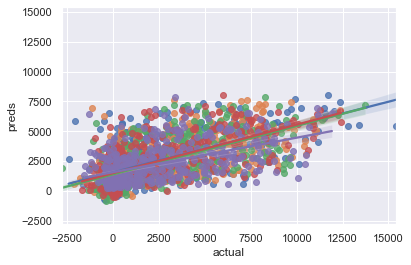

In [187]:
 %matplotlib inline
import seaborn as sns
from sklearn.model_selection import train_test_split, KFold, GroupKFold
from sklearn.svm import SVC, SVR
from sklearn.ensemble import RandomForestRegressor, RandomForestClassifier
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score, roc_auc_score, confusion_matrix
from sklearn.metrics import classification_report
from lightgbm import LGBMRegressor, LGBMClassifier, plot_importance
from xgboost import XGBRegressor
import lightgbm as lgb

Nfolds = 5
kfold = KFold(Nfolds)
avg_mae = 0
avg_rmse = 0
variance_preds = 0
variance_test = 0
avg_R2 = 0
avg_auc = 0 
#top_feats = np.arange(0,X_droped.shape[1])
for train_idx, valid_idx in kfold.split(X, y):
    X_train, X_test = X.iloc[train_idx,top_feats].values, X.iloc[valid_idx,top_feats].values

    y_train, y_test = y.astype(float).iloc[train_idx], y.astype(float).iloc[valid_idx]
    
    lgb_train = lgb.Dataset(X_train, y_train, params={'verbose': -1}, free_raw_data=False)
    lgb_eval = lgb.Dataset(X_test, y_test, params={'verbose': -1},free_raw_data=False)
    regr = lgb.train(params, 
                     lgb_train, 
                     valid_sets=lgb_eval, 
                     verbose_eval=50,
                    early_stopping_rounds=50)
    #regr = LGBMRegressor(params={'verbose': 1})
    #regr.fit(X_train, y_train)
    preds = regr.predict(X_test)
    plt.ylim(y.min(), y.max())
    plt.xlim(y.min(), y.max())
    sns.set(rc={'figure.figsize':(12,12)})
    sns.regplot(x=y_test, y=preds)
    plt.xlabel("actual")
    plt.ylabel("preds")
    
    avg_mae +=mean_absolute_error(preds, y_test)/Nfolds
    avg_rmse += mean_squared_error(preds, y_test, squared=False)/Nfolds
    ##variance_preds += preds.var()/Nfolds
    #variance_test += y_test.var()/Nfolds
    #top_feats.append(np.argsort(regr.feature_importances_)[-50:])
    avg_R2 += r2_score(y_test, preds)/Nfolds
    #print(confusion_matrix(y_test, preds))
    #print(roc_auc_score(y_test>10000, preds))
    avg_auc+=roc_auc_score(y_test>3000, preds)/Nfolds
    #print(classification_report(y_test,preds))
#plt.plot([y.min(), y.max()], [y.mean(), y.mean()], linewidth=5,)
#perfect = np.linspace(y.min(), y.max())
#plt.plot(perfect, perfect, linewidth=5,)
print('MAE: ', avg_mae)
print('RMSE: ', avg_rmse)
print('R2: ', avg_R2)
print('AUC: ', avg_auc)
#print('Variance ratio (test/preds): ',variance_test/variance_preds)

In [637]:
3.5*24

84.0

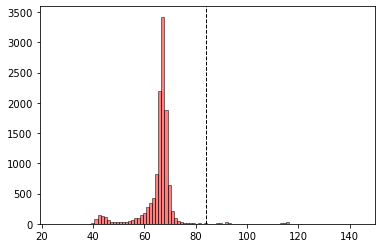

In [644]:
time_grade = plt.hist(zoe.loc[zoe['Morphological Grade - Time']>0]['Morphological Grade - Time'], bins=100,color='red', edgecolor='k', alpha=0.5)
plt.axvline(84, color='k', linestyle='dashed', linewidth=1)

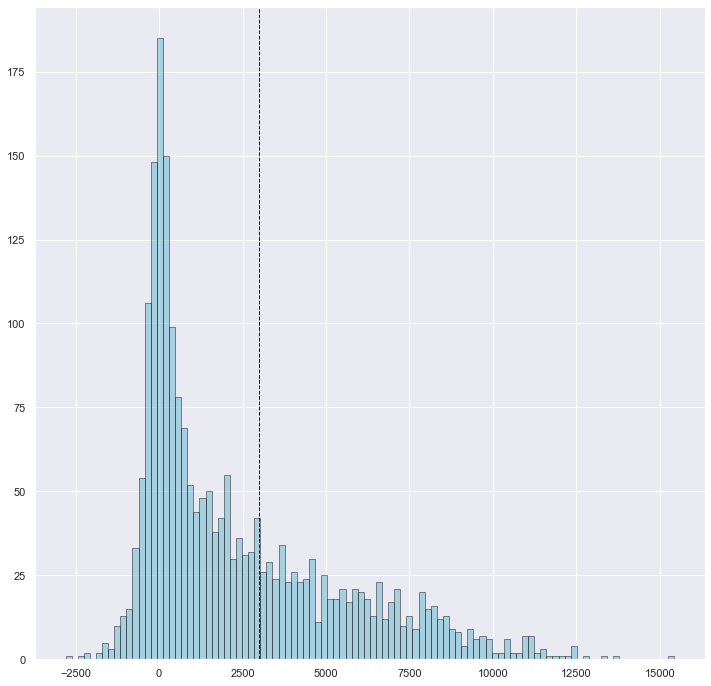

In [192]:
np.random.seed(6789)
x = np.random.gamma(4, 0.5, 1000)
result = plt.hist(y, bins=100, color='c', edgecolor='k', alpha=0.5)
plt.axvline(3000, color='k', linestyle='dashed', linewidth=1)

min_ylim, max_ylim = plt.ylim()
#plt.text('above 3000', max_ylim*0.9, 'Mean: {:.2f}'.format(x.mean()))

In [1000]:
hyper_params = {
    'task': 'train',
    'boosting_type': 'gbdt',
    'objective': 'binary',
    "num_leaves": 60,  

    "n_estimators": 200,
    "verbose":-1
}
y_b = y>3000
lgb_train = lgb.Dataset(X.iloc[:,top_feats].values, y_b, params={'verbose': 1}, free_raw_data=False)
lgb_eval = lgb.Dataset(X.iloc[:,top_feats].values, y_b, params={'verbose': -1},free_raw_data=False)
regr = lgb.train(hyper_params, 
                 lgb_train, 
                 valid_sets=lgb_eval, 
                 verbose_eval=50,
                early_stopping_rounds=50)

Training until validation scores don't improve for 50 rounds
[50]	valid_0's binary_logloss: 0.0449428
[100]	valid_0's binary_logloss: 0.00453663
[150]	valid_0's binary_logloss: 0.000472296
[200]	valid_0's binary_logloss: 4.99688e-05
Did not meet early stopping. Best iteration is:
[200]	valid_0's binary_logloss: 4.99688e-05


In [1001]:
import shap
shap_values = shap.TreeExplainer(regr).shap_values(X.iloc[:,top_feats].values)


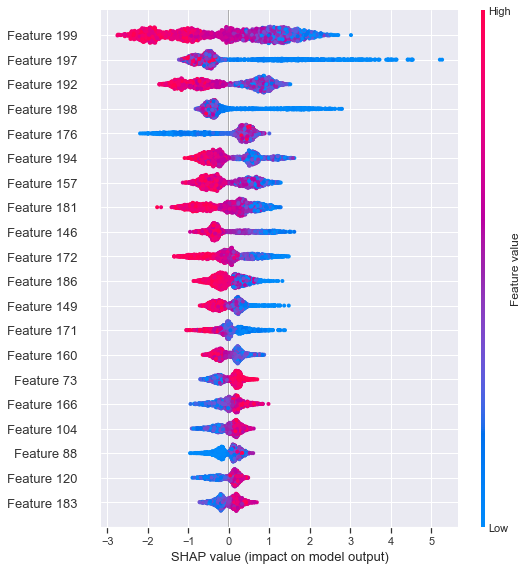

In [1002]:
shap.summary_plot(shap_values[0], X.iloc[:,top_feats].values)

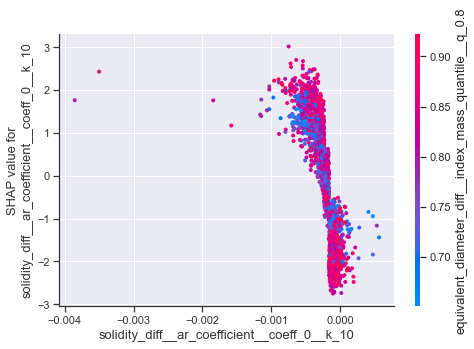

In [204]:
#shap.summary_plot(shap_values, X.iloc[:,top_feats])
shap.dependence_plot("solidity_diff__ar_coefficient__coeff_0__k_10", shap_values[0], X.iloc[:,top_feats])


In [208]:
df_pgs = pd.read_csv('C:/Users\hp\Desktop\outcome_images/data/extracted_pgs_large.csv')
dts = pd.read_csv('C:/Users\hp\Desktop\outcome_images/data/pgs_dts.csv')

In [209]:
dts.index = dts.id
df_pgs['dt'] = df_pgs.id.map(dts['0'])

In [211]:
df_pgs['Time'] = df_pgs.reset_index(drop=True).groupby('id').apply(lambda x: x.dt.cumsum()).values

In [212]:
def resample_(x):
    period = '30min'
    new_df = pd.DataFrame()
    
    for c in x.columns:
        if c!='id':
            ts = x.loc[x['Time']<=6][c]

            ts.index = pd.DatetimeIndex(x.loc[x['Time']<=6]['Time']*8.64e+13)
            ts = ts.resample('30min').mean()
            new_df[c] = ts
        else:
            continue
    return new_df


resampled_df = df_pgs.reset_index(drop=True).groupby('id').apply(resample_)

In [215]:
resampled_df['Time_days'] = resampled_df['Time']
del resampled_df['Time']

resampled_df = resampled_df.reset_index()
# resampled_df['Time_1'] = resampled_df['Time_1']-0.01043

In [218]:

X_ = resampled_df.groupby('id').apply(lambda x: x.loc[x.Time_days<4]).reset_index(drop=True)
X_['area_diff'] = X_.groupby('id').area.diff()
X_['solidity_diff'] = X_.groupby('id').solidity.diff()
X_['eccentricity_diff'] = X_.groupby('id').eccentricity.diff()
X_['equivalent_diameter_diff'] = X_.groupby('id').equivalent_diameter.diff()
X_['major_axis_length_diff'] = X_.groupby('id').major_axis_length.diff()
X_['minor_axis_length_diff'] = X_.groupby('id').minor_axis_length.diff()
X_['inertia_tensor-0-1_diff'] = X_.groupby('id')['inertia_tensor-0-1'].diff()
X_['inertia_tensor-0-0_diff'] = X_.groupby('id')['inertia_tensor-0-0'].diff()
X_['inertia_tensor-1-0_diff'] = X_.groupby('id')['inertia_tensor-1-0'].diff()
X_['inertia_tensor-1-1_diff'] = X_.groupby('id')['inertia_tensor-1-1'].diff()

X_ = X_.fillna(0)

In [227]:
from tsfresh.feature_extraction import settings

In [228]:
features_list

['eccentricity',
 'minor_axis_length',
 'major_axis_length',
 'area',
 'area_diff',
 'solidity_diff',
 'eccentricity_diff',
 'equivalent_diameter_diff',
 'major_axis_length_diff',
 'minor_axis_length_diff',
 'inertia_tensor-0-1_diff',
 'inertia_tensor-0-0_diff',
 'inertia_tensor-1-0_diff',
 'inertia_tensor-1-1_diff',
 'Time_1']

In [229]:
from tsfresh.feature_extraction import EfficientFCParameters, MinimalFCParameters
fcp_settings = settings.from_columns(X.iloc[:,top_feats])
# Set here the options of the settings object as shown in the paragraphs below
from tsfresh.feature_extraction import extract_features
extracted_feats_lean = extract_features(X_[['id', 'Time_days']+features_list[:-1]].dropna(),
                                        kind_to_fc_parameters=fcp_settings,
                                        column_id='id')

Feature Extraction: 100%|████████████████████████████████████████████████████████████| 140/140 [00:14<00:00,  9.58it/s]


In [233]:
extracted_feats_lean.info(max_cols=200)

<class 'pandas.core.frame.DataFrame'>
Index: 632 entries, D2011.06.29_S0078_I149_1 to D2019.05.29_S02007_I0149_D_2
Data columns (total 200 columns):
 #   Column                                                                                 Non-Null Count  Dtype  
---  ------                                                                                 --------------  -----  
 0   eccentricity__fft_coefficient__attr_"angle"__coeff_79                                  460 non-null    float64
 1   eccentricity__fft_coefficient__attr_"angle"__coeff_30                                  632 non-null    float64
 2   eccentricity__fft_coefficient__attr_"angle"__coeff_29                                  632 non-null    float64
 3   eccentricity__fft_coefficient__attr_"angle"__coeff_65                                  626 non-null    float64
 4   eccentricity__fft_coefficient__attr_"angle"__coeff_59                                  629 non-null    float64
 5   eccentricity__fft_coefficient__att

In [248]:
labels = pd.read_csv('C:/Users\hp\Desktop\outcome_images/data/big_pgt_df.csv')

In [979]:
labels['Morphological Grade - Value']

id
D2011.06.29_S0078_I149_1         2.5
D2011.06.29_S0078_I149_2         2.5
D2011.06.29_S0078_I149_4           2
D2011.06.29_S0078_I149_5         1.5
D2011.06.29_S0079_I149_1           2
                                ... 
D2020.01.24_S02145_I0149_D_12    NaN
D2020.02.17_S02164_I0149_D_1     NaN
D2020.03.05_S02177_I0149_D_1       4
D2020.03.05_S02177_I0149_D_2       3
D2020.03.05_S02177_I0149_D_3     2.5
Name: Morphological Grade - Value, Length: 1539, dtype: object

In [ ]:
labels_grade['Morphological Grade - Value'].

In [981]:
labels_grade = labels.loc[pgs_label.index]

In [989]:
labels_grade['Morphological Grade - Value'] = labels_grade['Morphological Grade - Value'].replace('3,5', '3.5')
labels_grade['Morphological Grade - Value'] = labels_grade['Morphological Grade - Value'].replace('2,5', '2.5')
labels_grade['Morphological Grade - Value'] = labels_grade['Morphological Grade - Value'].replace('1,5', '1.5')
labels_grade['Morphological Grade - Value'] = labels_grade['Morphological Grade - Value'].replace('ARREST', '4')

In [1008]:
labels_grade['Morphological Grade - Value'].value_counts()

,Slide ID_x,Patient ID_x,Patient Name,Birth Year,Birth Month,BMI,Diagnosis,Basal Serum FSH,Patient Comments,Fertilization,...,X,Y,livebirth/ongoing,Transferred_y,Slide ID_y,Well_y,Embryo Description_y,PGT Result,Class_Grade_y,drop
D2011.06.29_S0078_I149_1,D2011.06.29_S0078_I149,477687,FRAGIADAKI Theonymphi,1977.0,9.0,25.0,NaN,0.0,PGS,40723.56944,...,0,1,NaN,NaN,D2011.06.29_S0078_I149,1,COMPLEX,Complex,0,1.0
D2011.06.29_S0078_I149_2,D2011.06.29_S0078_I149,477687,FRAGIADAKI Theonymphi,1977.0,9.0,25.0,NaN,0.0,PGS,40723.56944,...,1,1,NaN,NaN,D2011.06.29_S0078_I149,2,EUPLOID,"Euploid, male",2,NaN
D2011.06.29_S0078_I149_4,D2011.06.29_S0078_I149,477687,FRAGIADAKI Theonymphi,1977.0,9.0,25.0,NaN,0.0,PGS,40723.56944,...,2,0,NaN,NaN,D2011.06.29_S0078_I149,4,COMPLEX,Complex,0,1.0
D2011.06.29_S0078_I149_5,D2011.06.29_S0078_I149,477687,FRAGIADAKI Theonymphi,1977.0,9.0,25.0,NaN,0.0,PGS,40723.56944,...,1,1,NaN,NaN,D2011.06.29_S0078_I149,5,EUPLOID,"Euploid, male",2,NaN
D2011.06.29_S0079_I149_1,D2011.06.29_S0079_I149,475984,CHATZIKIRIAKIDOU Aikaterini,1976.0,2.0,0.0,NaN,0.0,PGS MULTIPLE FAILURES & 2X BIOCHEMICALS,40723.56944,...,2,0,NaN,NaN,D2011.06.29_S0079_I149,1,NORMAL,"Euploid, male",2,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
D2019.04.22_S01986_I0149_D_4,D2019.04.22_S01986_I0149_D,505114,ANDRIANOPOULOU THEOFANIA,1991.0,6.0,NaN,Male factor,NaN,NaN,43577.54861,...,1,1,NaN,NaN,D2019.04.22_S01986_I0149_D,4,"MOSAIC 13, MOSAIC MONO 2P16.3","mosaic trisomy 13, mosaic monosomy 2p16.3",1,NaN
D2019.04.22_S01986_I0149_D_6,D2019.04.22_S01986_I0149_D,505114,ANDRIANOPOULOU THEOFANIA,1991.0,6.0,NaN,Male factor,NaN,NaN,43577.54861,...,mos mon X,0,NaN,NaN,D2019.04.22_S01986_I0149_D,6,"MOSAIC MONO 2,3,X","mosaic monosomy 2,3,X",1,NaN
D2019.04.22_S01986_I0149_D_9,D2019.04.22_S01986_I0149_D,505114,ANDRIANOPOULOU THEOFANIA,1991.0,6.0,NaN,Male factor,NaN,NaN,43577.54861,...,2,0,NaN,NaN,D2019.04.22_S01986_I0149_D,9,"MOSAIC MONO3, MOSAIC TRIS15, DUPLICATION 6Q","mosaic monosomy 3, mosaic trisomy 15, duplicat...",1,NaN
D2019.05.29_S02007_I0149_D_1,D2019.05.29_S02007_I0149_D,508178,LIKOU ELISAVET,1986.0,6.0,NaN,NaN,NaN,NaN,43614.54167,...,2,0,NaN,NaN,D2019.05.29_S02007_I0149_D,1,no embryoscope number found,euploid,2,1.0


In [249]:
labels['id'] = labels['Slide ID_x']+'_'+labels['Well_y'].astype(str)
labels = labels.drop_duplicates('id')
labels.index = labels.id

In [361]:
pgs_label = labels.loc[extracted_feats_lean.index]['Class_Grade_y']
pgs_label = pgs_label.replace('NR','0')
pgs_label = pgs_label.replace('1','0')
pgs_label = pgs_label.replace('2','1')

In [999]:
extracted_feats_lean

,"eccentricity__fft_coefficient__attr_""angle""__coeff_79","eccentricity__fft_coefficient__attr_""angle""__coeff_30","eccentricity__fft_coefficient__attr_""angle""__coeff_29","eccentricity__fft_coefficient__attr_""angle""__coeff_65","eccentricity__fft_coefficient__attr_""angle""__coeff_59","eccentricity__fft_coefficient__attr_""angle""__coeff_16","eccentricity__fft_coefficient__attr_""abs""__coeff_89","eccentricity__fft_coefficient__attr_""angle""__coeff_80","eccentricity__fft_coefficient__attr_""angle""__coeff_66","eccentricity__fft_coefficient__attr_""abs""__coeff_70",...,"inertia_tensor-1-1_diff__fft_coefficient__attr_""abs""__coeff_60","inertia_tensor-1-1_diff__fft_coefficient__attr_""abs""__coeff_79","inertia_tensor-1-1_diff__fft_coefficient__attr_""real""__coeff_91","inertia_tensor-1-1_diff__fft_coefficient__attr_""real""__coeff_71","inertia_tensor-1-1_diff__fft_coefficient__attr_""abs""__coeff_30","inertia_tensor-1-1_diff__fft_coefficient__attr_""imag""__coeff_70","inertia_tensor-1-1_diff__fft_coefficient__attr_""real""__coeff_9","inertia_tensor-1-1_diff__linear_trend__attr_""pvalue""",inertia_tensor-1-1_diff__index_mass_quantile__q_0.9,inertia_tensor-1-1_diff__energy_ratio_by_chunks__num_segments_10__segment_focus_9
D2011.06.29_S0078_I149_1,NaN,141.845843,6.346689,117.420221,115.044384,127.886492,NaN,NaN,180.000000,NaN,...,274.760932,NaN,NaN,NaN,284.067099,NaN,343.282884,0.669991,0.939394,0.046599
D2011.06.29_S0078_I149_2,NaN,-136.699873,109.265215,-127.014145,-148.927620,123.114654,NaN,NaN,180.000000,NaN,...,46.609987,NaN,NaN,NaN,335.179417,NaN,-70.238683,0.299812,0.886364,0.038273
D2011.06.29_S0078_I149_4,NaN,126.820246,-94.258149,-146.023345,-171.684990,151.500102,NaN,NaN,180.000000,NaN,...,459.591024,NaN,NaN,NaN,155.033664,NaN,364.872344,0.881993,0.765152,0.012225
D2011.06.29_S0078_I149_5,NaN,151.732884,131.865701,125.682726,156.125535,-41.611515,NaN,NaN,180.000000,NaN,...,65.240952,NaN,NaN,NaN,289.755093,NaN,299.485157,0.826924,0.916667,0.106561
D2011.06.29_S0079_I149_1,NaN,-48.896067,-153.681346,7.180099,-2.733944,-39.739548,NaN,NaN,NaN,NaN,...,8.780986,NaN,NaN,NaN,416.491825,NaN,-60.489354,0.545815,0.854962,0.021026
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
D2019.04.22_S01986_I0149_D_4,13.873160,142.049301,-134.282059,-53.171232,-7.094636,6.559053,0.232870,71.943169,2.184601,0.422940,...,200.103710,200.486707,98.081576,-224.806781,161.022978,-212.854034,-67.623736,0.914182,0.921875,0.107564
D2019.04.22_S01986_I0149_D_6,-86.877557,-169.489008,116.715247,105.124990,9.088201,170.154018,0.065704,-125.967424,-0.068939,0.757334,...,368.974503,114.858617,75.992305,-48.091760,208.385540,113.764498,107.039626,0.853434,0.942708,0.130152
D2019.04.22_S01986_I0149_D_9,75.492731,88.963707,-86.377538,-144.848735,-60.988155,-52.501085,0.119507,1.452644,-20.968650,0.697847,...,318.474232,232.630606,-37.810024,346.811224,95.818630,-4.725745,-52.833066,0.946954,0.901042,0.031403
D2019.05.29_S02007_I0149_D_1,NaN,126.473016,150.534792,9.142974,7.754894,-31.015189,NaN,NaN,NaN,NaN,...,98.405610,NaN,NaN,NaN,104.580730,NaN,91.007291,0.978426,0.877863,0.051318


In [1003]:
shap_values_pgs = shap.TreeExplainer(regr).shap_values(extracted_feats_lean)

In [1007]:
extracted_feats_lean

,"eccentricity__fft_coefficient__attr_""angle""__coeff_79","eccentricity__fft_coefficient__attr_""angle""__coeff_30","eccentricity__fft_coefficient__attr_""angle""__coeff_29","eccentricity__fft_coefficient__attr_""angle""__coeff_65","eccentricity__fft_coefficient__attr_""angle""__coeff_59","eccentricity__fft_coefficient__attr_""angle""__coeff_16","eccentricity__fft_coefficient__attr_""abs""__coeff_89","eccentricity__fft_coefficient__attr_""angle""__coeff_80","eccentricity__fft_coefficient__attr_""angle""__coeff_66","eccentricity__fft_coefficient__attr_""abs""__coeff_70",...,"inertia_tensor-1-1_diff__fft_coefficient__attr_""abs""__coeff_60","inertia_tensor-1-1_diff__fft_coefficient__attr_""abs""__coeff_79","inertia_tensor-1-1_diff__fft_coefficient__attr_""real""__coeff_91","inertia_tensor-1-1_diff__fft_coefficient__attr_""real""__coeff_71","inertia_tensor-1-1_diff__fft_coefficient__attr_""abs""__coeff_30","inertia_tensor-1-1_diff__fft_coefficient__attr_""imag""__coeff_70","inertia_tensor-1-1_diff__fft_coefficient__attr_""real""__coeff_9","inertia_tensor-1-1_diff__linear_trend__attr_""pvalue""",inertia_tensor-1-1_diff__index_mass_quantile__q_0.9,inertia_tensor-1-1_diff__energy_ratio_by_chunks__num_segments_10__segment_focus_9
D2011.06.29_S0078_I149_1,NaN,141.845843,6.346689,117.420221,115.044384,127.886492,NaN,NaN,180.000000,NaN,...,274.760932,NaN,NaN,NaN,284.067099,NaN,343.282884,0.669991,0.939394,0.046599
D2011.06.29_S0078_I149_2,NaN,-136.699873,109.265215,-127.014145,-148.927620,123.114654,NaN,NaN,180.000000,NaN,...,46.609987,NaN,NaN,NaN,335.179417,NaN,-70.238683,0.299812,0.886364,0.038273
D2011.06.29_S0078_I149_4,NaN,126.820246,-94.258149,-146.023345,-171.684990,151.500102,NaN,NaN,180.000000,NaN,...,459.591024,NaN,NaN,NaN,155.033664,NaN,364.872344,0.881993,0.765152,0.012225
D2011.06.29_S0078_I149_5,NaN,151.732884,131.865701,125.682726,156.125535,-41.611515,NaN,NaN,180.000000,NaN,...,65.240952,NaN,NaN,NaN,289.755093,NaN,299.485157,0.826924,0.916667,0.106561
D2011.06.29_S0079_I149_1,NaN,-48.896067,-153.681346,7.180099,-2.733944,-39.739548,NaN,NaN,NaN,NaN,...,8.780986,NaN,NaN,NaN,416.491825,NaN,-60.489354,0.545815,0.854962,0.021026
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
D2019.04.22_S01986_I0149_D_4,13.873160,142.049301,-134.282059,-53.171232,-7.094636,6.559053,0.232870,71.943169,2.184601,0.422940,...,200.103710,200.486707,98.081576,-224.806781,161.022978,-212.854034,-67.623736,0.914182,0.921875,0.107564
D2019.04.22_S01986_I0149_D_6,-86.877557,-169.489008,116.715247,105.124990,9.088201,170.154018,0.065704,-125.967424,-0.068939,0.757334,...,368.974503,114.858617,75.992305,-48.091760,208.385540,113.764498,107.039626,0.853434,0.942708,0.130152
D2019.04.22_S01986_I0149_D_9,75.492731,88.963707,-86.377538,-144.848735,-60.988155,-52.501085,0.119507,1.452644,-20.968650,0.697847,...,318.474232,232.630606,-37.810024,346.811224,95.818630,-4.725745,-52.833066,0.946954,0.901042,0.031403
D2019.05.29_S02007_I0149_D_1,NaN,126.473016,150.534792,9.142974,7.754894,-31.015189,NaN,NaN,NaN,NaN,...,98.405610,NaN,NaN,NaN,104.580730,NaN,91.007291,0.978426,0.877863,0.051318


In [1006]:
shap_values_pgs_df = pd.DataFrame(shap_values_pgs[1])



In [1019]:
shap_values_pgs_df.index = extracted_feats_lean.index

In [1020]:
labels_grade['Morphological Grade - Value']

D2011.06.29_S0078_I149_1        2.5
D2011.06.29_S0078_I149_2        2.5
D2011.06.29_S0078_I149_4          2
D2011.06.29_S0078_I149_5        1.5
D2011.06.29_S0079_I149_1          2
                               ... 
D2019.04.22_S01986_I0149_D_4      2
D2019.04.22_S01986_I0149_D_6      2
D2019.04.22_S01986_I0149_D_9      2
D2019.05.29_S02007_I0149_D_1    2.5
D2019.05.29_S02007_I0149_D_2      3
Name: Morphological Grade - Value, Length: 632, dtype: object

In [1021]:
labels_grade['Morphological Grade - Value'].astype(float)

D2011.06.29_S0078_I149_1        2.5
D2011.06.29_S0078_I149_2        2.5
D2011.06.29_S0078_I149_4        2.0
D2011.06.29_S0078_I149_5        1.5
D2011.06.29_S0079_I149_1        2.0
                               ... 
D2019.04.22_S01986_I0149_D_4    2.0
D2019.04.22_S01986_I0149_D_6    2.0
D2019.04.22_S01986_I0149_D_9    2.0
D2019.05.29_S02007_I0149_D_1    2.5
D2019.05.29_S02007_I0149_D_2    3.0
Name: Morphological Grade - Value, Length: 632, dtype: float64

In [1022]:
shap_values_pgs_df

,0,1,2,3,4,5,6,7,8,9,...,190,191,192,193,194,195,196,197,198,199
D2011.06.29_S0078_I149_1,0.066923,-0.036111,-0.094443,-0.060538,0.079922,-0.029550,-0.041311,0.045420,0.032135,0.008869,...,0.022753,0.013910,0.963986,-0.005346,0.673194,0.006697,0.011278,0.857400,0.395777,2.079173
D2011.06.29_S0078_I149_2,0.062813,-0.052225,-0.098530,0.110350,-0.503106,0.040934,-0.043204,0.035371,0.047815,0.002884,...,0.020042,0.000571,0.807758,0.037947,0.751380,0.010179,-0.009069,0.761974,0.515555,1.811591
D2011.06.29_S0078_I149_4,0.098093,-0.022991,0.013750,0.111406,-0.403204,0.085085,-0.062357,0.048628,0.058795,-0.002632,...,0.023261,0.012626,0.820176,0.085666,0.787129,0.008288,0.007146,0.674297,0.468466,1.546441
D2011.06.29_S0078_I149_5,0.074033,-0.125206,-0.041584,-0.110605,0.130807,0.017934,-0.065176,0.036178,0.105535,-0.003660,...,0.021965,0.093793,0.623130,-0.024877,0.945760,0.004613,0.006643,0.630444,0.390315,1.638425
D2011.06.29_S0079_I149_1,0.065956,-0.022027,0.013486,0.011289,-0.416617,-0.028168,-0.053314,0.029522,-0.007714,-0.022916,...,0.026167,0.068556,0.622024,0.046843,0.904104,0.007767,-0.001633,0.732728,0.447139,1.785581
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
D2019.04.22_S01986_I0149_D_4,0.077885,-0.116674,0.026104,0.020279,-0.357501,-0.008826,-0.009515,0.022416,-0.010872,0.010753,...,0.022714,-0.046041,0.769691,-0.107259,0.970762,-0.021495,-0.011242,0.682982,0.373147,1.967214
D2019.04.22_S01986_I0149_D_6,0.151884,-0.090233,-0.066364,-0.038780,0.119593,-0.023282,-0.057879,0.036307,0.030641,0.035960,...,0.041644,0.063903,0.933866,-0.056931,0.922313,-0.025940,-0.018136,0.817371,0.361326,1.982242
D2019.04.22_S01986_I0149_D_9,0.056134,-0.069466,-0.033472,0.024341,-0.387331,0.055030,-0.050058,0.029921,-0.047874,0.014550,...,0.030401,-0.068714,-0.496586,0.159819,0.780446,-0.014533,-0.021814,0.724553,0.399570,1.903414
D2019.05.29_S02007_I0149_D_1,0.061232,-0.132935,-0.070788,-0.016235,0.121014,-0.028789,-0.050239,0.025557,-0.040321,-0.003449,...,0.019383,0.067339,0.723491,0.041212,0.719349,0.008247,-0.015910,0.703162,0.467304,1.955929


In [1023]:
labels_grade['Morphological Grade - Value']

D2011.06.29_S0078_I149_1        2.5
D2011.06.29_S0078_I149_2        2.5
D2011.06.29_S0078_I149_4          2
D2011.06.29_S0078_I149_5        1.5
D2011.06.29_S0079_I149_1          2
                               ... 
D2019.04.22_S01986_I0149_D_4      2
D2019.04.22_S01986_I0149_D_6      2
D2019.04.22_S01986_I0149_D_9      2
D2019.05.29_S02007_I0149_D_1    2.5
D2019.05.29_S02007_I0149_D_2      3
Name: Morphological Grade - Value, Length: 632, dtype: object

In [1026]:
shap_values_pgs_df['grade'] = shap_values_pgs_df.index.map(labels_grade['Morphological Grade - Value'].astype(float))

In [1027]:
shap.summary_plot(shap_values_pgs[0], extracted_feats_lean.drop(['grade', 'cluster'],axis=1))

KeyError: "['grade' 'cluster'] not found in axis"

In [1058]:
scaler = StandardScaler()

In [1076]:
pca = PCA(n_components=3)

In [1077]:
shap_values_pgs_df

,0,1,2,3,4,5,6,7,8,9,...,191,192,193,194,195,196,197,198,199,grade
D2011.06.29_S0078_I149_1,0.066923,-0.036111,-0.094443,-0.060538,0.079922,-0.029550,-0.041311,0.045420,0.032135,0.008869,...,0.013910,0.963986,-0.005346,0.673194,0.006697,0.011278,0.857400,0.395777,2.079173,2.5
D2011.06.29_S0078_I149_2,0.062813,-0.052225,-0.098530,0.110350,-0.503106,0.040934,-0.043204,0.035371,0.047815,0.002884,...,0.000571,0.807758,0.037947,0.751380,0.010179,-0.009069,0.761974,0.515555,1.811591,2.5
D2011.06.29_S0078_I149_4,0.098093,-0.022991,0.013750,0.111406,-0.403204,0.085085,-0.062357,0.048628,0.058795,-0.002632,...,0.012626,0.820176,0.085666,0.787129,0.008288,0.007146,0.674297,0.468466,1.546441,2.0
D2011.06.29_S0078_I149_5,0.074033,-0.125206,-0.041584,-0.110605,0.130807,0.017934,-0.065176,0.036178,0.105535,-0.003660,...,0.093793,0.623130,-0.024877,0.945760,0.004613,0.006643,0.630444,0.390315,1.638425,1.5
D2011.06.29_S0079_I149_1,0.065956,-0.022027,0.013486,0.011289,-0.416617,-0.028168,-0.053314,0.029522,-0.007714,-0.022916,...,0.068556,0.622024,0.046843,0.904104,0.007767,-0.001633,0.732728,0.447139,1.785581,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
D2019.04.22_S01986_I0149_D_4,0.077885,-0.116674,0.026104,0.020279,-0.357501,-0.008826,-0.009515,0.022416,-0.010872,0.010753,...,-0.046041,0.769691,-0.107259,0.970762,-0.021495,-0.011242,0.682982,0.373147,1.967214,2.0
D2019.04.22_S01986_I0149_D_6,0.151884,-0.090233,-0.066364,-0.038780,0.119593,-0.023282,-0.057879,0.036307,0.030641,0.035960,...,0.063903,0.933866,-0.056931,0.922313,-0.025940,-0.018136,0.817371,0.361326,1.982242,2.0
D2019.04.22_S01986_I0149_D_9,0.056134,-0.069466,-0.033472,0.024341,-0.387331,0.055030,-0.050058,0.029921,-0.047874,0.014550,...,-0.068714,-0.496586,0.159819,0.780446,-0.014533,-0.021814,0.724553,0.399570,1.903414,2.0
D2019.05.29_S02007_I0149_D_1,0.061232,-0.132935,-0.070788,-0.016235,0.121014,-0.028789,-0.050239,0.025557,-0.040321,-0.003449,...,0.067339,0.723491,0.041212,0.719349,0.008247,-0.015910,0.703162,0.467304,1.955929,2.5


In [1095]:
shap_values_pgs_pca = pca.fit_transform(shap_values_pgs_df.fillna(0))

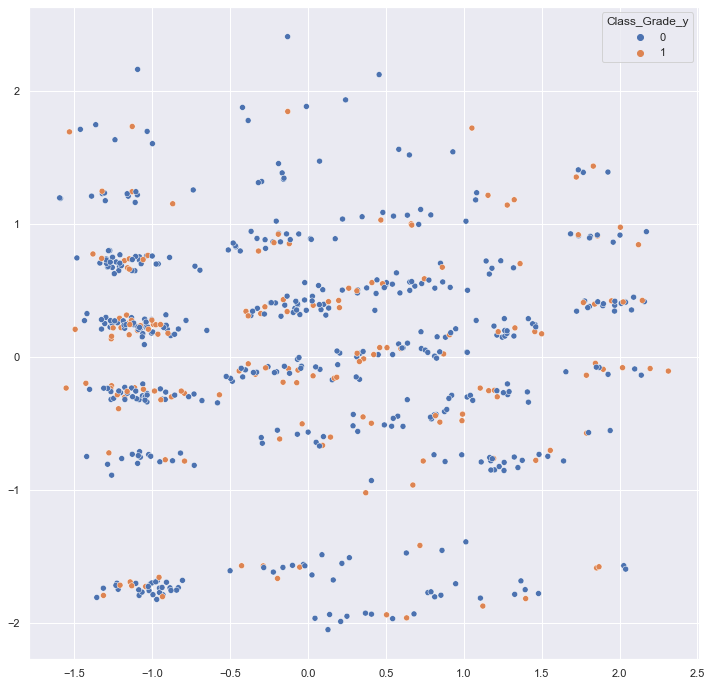

In [1096]:
sns.scatterplot(shap_values_pgs_pca[:,0], shap_values_pgs_pca[:,1], hue=pgs_label)

In [1097]:
pgs_label_df['Class_Grade_y']

D2011.06.29_S0078_I149_1        0
D2011.06.29_S0078_I149_2        1
D2011.06.29_S0078_I149_4        0
D2011.06.29_S0078_I149_5        1
D2011.06.29_S0079_I149_1        1
                               ..
D2019.04.22_S01986_I0149_D_4    0
D2019.04.22_S01986_I0149_D_6    0
D2019.04.22_S01986_I0149_D_9    0
D2019.05.29_S02007_I0149_D_1    1
D2019.05.29_S02007_I0149_D_2    0
Name: Class_Grade_y, Length: 632, dtype: object

In [1098]:
from sklearn.cluster import KMeans
kmeans = KMeans(n_clusters=5)

In [1099]:
clusters = kmeans.fit_predict(shap_values_pgs_pca)

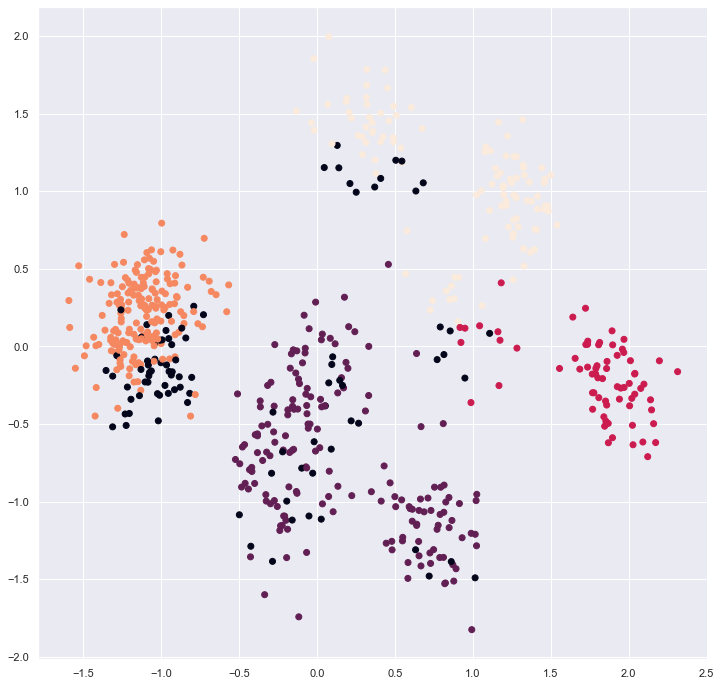

In [1103]:
plt.scatter(shap_values_pgs_pca[:,0], shap_values_pgs_pca[:,2], c=clusters[:,None])

In [1104]:
pgs_label_df = pd.DataFrame(pgs_label)
pgs_label_df['cluster'] = clusters

In [1105]:
X_.index = X_.id

In [1106]:
X_.loc[pgs_label_df.loc[pgs_label_df['cluster']==1].index].reset_index(drop=True).\
                groupby('id').apply(lambda x: x.Time_days.max()).mean()

3.9306243589666683

In [1107]:
perc_in_sample = 0.740
for i in range(10):
    samples_in_cluster = pgs_label_df.loc[pgs_label_df['cluster']==i].shape[0]
    positives = pgs_label_df.loc[pgs_label_df['cluster']==i].astype(int).sum().values[0]
    
    ratio = (samples_in_cluster - positives)/samples_in_cluster
    
    print(f'Cluster {i} ratio: {ratio}, dev: {(perc_in_sample-ratio)/perc_in_sample}')
    print(f'Cluster size {samples_in_cluster}\n')

Cluster 0 ratio: 0.8064516129032258, dev: -0.08979947689625103
Cluster size 93

Cluster 1 ratio: 0.7602339181286549, dev: -0.027343132606290458
Cluster size 171

Cluster 2 ratio: 0.6857142857142857, dev: 0.07335907335907334
Cluster size 70

Cluster 3 ratio: 0.7219251336898396, dev: 0.024425495013730297
Cluster size 187

Cluster 4 ratio: 0.7207207207207207, dev: 0.026053080107134197
Cluster size 111

Cluster 5 ratio: nan, dev: nan
Cluster size 0

Cluster 6 ratio: nan, dev: nan
Cluster size 0

Cluster 7 ratio: nan, dev: nan
Cluster size 0

Cluster 8 ratio: nan, dev: nan
Cluster size 0

Cluster 9 ratio: nan, dev: nan
Cluster size 0



0.7403200000000001

In [824]:
extracted_feats_lean = extracted_feats_lean.drop(['grade', 'cluster'],axis=1)

KeyError: "['grade' 'cluster'] not found in axis"

In [695]:
stats1 = extracted_feats_lean.loc[pgs_label_df.loc[pgs_label_df['cluster']!=0].index].describe()

In [825]:
stats2 = extracted_feats_lean.loc[pgs_label_df.loc[pgs_label_df['cluster']==0].index].describe()

In [826]:
stats1 = stats1.loc[['mean','std',]]
stats2 = stats2.loc[['mean','std',]]

In [827]:
((stats1-stats2)/stats1).mean(axis=0).abs()>.6

eccentricity__fft_coefficient__attr_"angle"__coeff_79                                 True
eccentricity__fft_coefficient__attr_"angle"__coeff_30                                False
eccentricity__fft_coefficient__attr_"angle"__coeff_29                                False
eccentricity__fft_coefficient__attr_"angle"__coeff_65                                 True
eccentricity__fft_coefficient__attr_"angle"__coeff_59                                 True
                                                                                     ...  
inertia_tensor-1-1_diff__fft_coefficient__attr_"imag"__coeff_70                       True
inertia_tensor-1-1_diff__fft_coefficient__attr_"real"__coeff_9                       False
inertia_tensor-1-1_diff__linear_trend__attr_"pvalue"                                 False
inertia_tensor-1-1_diff__index_mass_quantile__q_0.9                                  False
inertia_tensor-1-1_diff__energy_ratio_by_chunks__num_segments_10__segment_focus_9    False

In [828]:
statement1 = ((stats1-stats2)/stats1).loc['std'].abs()>0.1
statement2 = ((stats1-stats2)/stats1).loc['mean'].abs()>0.1

In [831]:
msk = (((stats1-stats2)/stats1).mean(axis=0).abs()>0.5
      ).values

In [832]:
msk.sum()

84

In [833]:
selected = extracted_feats_lean.iloc[:,msk].copy()

In [834]:
selected['cluster'] = selected.index.map(pgs_label_df['cluster'])!=5
selected['grade'] = selected.index.map(pgs_label_df['Class_Grade_y'])

In [835]:
extracted_feats_lean.iloc[:,msk].fillna(0)

,"eccentricity__fft_coefficient__attr_""angle""__coeff_79","eccentricity__fft_coefficient__attr_""angle""__coeff_65","eccentricity__fft_coefficient__attr_""angle""__coeff_59","eccentricity__fft_coefficient__attr_""angle""__coeff_80","eccentricity__fft_coefficient__attr_""real""__coeff_63","eccentricity__fft_coefficient__attr_""real""__coeff_37","eccentricity__fft_coefficient__attr_""real""__coeff_32","minor_axis_length__fft_coefficient__attr_""imag""__coeff_15","minor_axis_length__fft_coefficient__attr_""real""__coeff_16","area__fft_coefficient__attr_""angle""__coeff_18",...,"inertia_tensor-0-0_diff__fft_coefficient__attr_""imag""__coeff_41","inertia_tensor-0-0_diff__fft_coefficient__attr_""imag""__coeff_52","inertia_tensor-0-0_diff__fft_coefficient__attr_""real""__coeff_63","inertia_tensor-0-0_diff__fft_coefficient__attr_""angle""__coeff_25","inertia_tensor-0-0_diff__fft_coefficient__attr_""angle""__coeff_81","inertia_tensor-0-0_diff__fft_coefficient__attr_""angle""__coeff_59","inertia_tensor-0-0_diff__agg_linear_trend__attr_""slope""__chunk_len_50__f_agg_""min""","inertia_tensor-1-1_diff__fft_coefficient__attr_""real""__coeff_91","inertia_tensor-1-1_diff__fft_coefficient__attr_""real""__coeff_71","inertia_tensor-1-1_diff__fft_coefficient__attr_""imag""__coeff_70"
D2011.06.29_S0078_I149_1,0.000000,117.420221,115.044384,0.000000,0.226088,-0.428237,0.086828,18.133406,29.591487,85.261311,...,152.379838,70.347334,-165.482217,-160.145940,0.000000,137.724033,6.776379,0.000000,0.000000,0.000000
D2011.06.29_S0078_I149_2,0.000000,-127.014145,-148.927620,0.000000,-0.002487,-0.101220,-0.407783,-3.233692,-14.972858,140.686428,...,11.428892,-62.992143,170.939992,-76.257877,0.000000,-144.490485,5.758078,0.000000,0.000000,0.000000
D2011.06.29_S0078_I149_4,0.000000,-146.023345,-171.684990,0.000000,0.098316,-0.414771,0.235596,-2.830774,-17.498525,159.032616,...,-124.524387,10.868164,50.992398,-19.427514,0.000000,29.228412,8.453873,0.000000,0.000000,0.000000
D2011.06.29_S0078_I149_5,0.000000,125.682726,156.125535,0.000000,-0.149938,0.007327,-0.082582,-8.726196,4.426392,102.020143,...,24.772619,-28.752442,85.433781,-46.124562,0.000000,151.270996,19.043206,0.000000,0.000000,0.000000
D2011.06.29_S0079_I149_1,0.000000,7.180099,-2.733944,0.000000,0.382937,-0.151159,0.645095,-26.953322,11.621368,129.389525,...,347.721777,295.088524,489.217088,143.083106,0.000000,7.675405,82.022836,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
D2019.04.22_S01986_I0149_D_4,13.873160,-53.171232,-7.094636,71.943169,0.271357,-0.275989,1.288535,8.166244,3.905442,-149.854978,...,-166.765620,136.720093,-246.827321,26.160070,87.328849,172.288197,-3.024490,98.081576,-224.806781,-212.854034
D2019.04.22_S01986_I0149_D_6,-86.877557,105.124990,9.088201,-125.967424,0.477177,0.026660,0.057804,-9.130392,17.183420,77.739560,...,248.855290,35.362114,242.996307,166.398374,132.479832,4.521861,-5.946847,75.992305,-48.091760,113.764498
D2019.04.22_S01986_I0149_D_9,75.492731,-144.848735,-60.988155,1.452644,0.331033,0.216831,0.345881,30.982045,-10.950864,-43.194844,...,145.922789,206.136672,282.904857,-14.541677,-106.998644,46.693435,0.253633,-37.810024,346.811224,-4.725745
D2019.05.29_S02007_I0149_D_1,0.000000,9.142974,7.754894,0.000000,-0.032287,-0.063899,-0.020778,-4.162030,-10.450016,5.920830,...,-177.978678,145.784479,-109.638314,-27.771490,0.000000,-13.718028,29.991989,0.000000,0.000000,0.000000


eccentricity__fft_coefficient__attr_"angle"__coeff_79


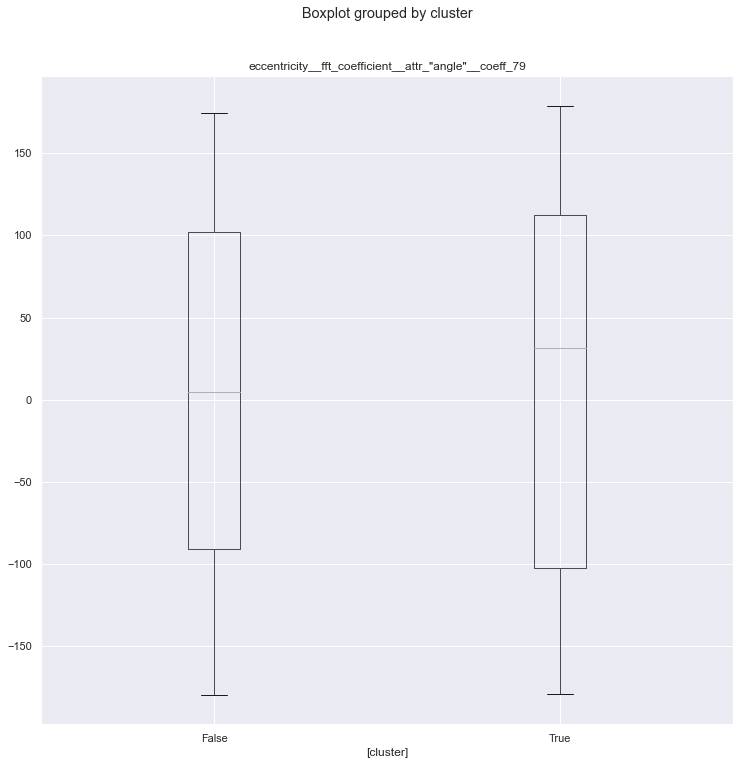

eccentricity__fft_coefficient__attr_"angle"__coeff_65


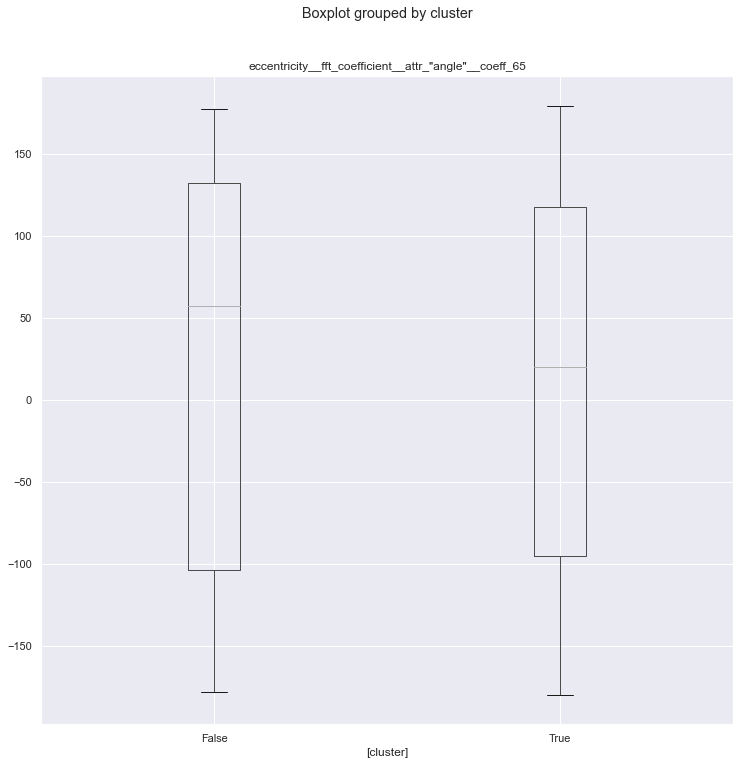

eccentricity__fft_coefficient__attr_"angle"__coeff_59


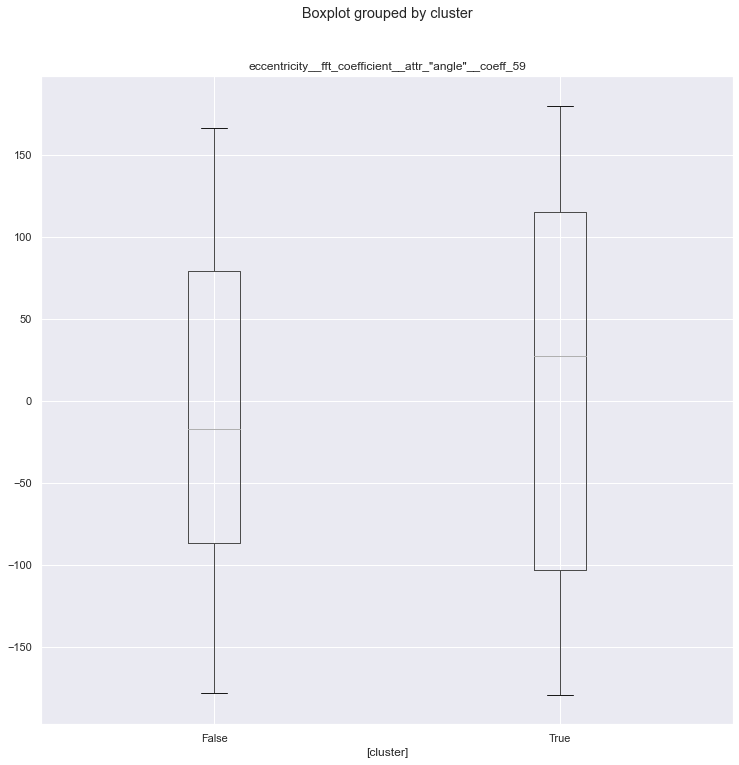

eccentricity__fft_coefficient__attr_"angle"__coeff_80


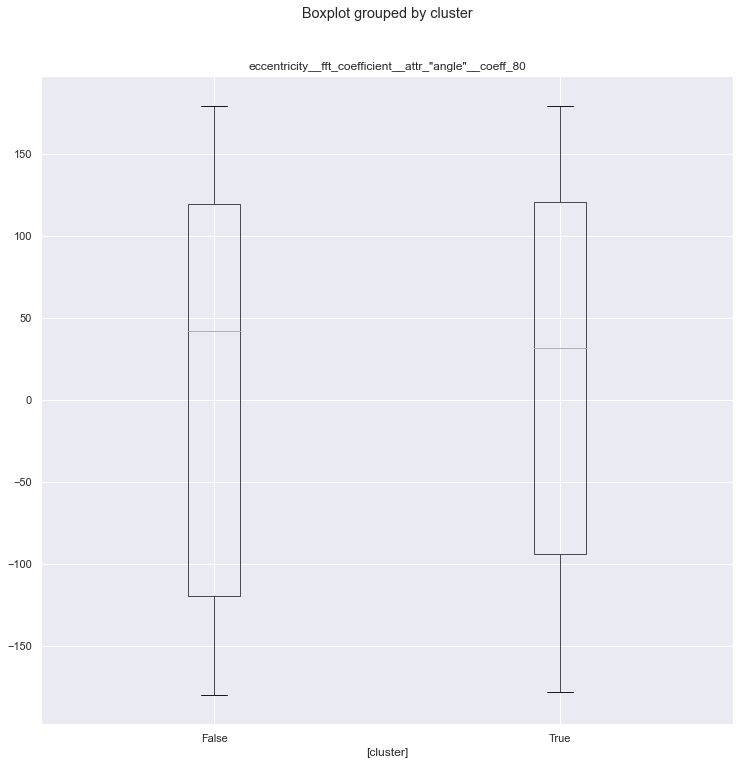

eccentricity__fft_coefficient__attr_"real"__coeff_63


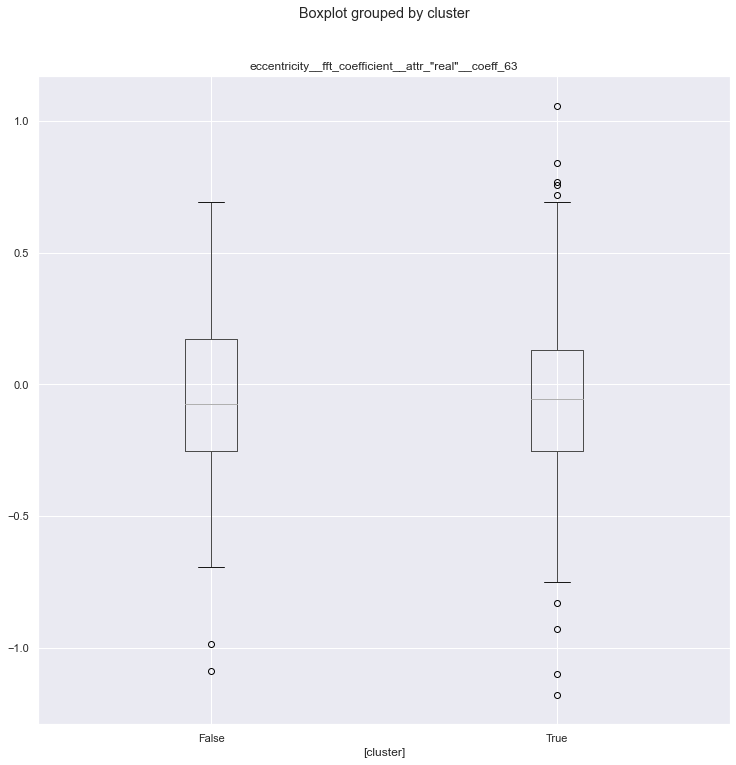

eccentricity__fft_coefficient__attr_"real"__coeff_37


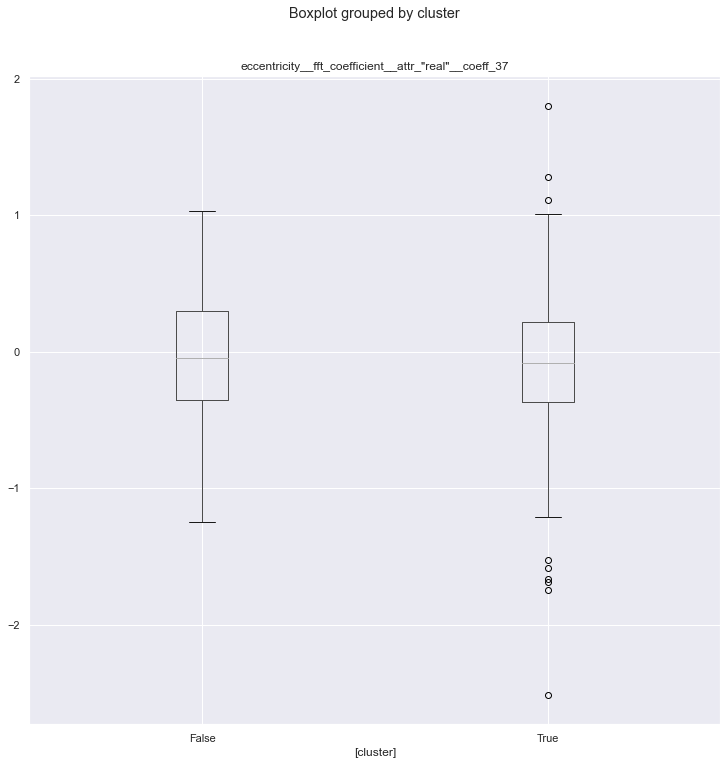

eccentricity__fft_coefficient__attr_"real"__coeff_32


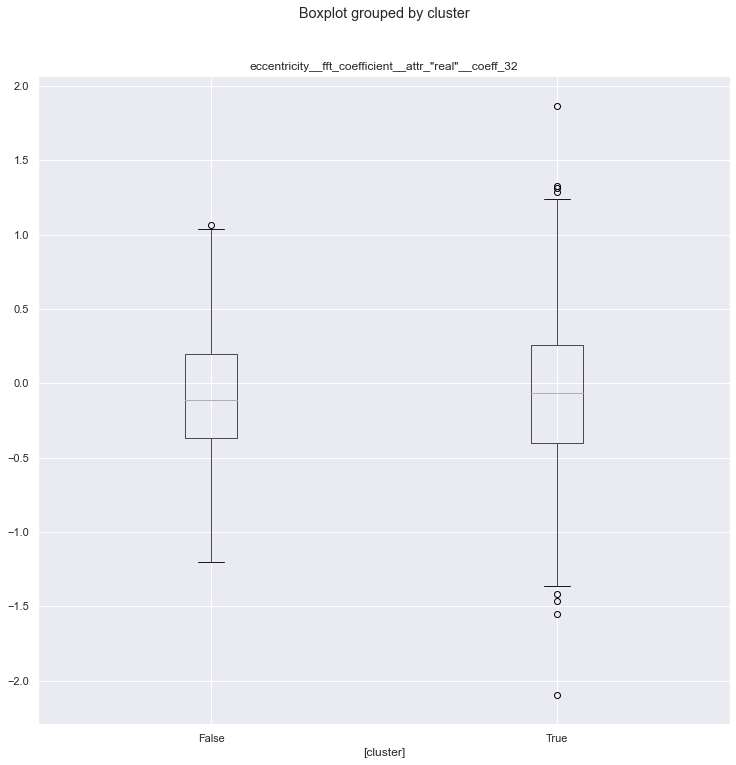

minor_axis_length__fft_coefficient__attr_"imag"__coeff_15


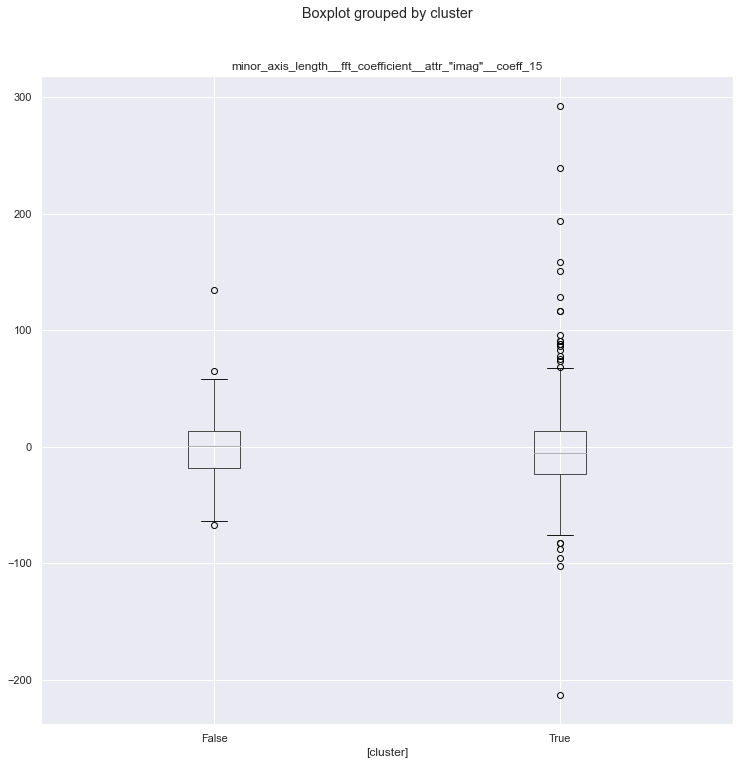

minor_axis_length__fft_coefficient__attr_"real"__coeff_16


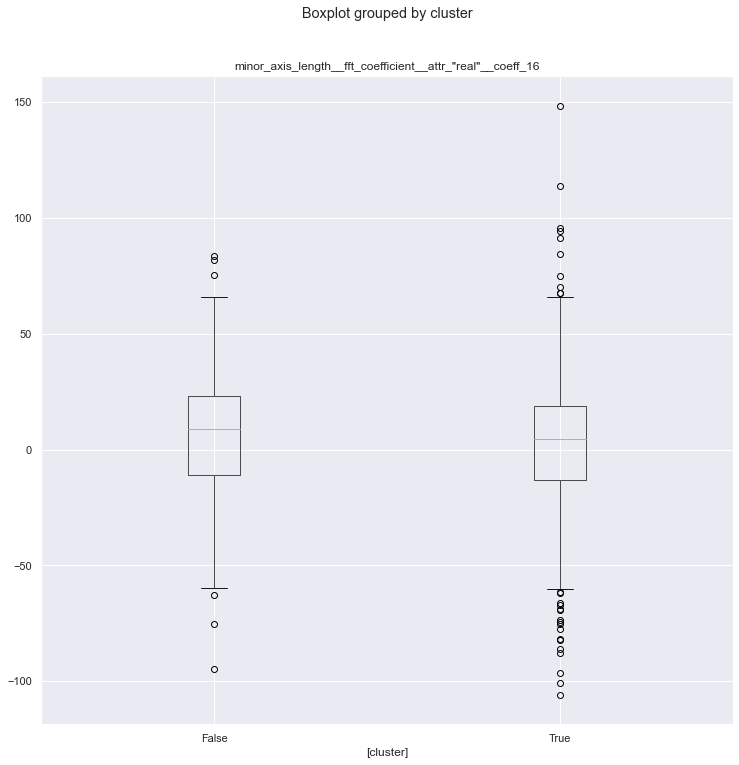

area__fft_coefficient__attr_"angle"__coeff_18


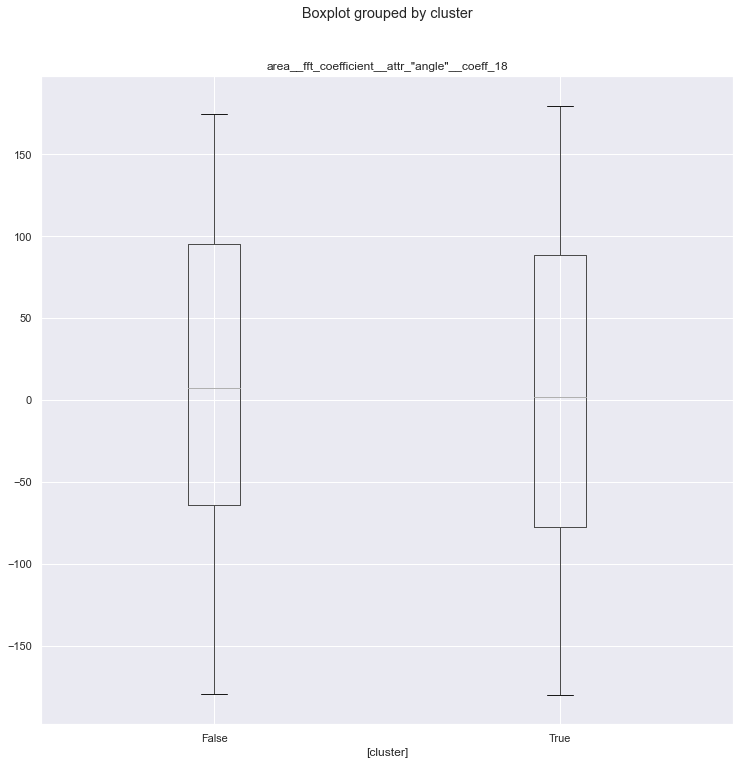

area__fft_coefficient__attr_"imag"__coeff_82


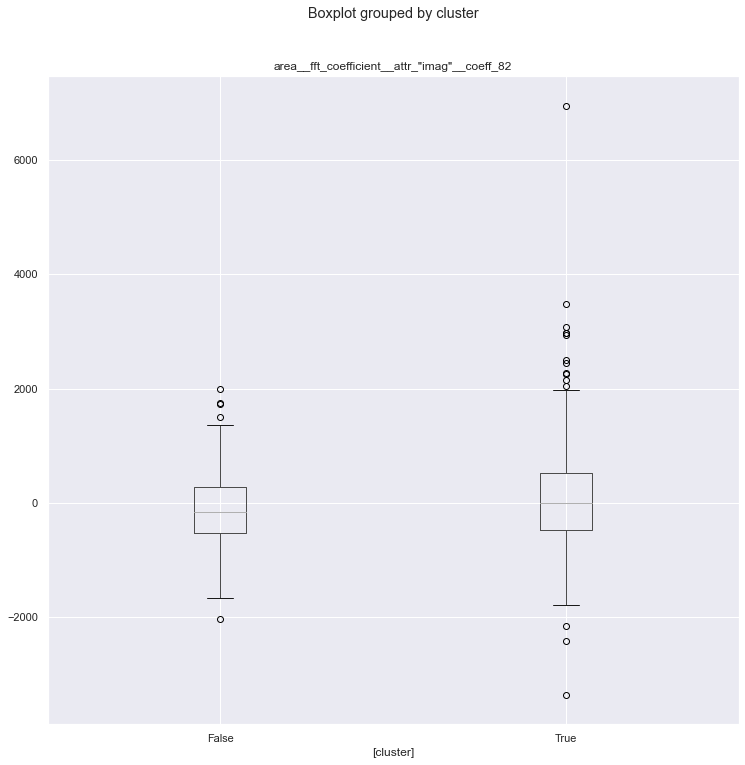

area__fft_coefficient__attr_"angle"__coeff_62


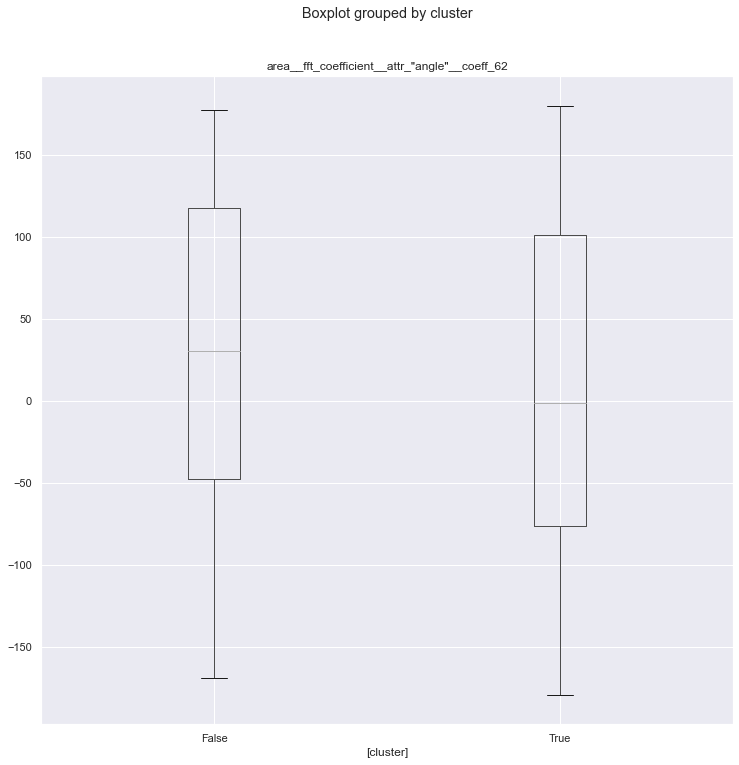

area__fft_coefficient__attr_"real"__coeff_23


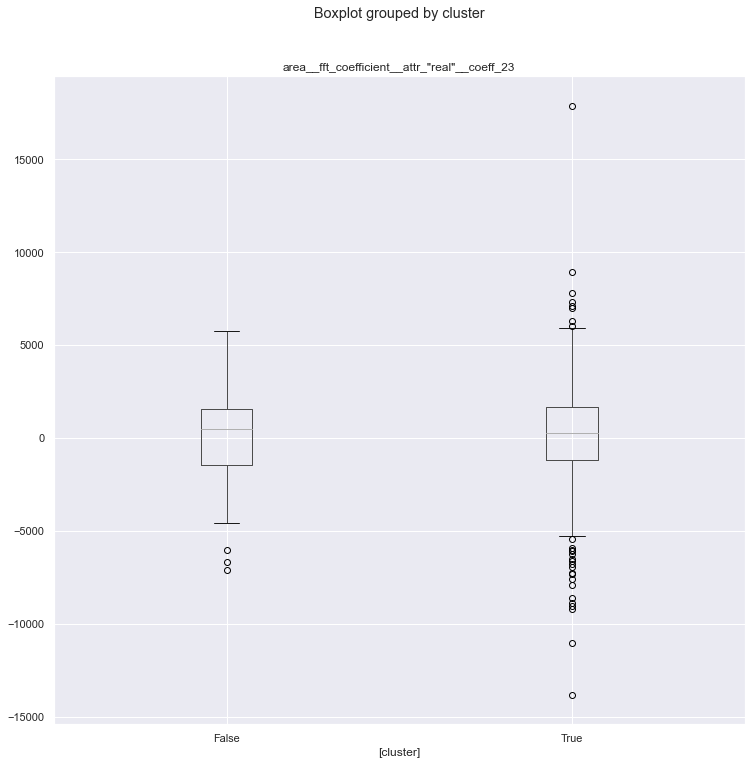

area__fft_coefficient__attr_"imag"__coeff_47


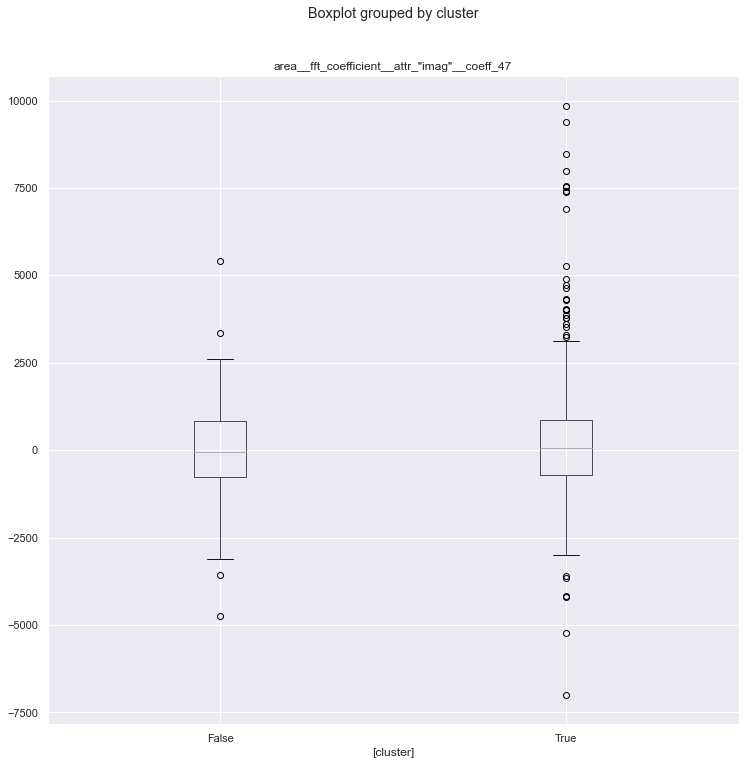

area_diff__fft_coefficient__attr_"angle"__coeff_48


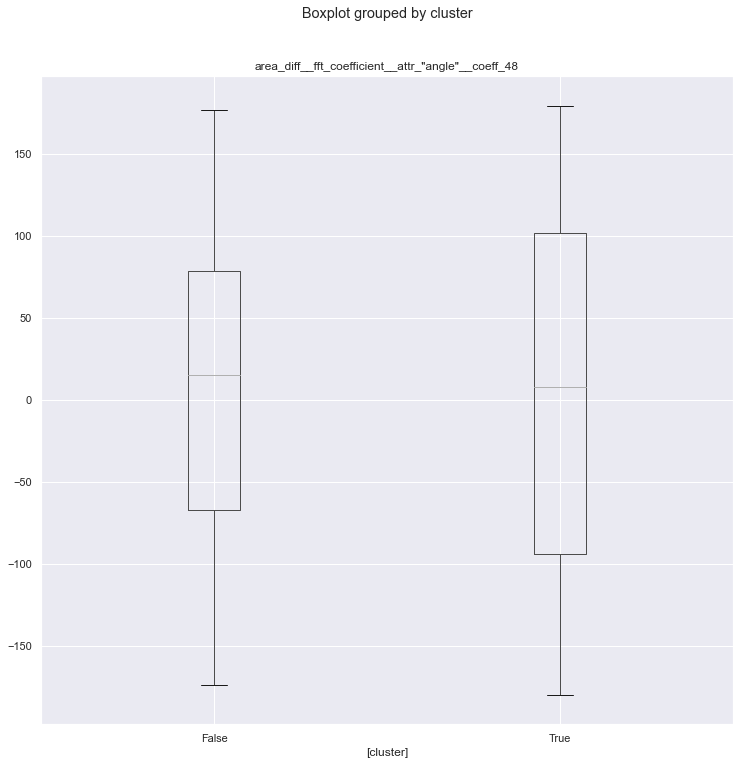

area_diff__fft_coefficient__attr_"real"__coeff_2


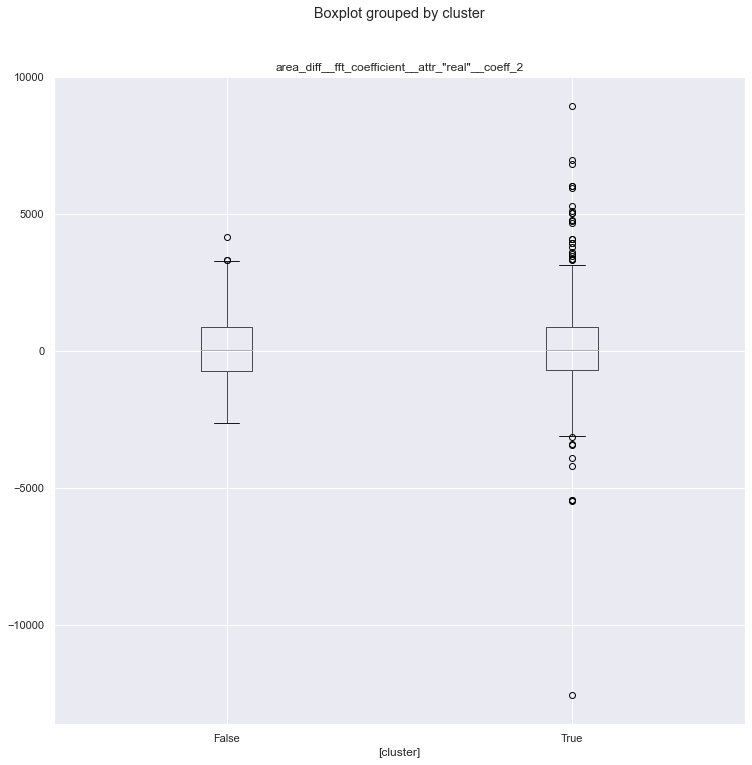

area_diff__fft_coefficient__attr_"angle"__coeff_66


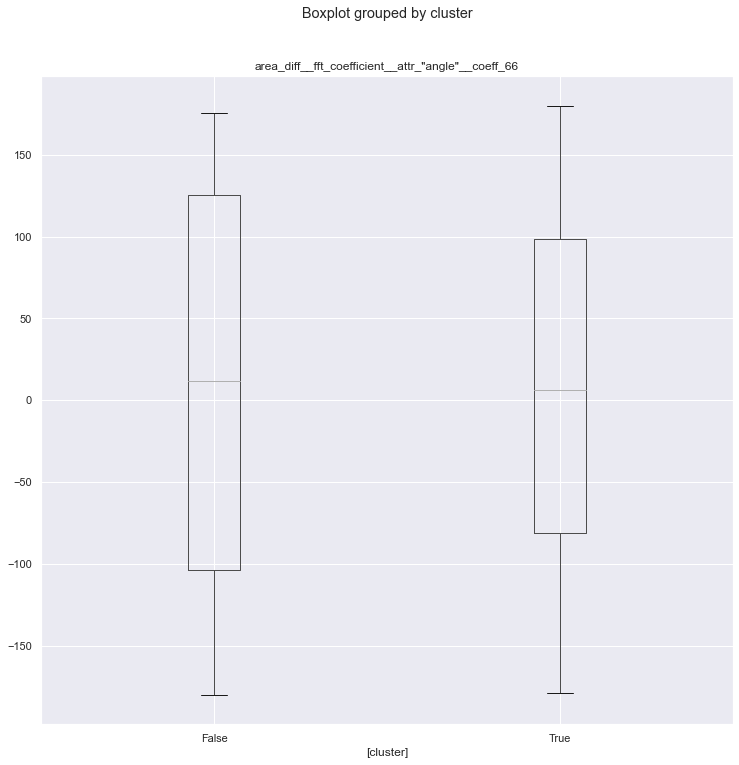

area_diff__fft_coefficient__attr_"imag"__coeff_68


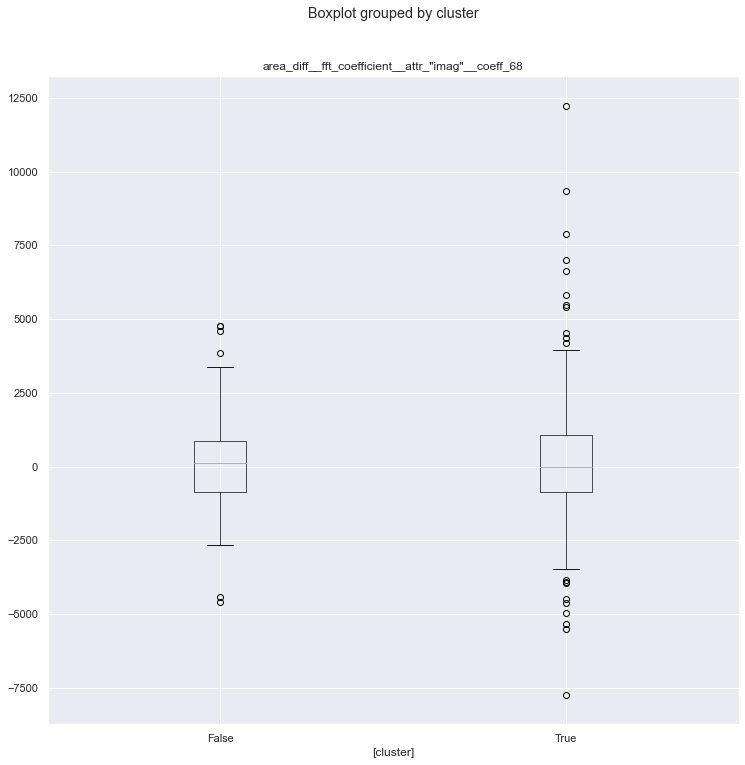

area_diff__c3__lag_2


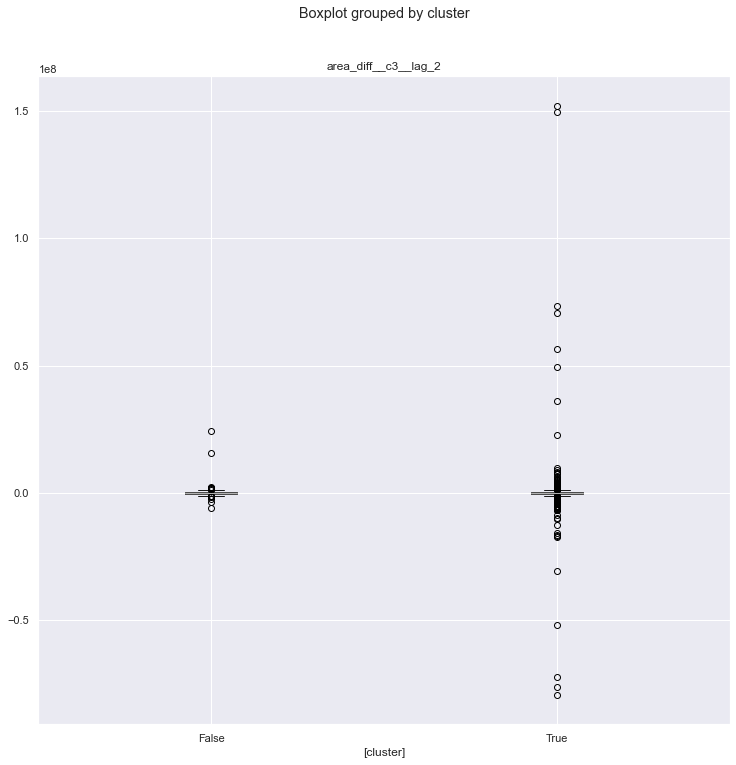

solidity_diff__cwt_coefficients__coeff_1__w_2__widths_(2, 5, 10, 20)


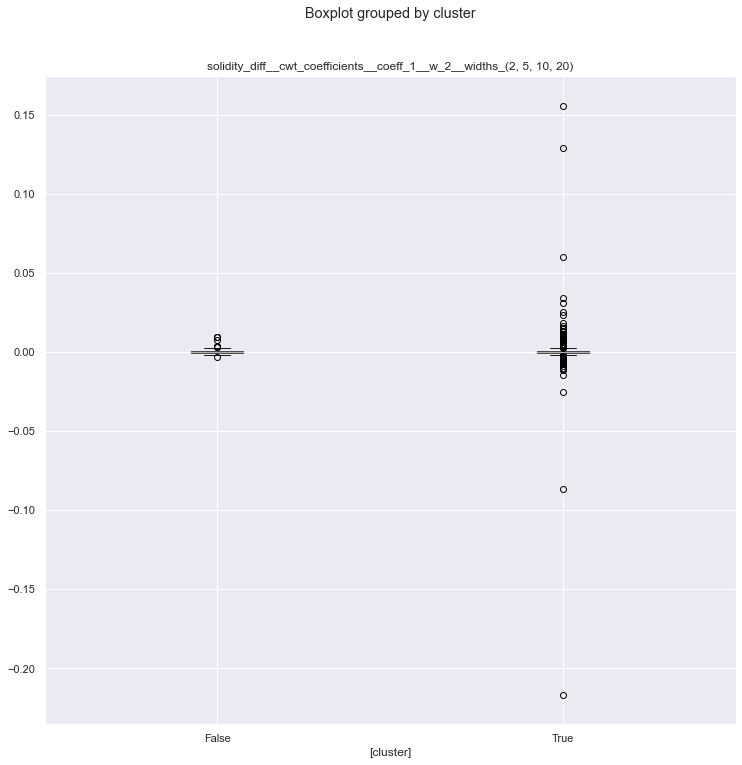

solidity_diff__fft_coefficient__attr_"real"__coeff_32


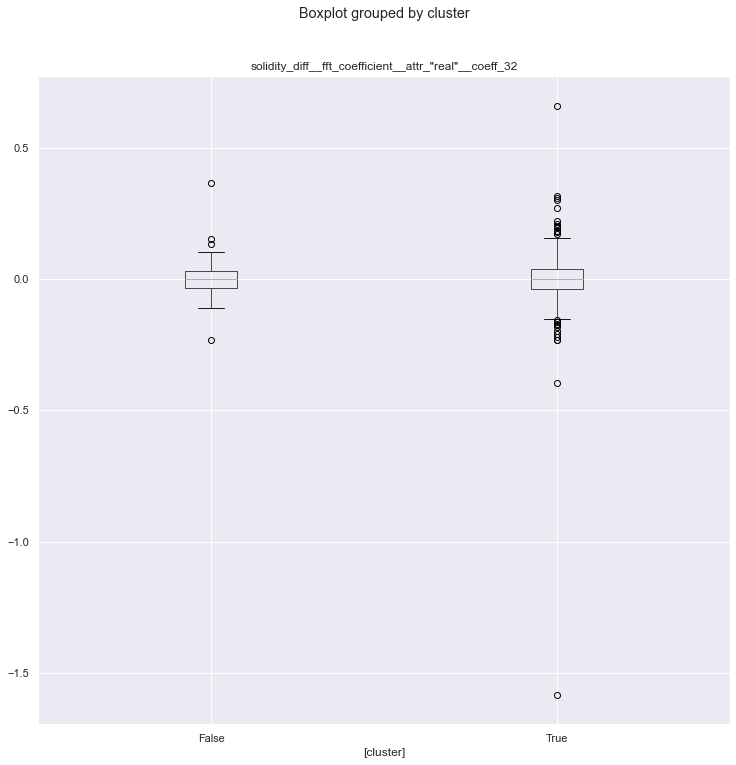

solidity_diff__fft_coefficient__attr_"real"__coeff_14


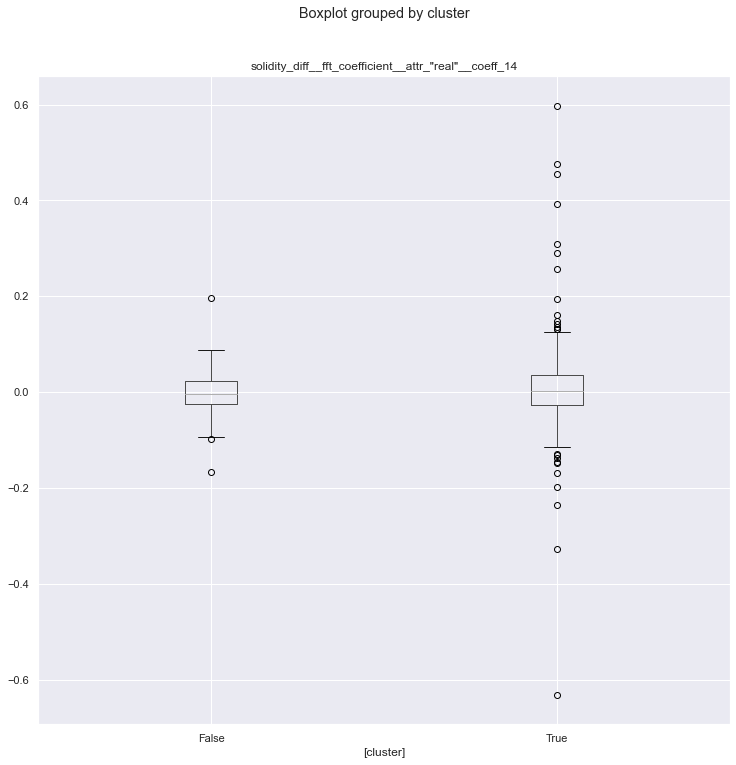

solidity_diff__fft_coefficient__attr_"angle"__coeff_62


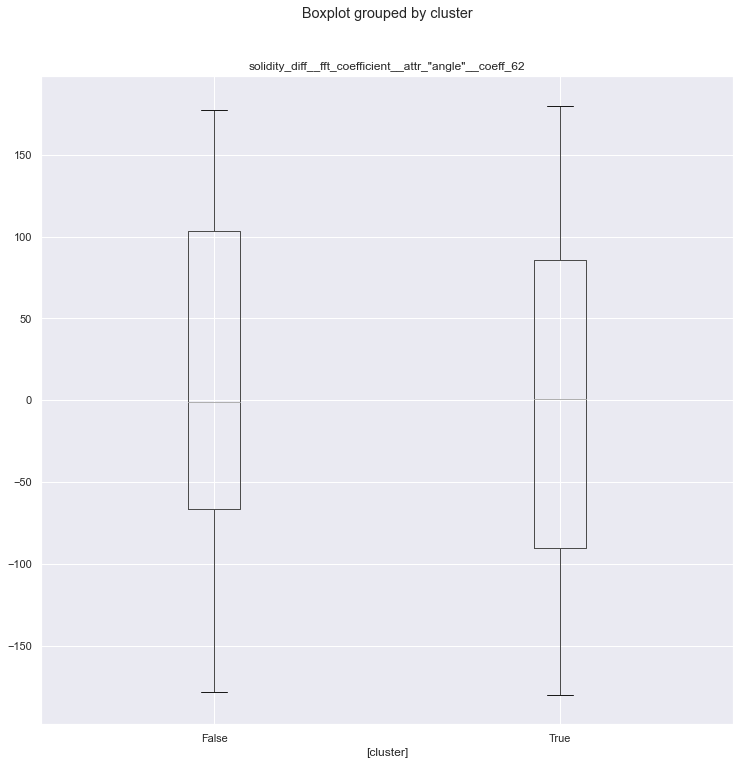

solidity_diff__fft_coefficient__attr_"angle"__coeff_40


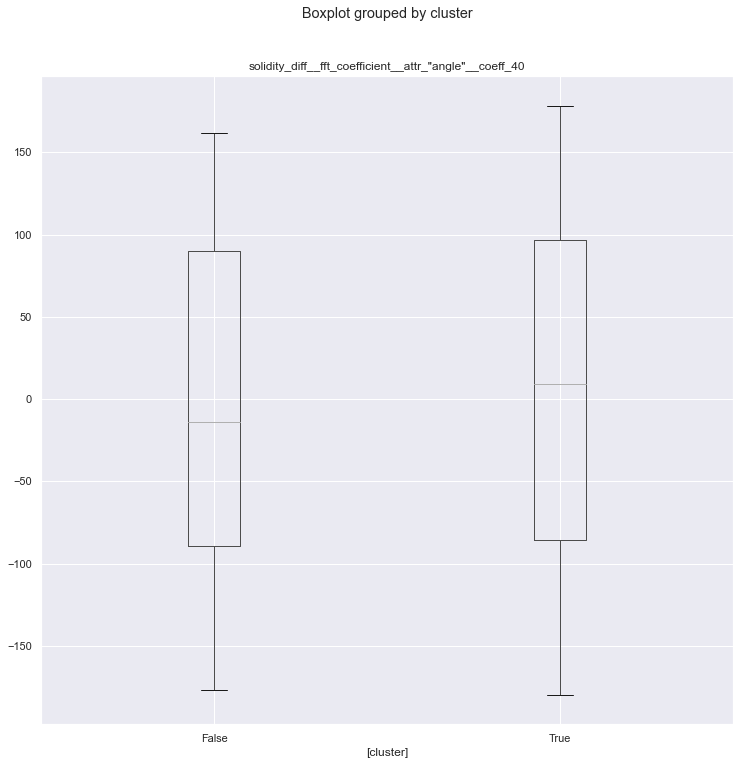

solidity_diff__fft_coefficient__attr_"real"__coeff_42


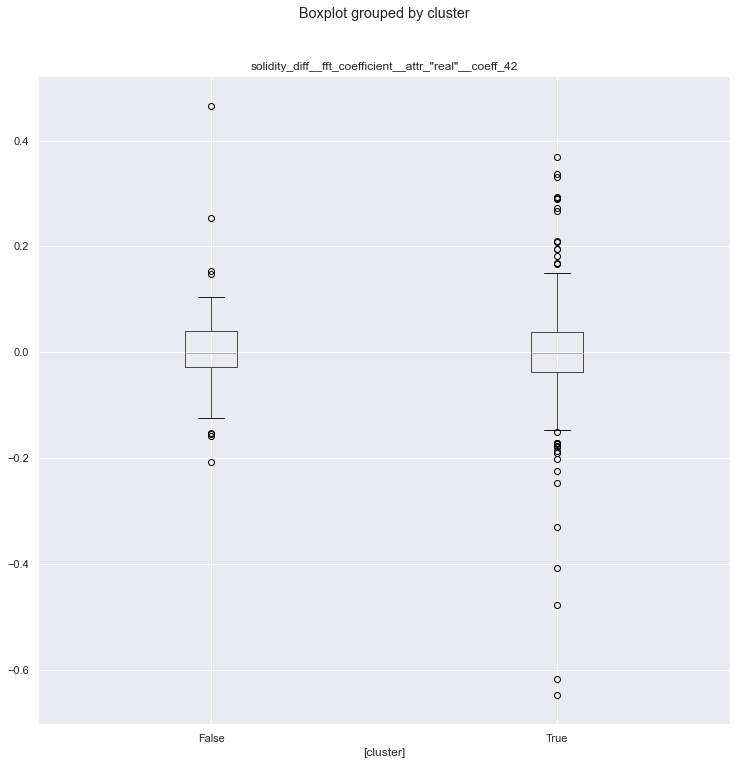

solidity_diff__fft_coefficient__attr_"angle"__coeff_55


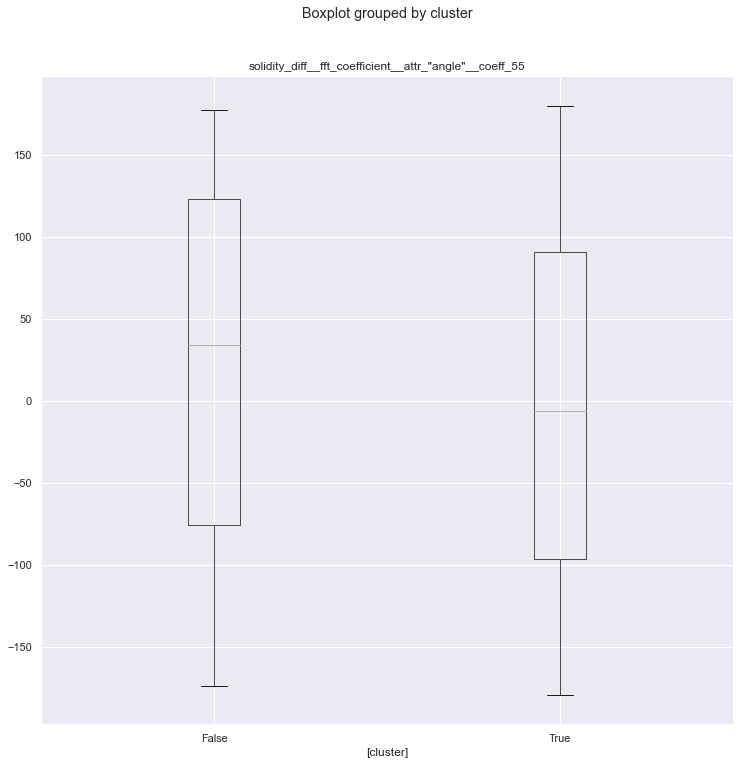

solidity_diff__variation_coefficient


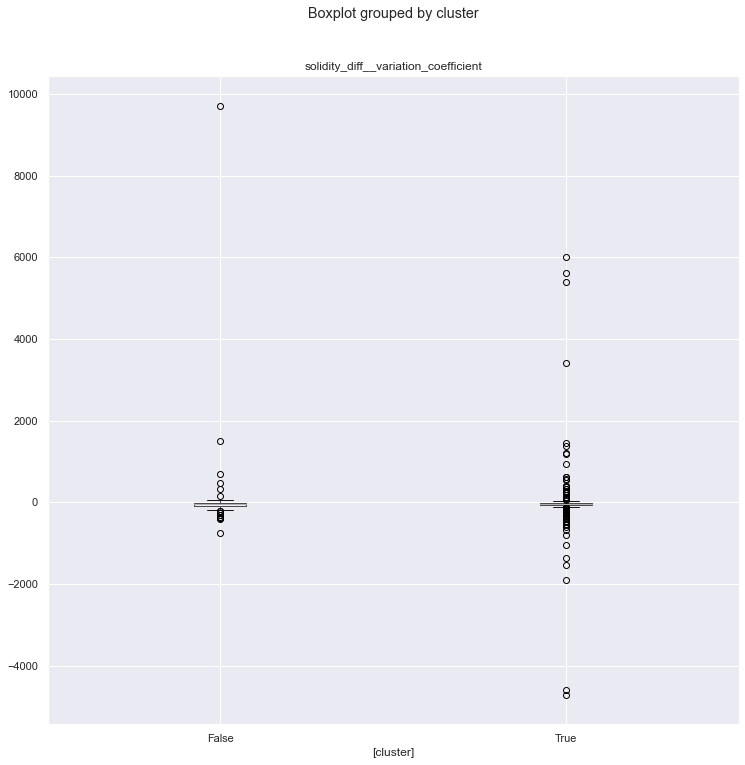

eccentricity_diff__fft_coefficient__attr_"imag"__coeff_6


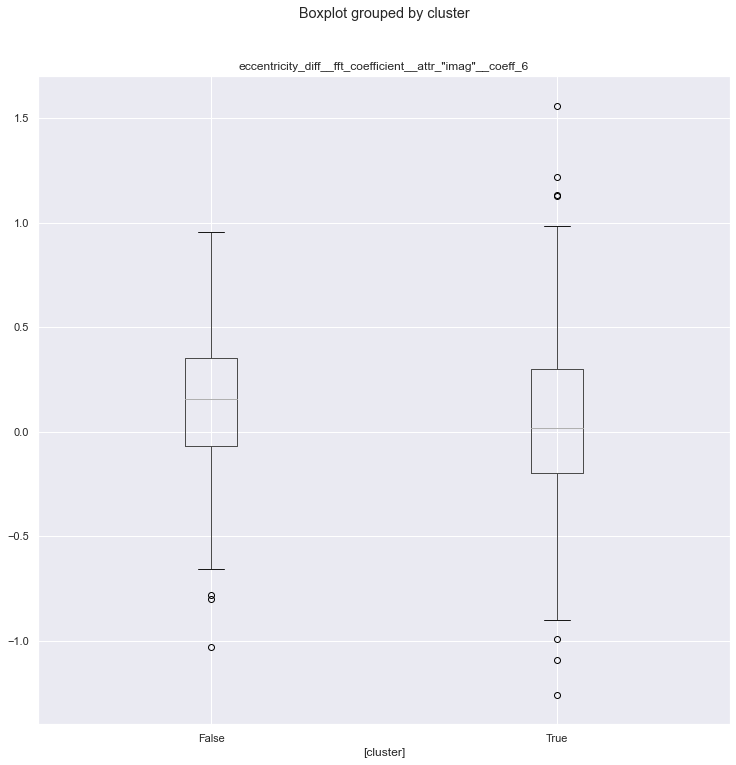

eccentricity_diff__fft_coefficient__attr_"imag"__coeff_41


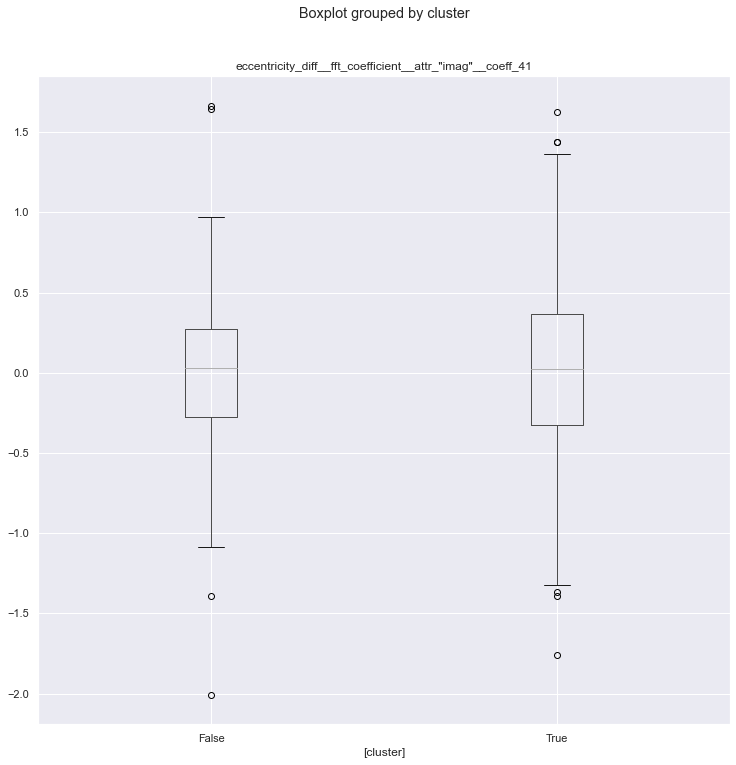

eccentricity_diff__fft_coefficient__attr_"imag"__coeff_37


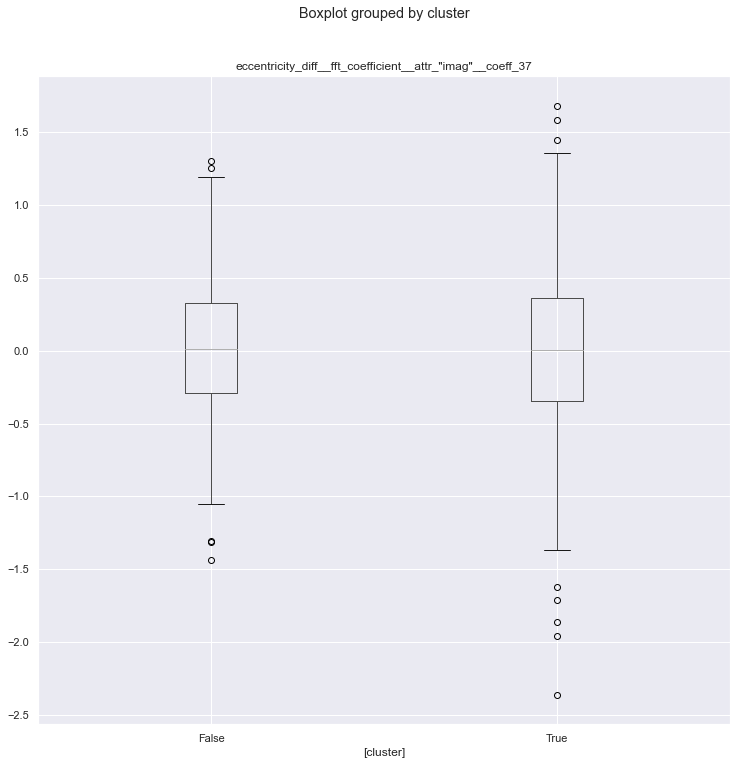

eccentricity_diff__fft_coefficient__attr_"real"__coeff_89


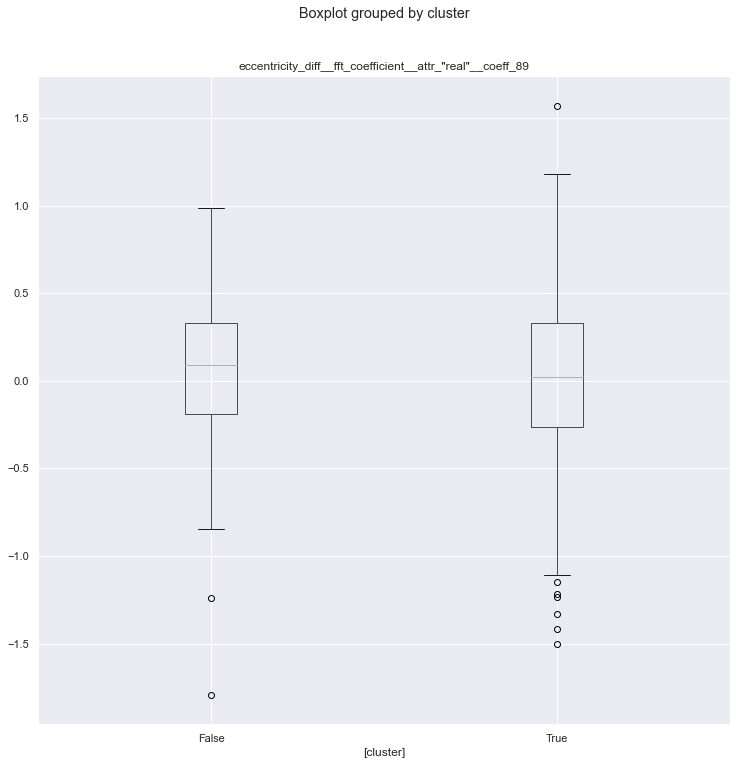

eccentricity_diff__fft_coefficient__attr_"imag"__coeff_46


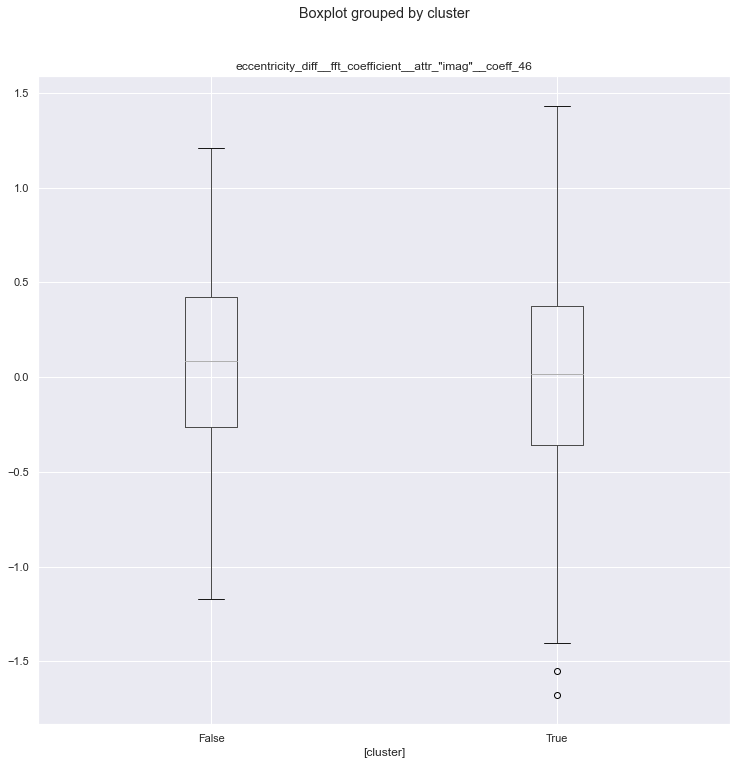

eccentricity_diff__fft_coefficient__attr_"angle"__coeff_38


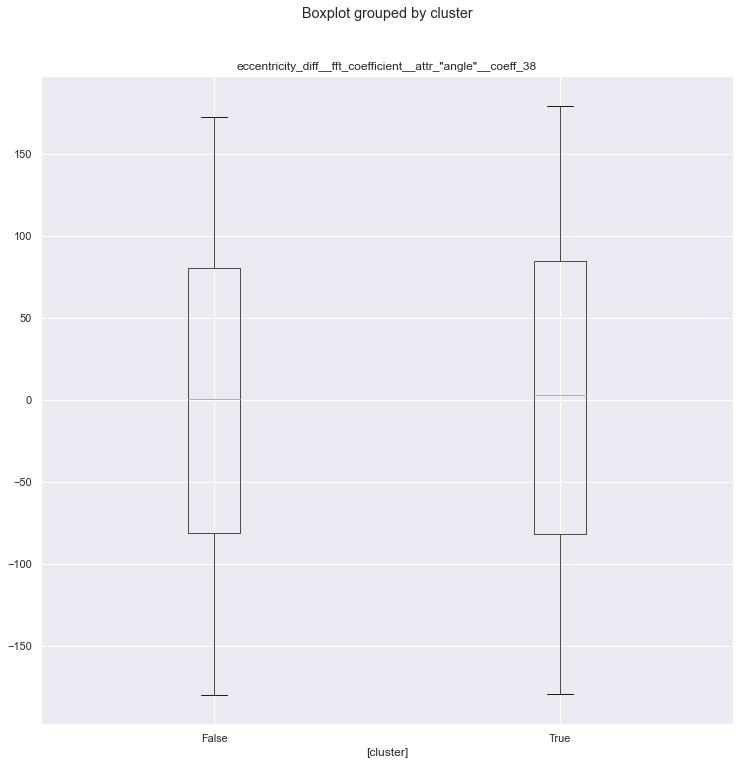

eccentricity_diff__fft_coefficient__attr_"real"__coeff_66


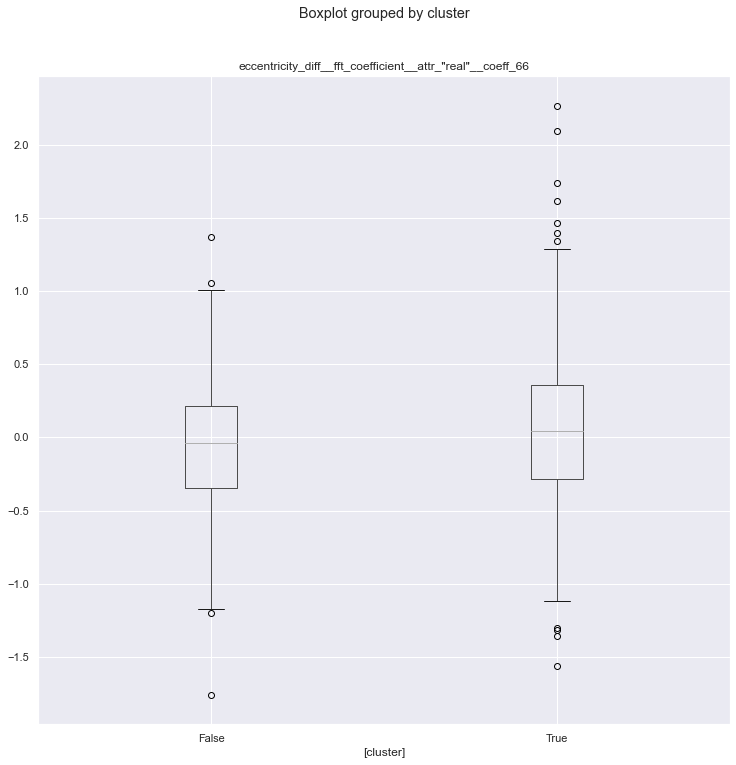

eccentricity_diff__fft_coefficient__attr_"angle"__coeff_80


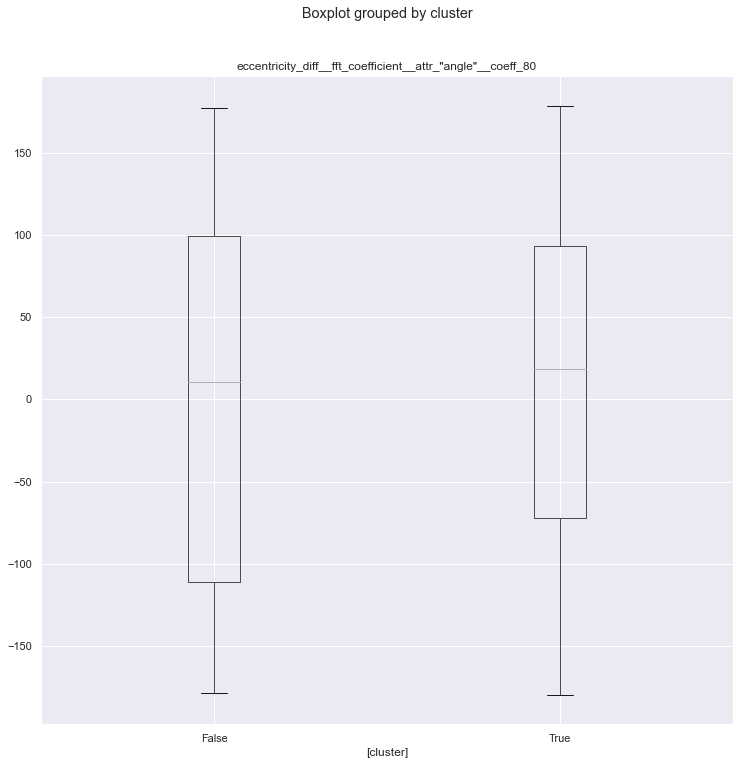

eccentricity_diff__cwt_coefficients__coeff_8__w_2__widths_(2, 5, 10, 20)


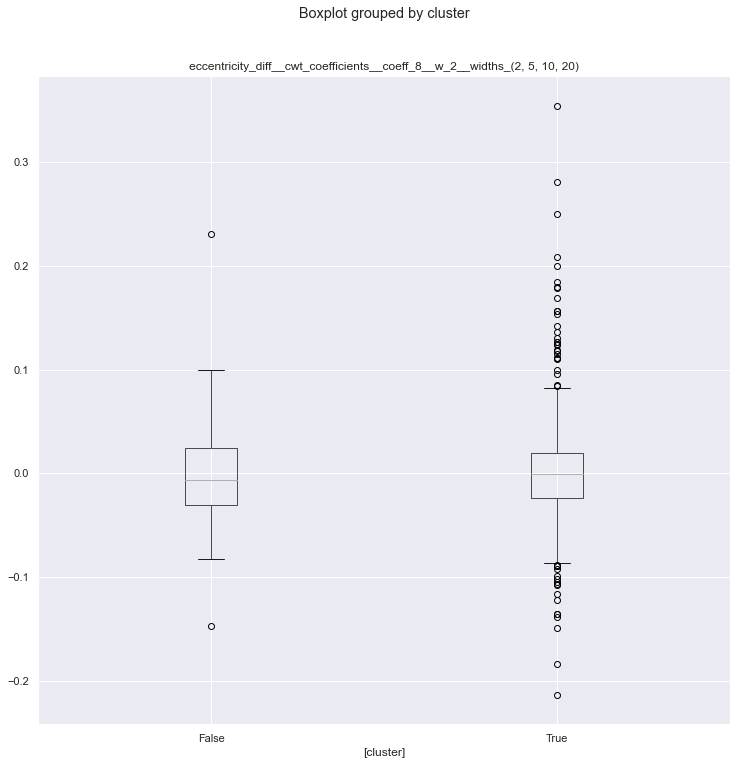

equivalent_diameter_diff__fft_coefficient__attr_"imag"__coeff_14


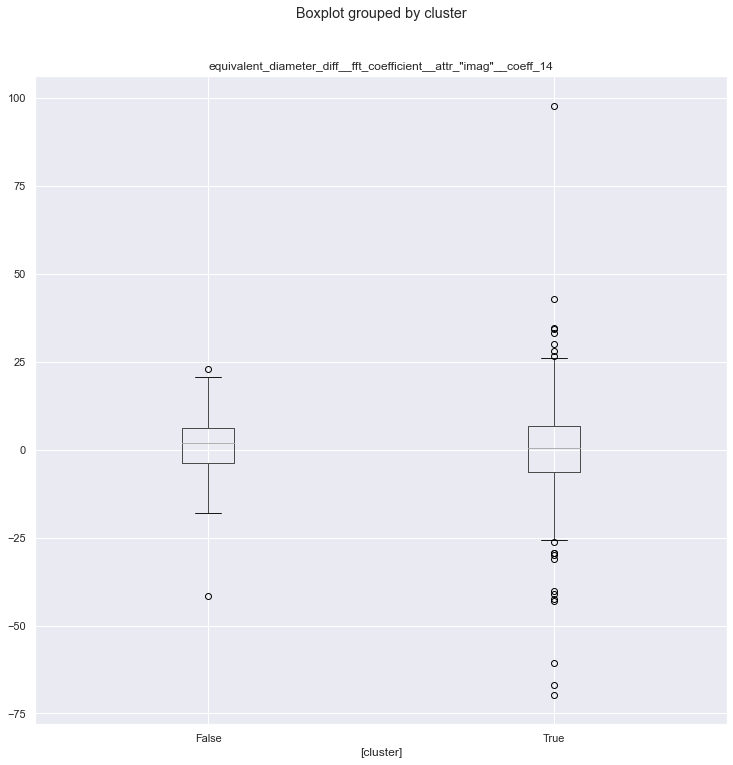

equivalent_diameter_diff__fft_coefficient__attr_"real"__coeff_69


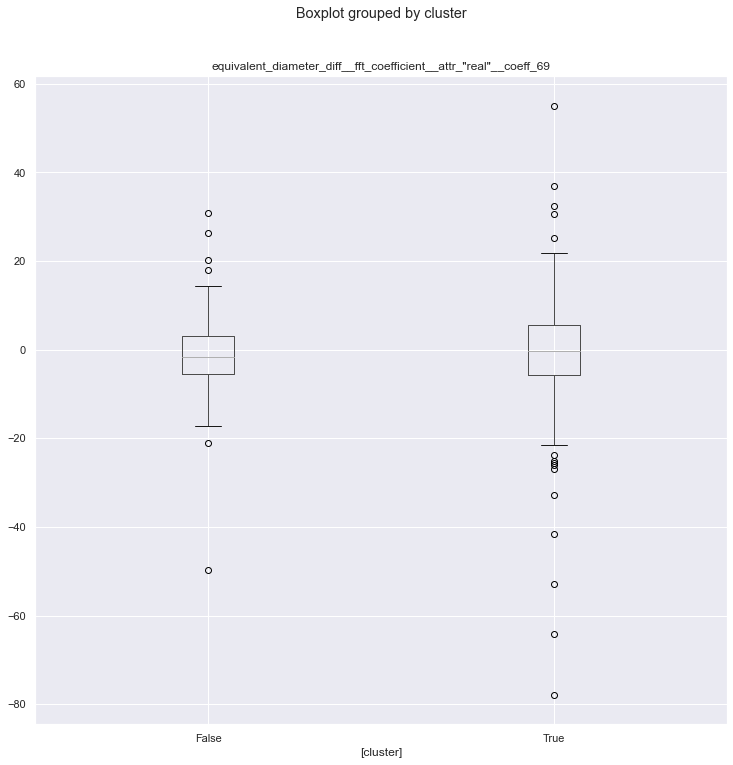

equivalent_diameter_diff__fft_coefficient__attr_"real"__coeff_67


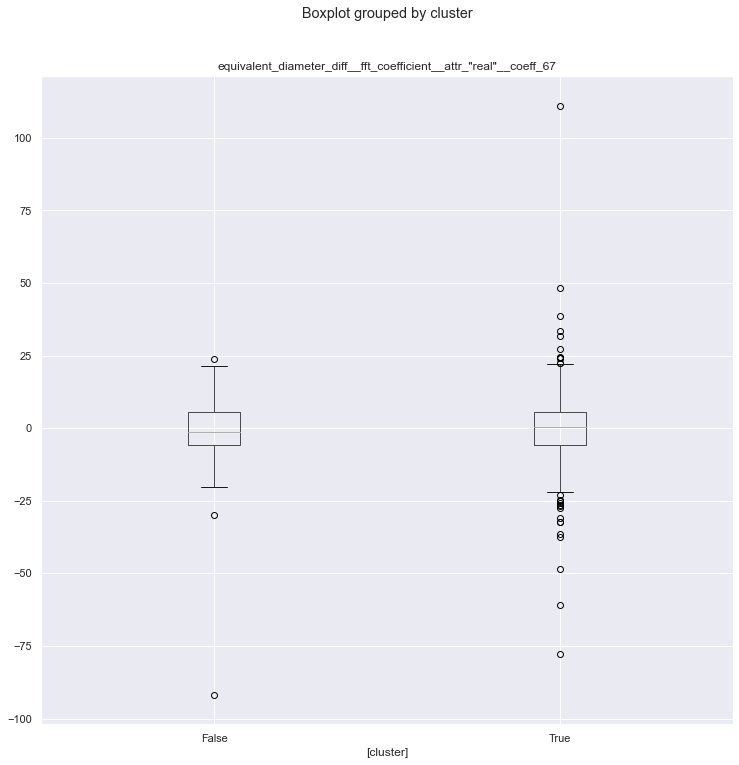

equivalent_diameter_diff__fft_coefficient__attr_"real"__coeff_33


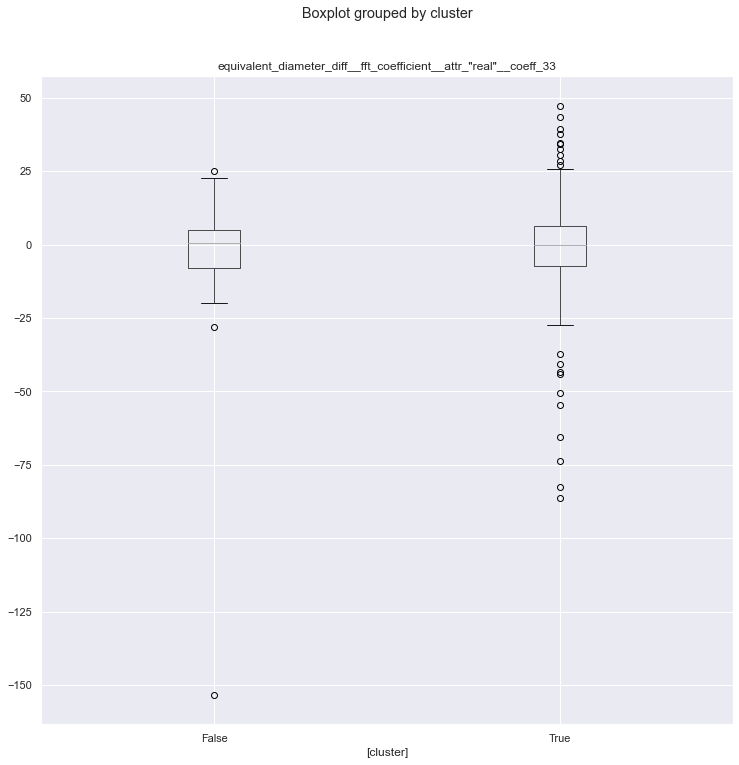

equivalent_diameter_diff__fft_coefficient__attr_"real"__coeff_25


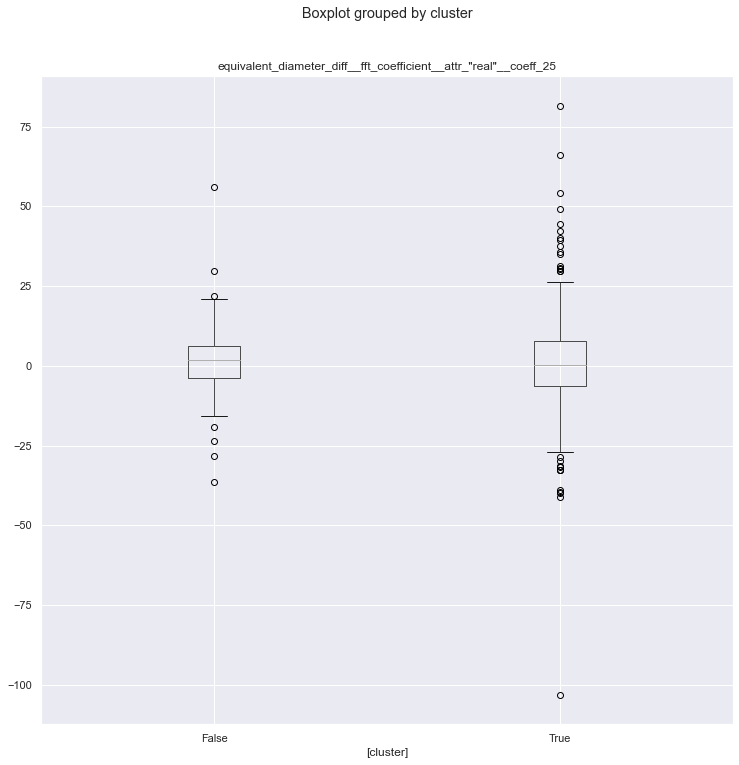

equivalent_diameter_diff__fft_coefficient__attr_"real"__coeff_16


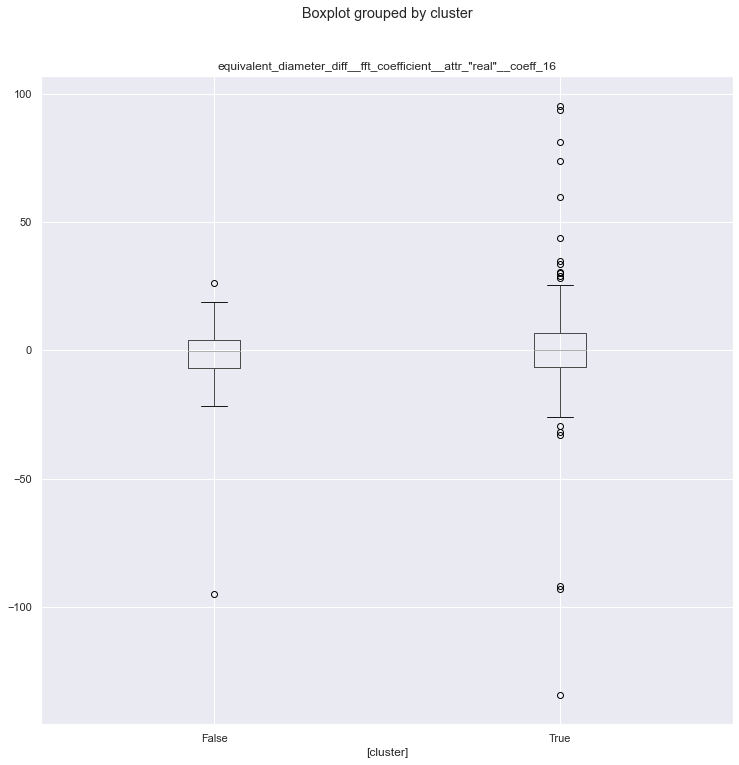

major_axis_length_diff__fft_coefficient__attr_"real"__coeff_20


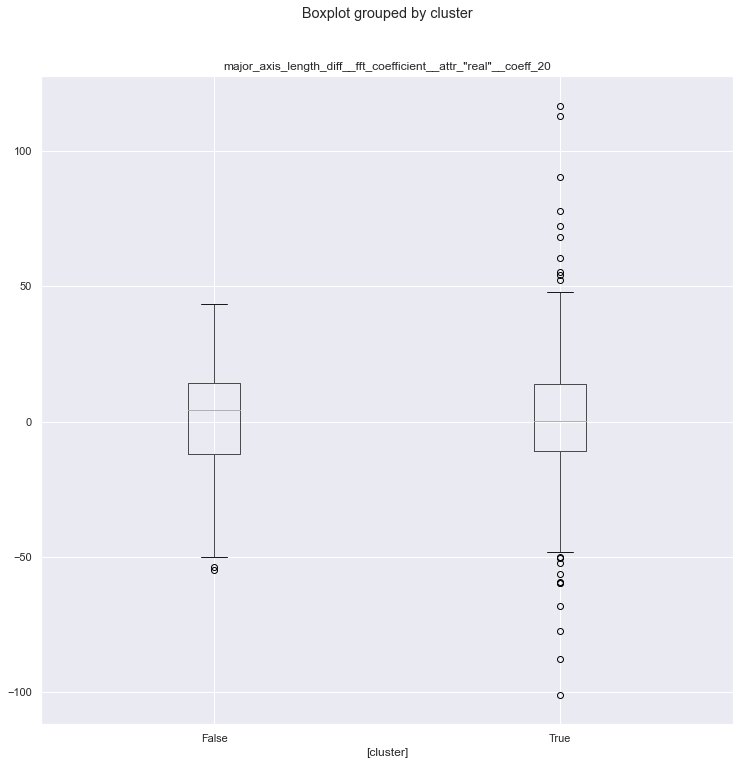

major_axis_length_diff__fft_coefficient__attr_"real"__coeff_24


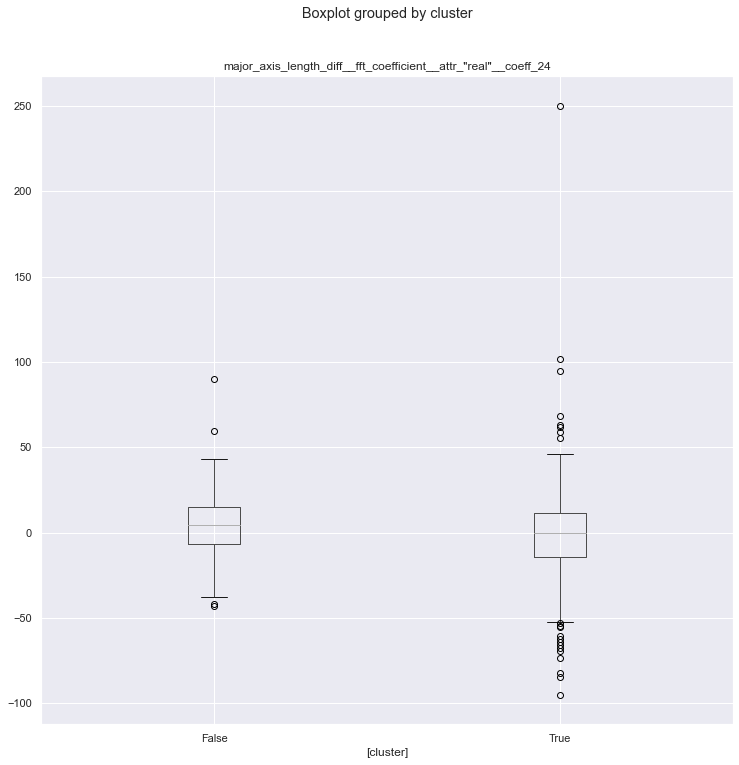

major_axis_length_diff__fft_coefficient__attr_"real"__coeff_30


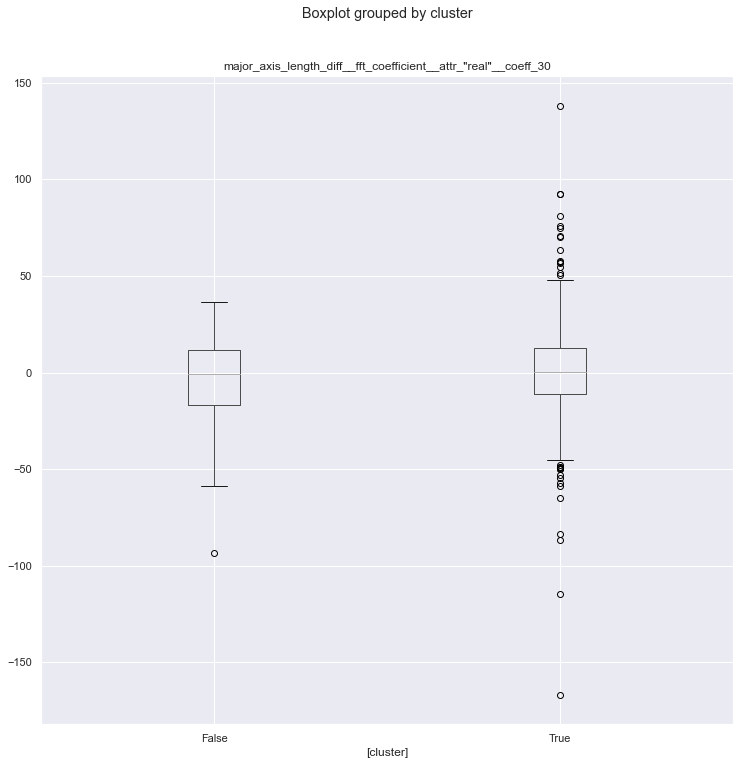

major_axis_length_diff__fft_coefficient__attr_"real"__coeff_51


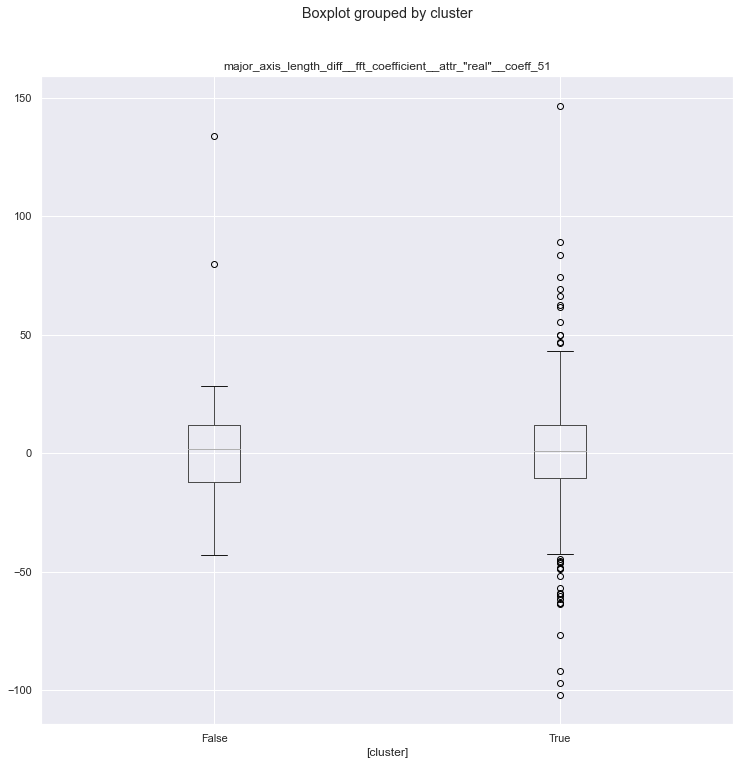

major_axis_length_diff__fft_coefficient__attr_"angle"__coeff_32


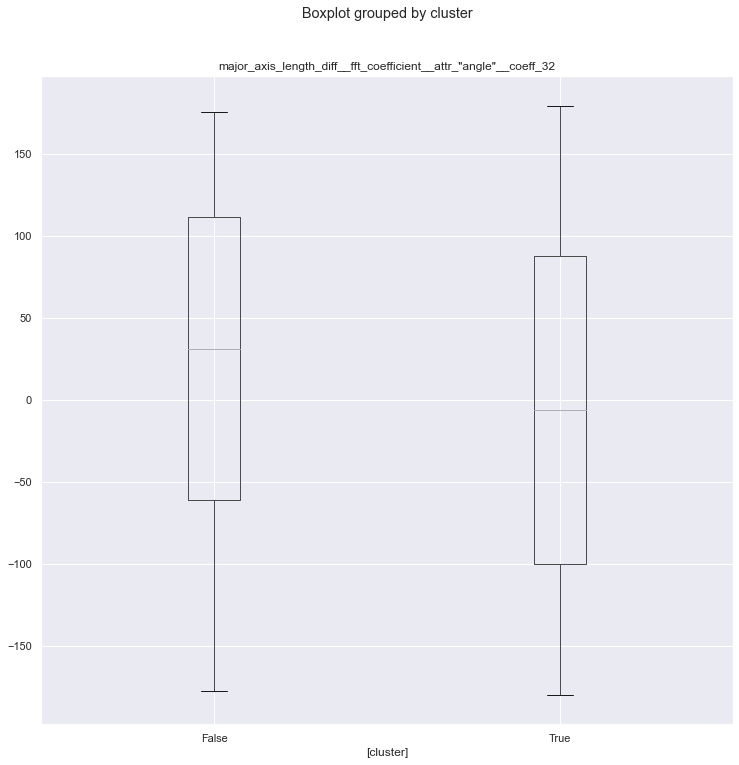

major_axis_length_diff__fft_coefficient__attr_"angle"__coeff_45


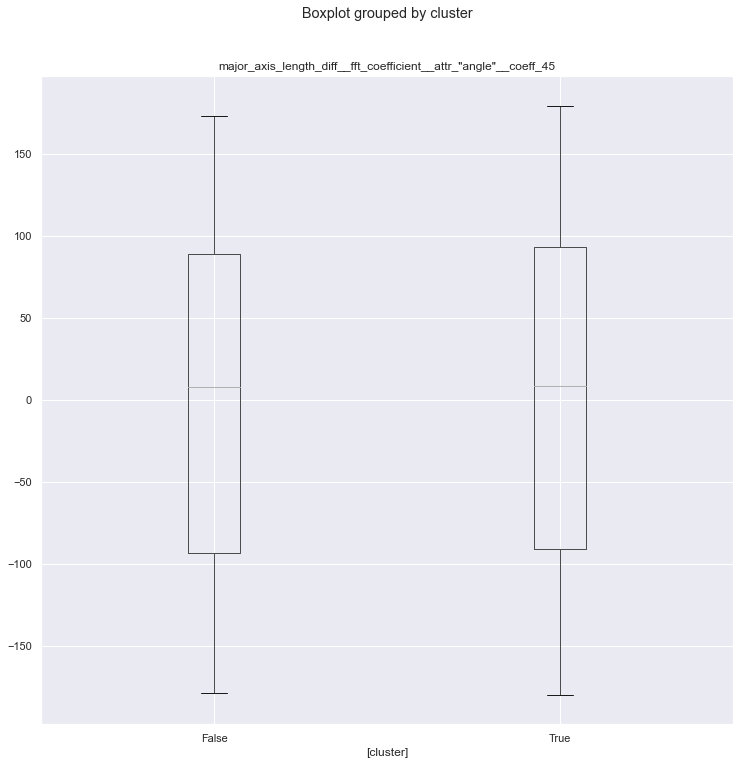

major_axis_length_diff__fft_coefficient__attr_"angle"__coeff_54


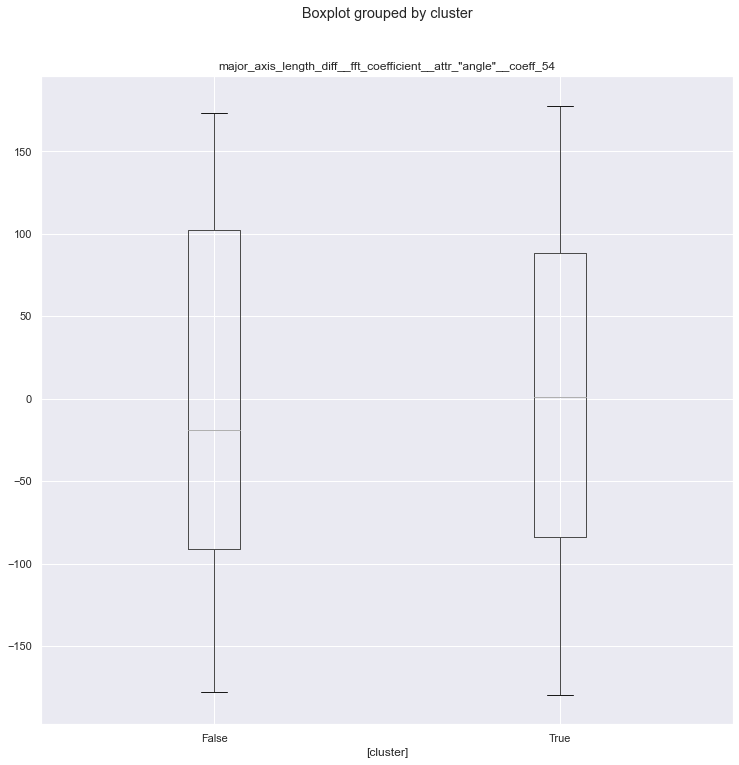

major_axis_length_diff__variation_coefficient


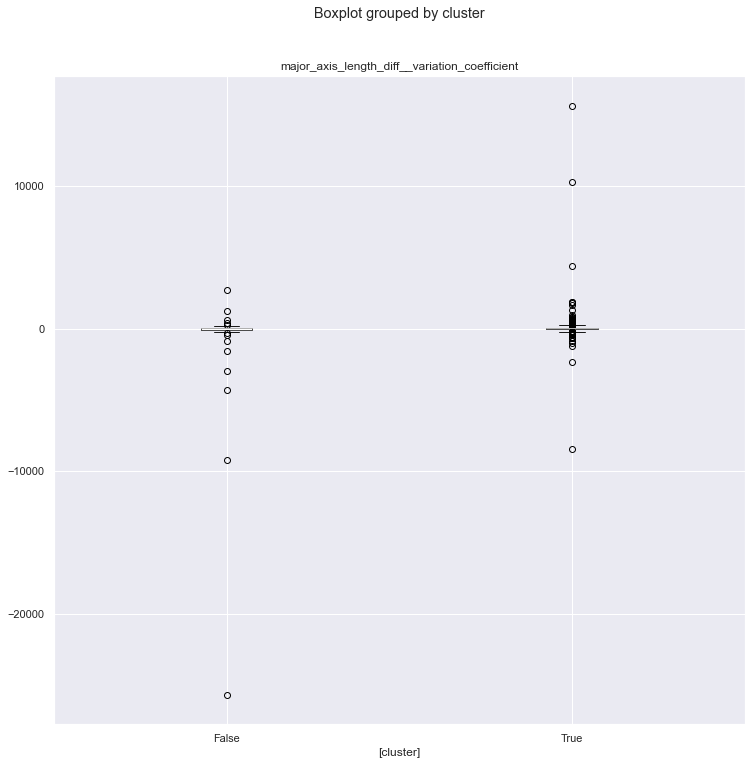

minor_axis_length_diff__fft_coefficient__attr_"angle"__coeff_67


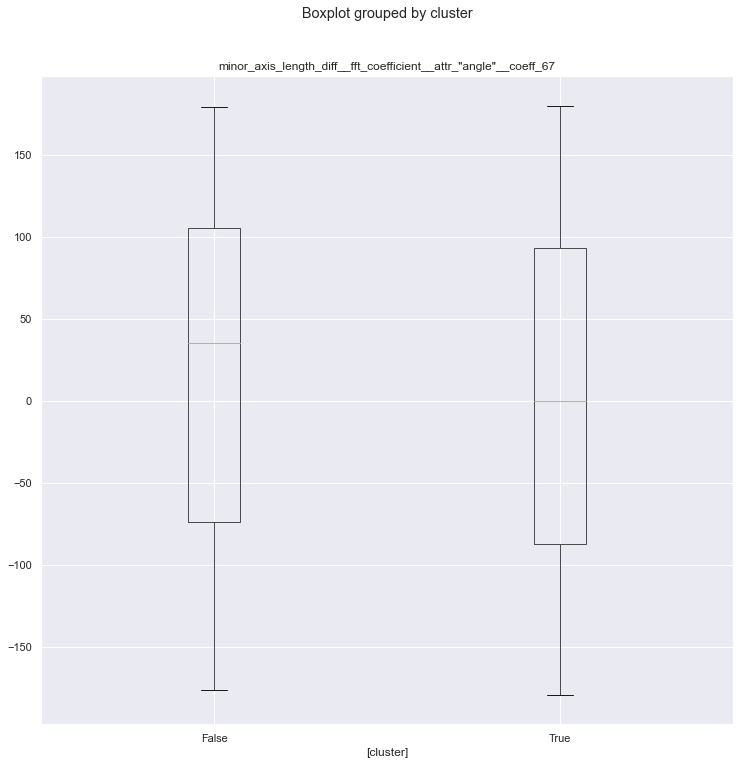

minor_axis_length_diff__fft_coefficient__attr_"imag"__coeff_62


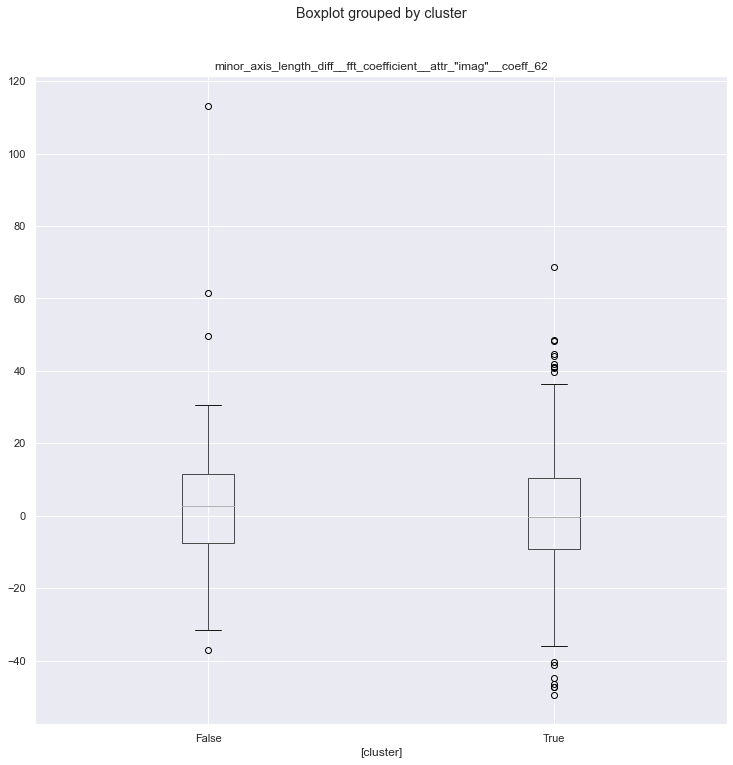

minor_axis_length_diff__fft_coefficient__attr_"angle"__coeff_65


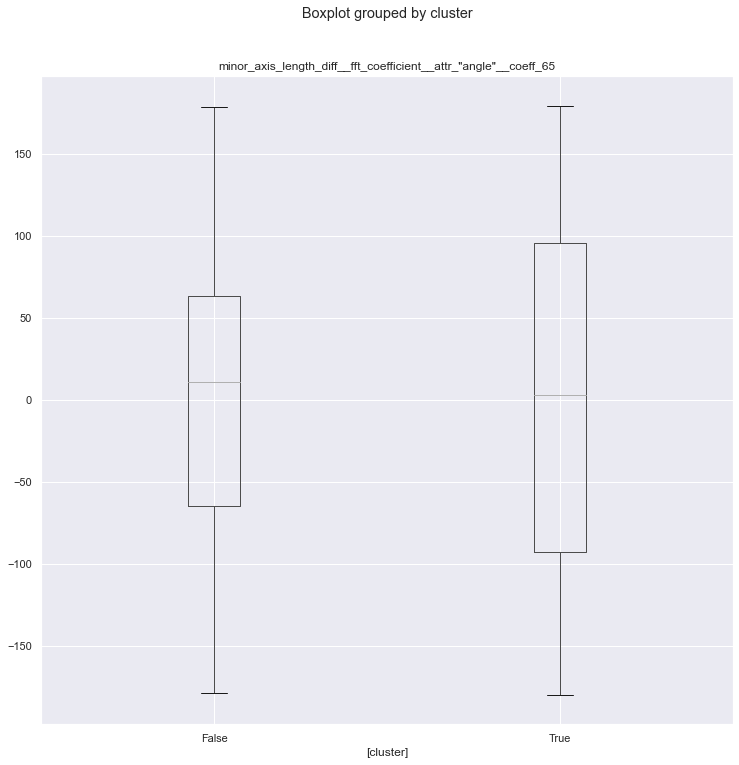

minor_axis_length_diff__fft_coefficient__attr_"real"__coeff_81


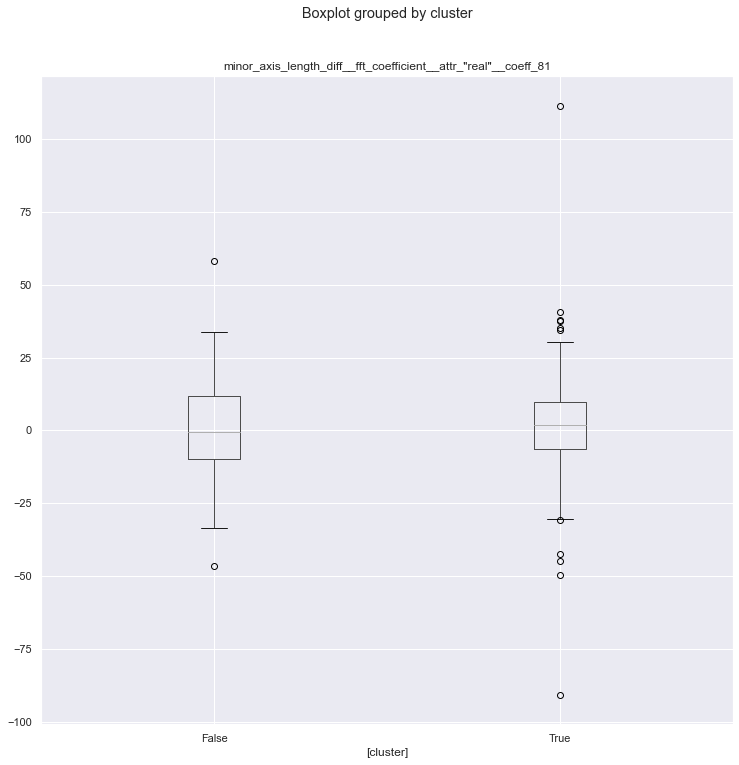

minor_axis_length_diff__fft_coefficient__attr_"angle"__coeff_39


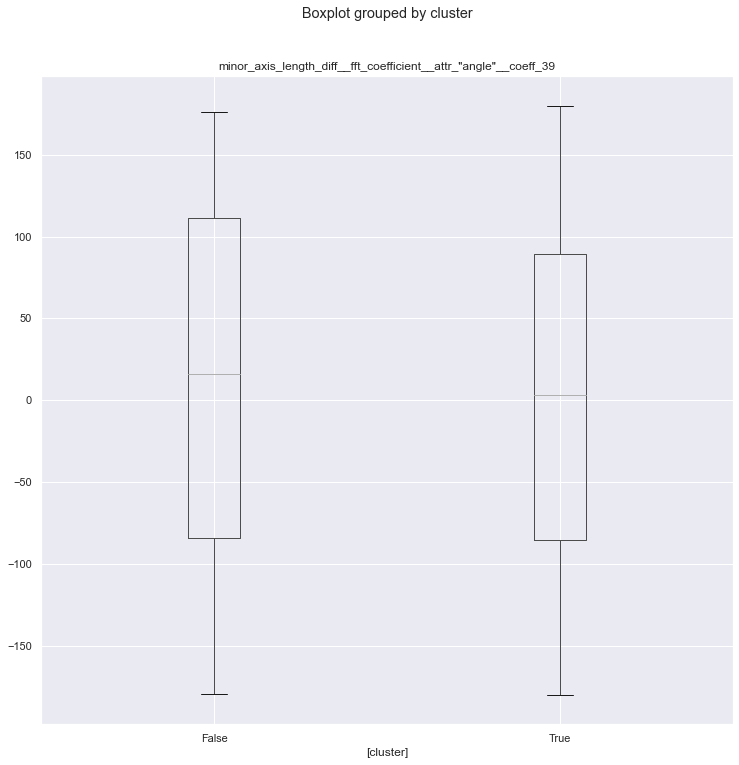

minor_axis_length_diff__fft_coefficient__attr_"angle"__coeff_12


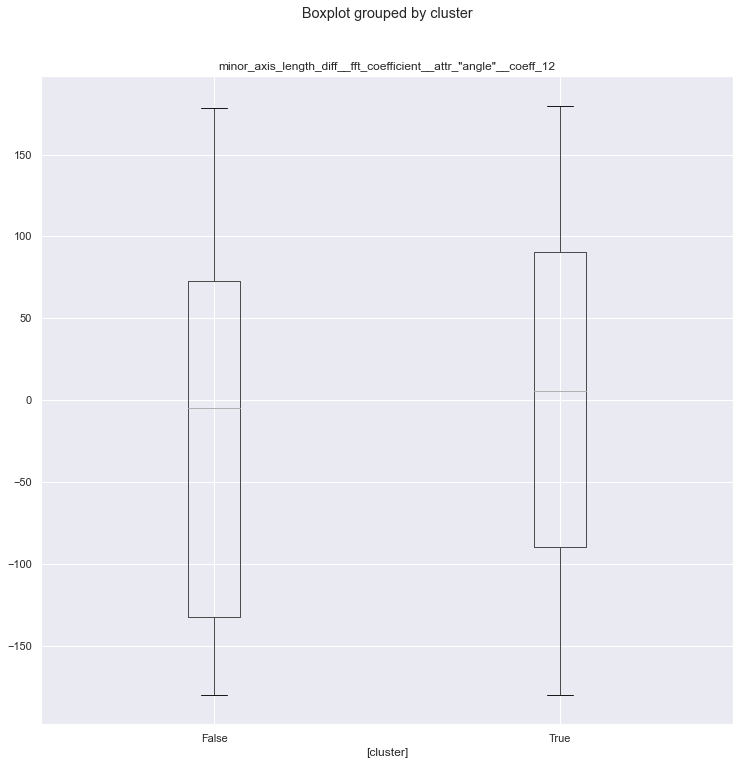

minor_axis_length_diff__fft_coefficient__attr_"angle"__coeff_1


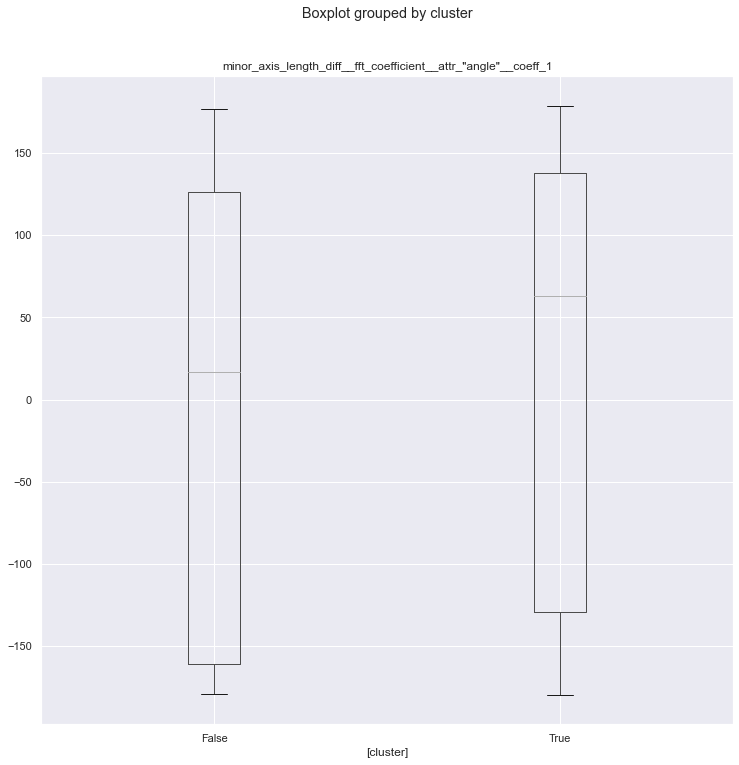

minor_axis_length_diff__fft_coefficient__attr_"angle"__coeff_17


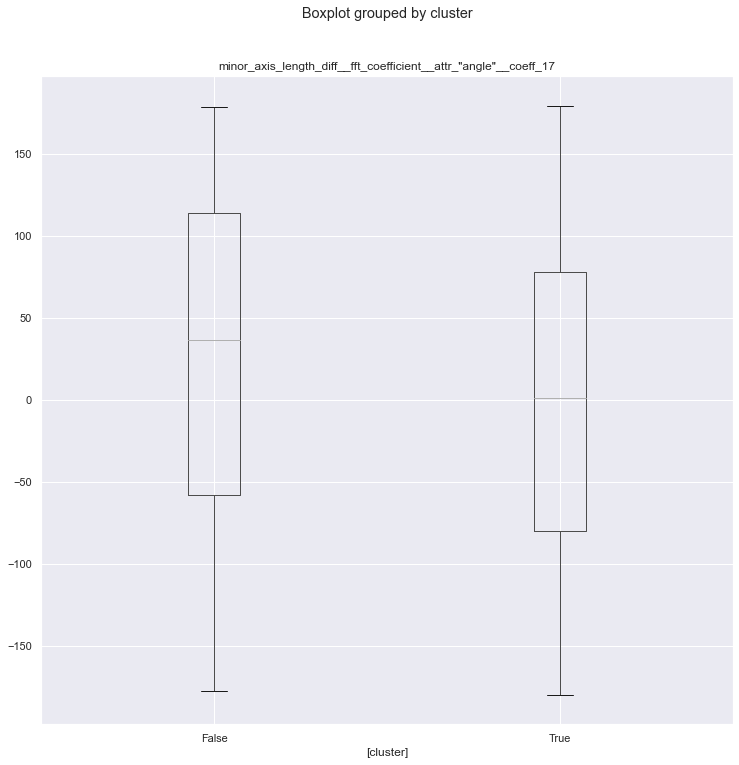

minor_axis_length_diff__fft_coefficient__attr_"real"__coeff_77


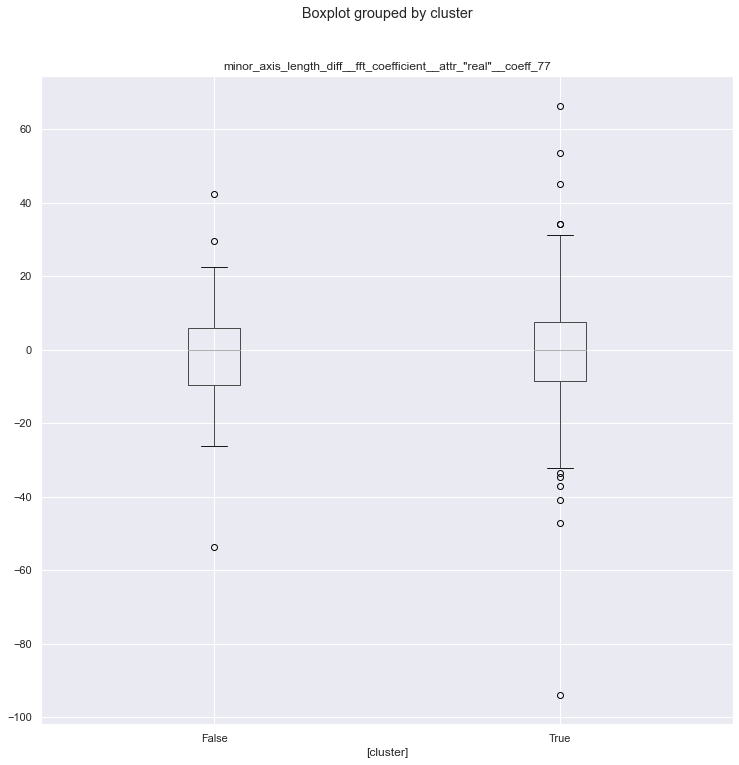

minor_axis_length_diff__fft_coefficient__attr_"imag"__coeff_38


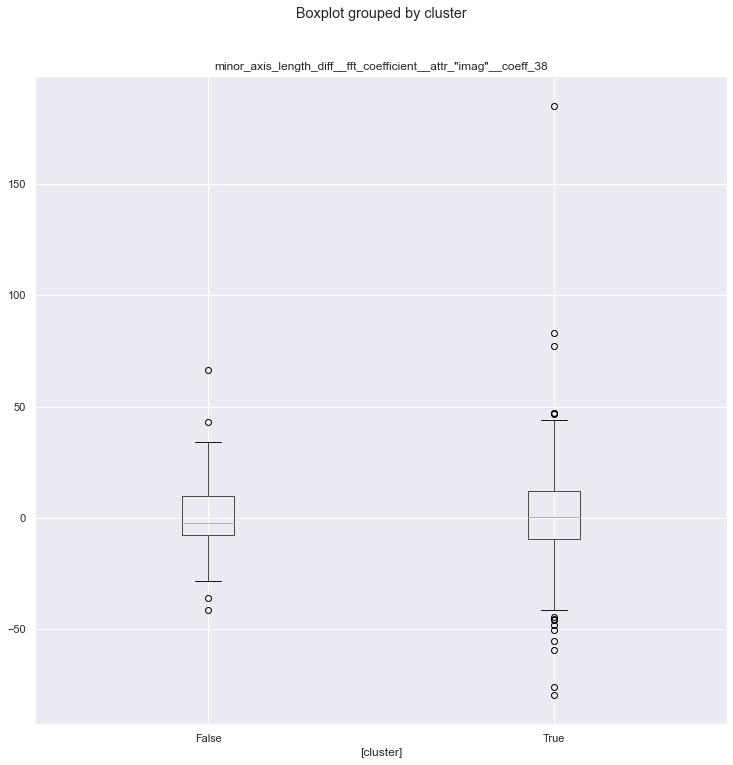

minor_axis_length_diff__fft_coefficient__attr_"angle"__coeff_36


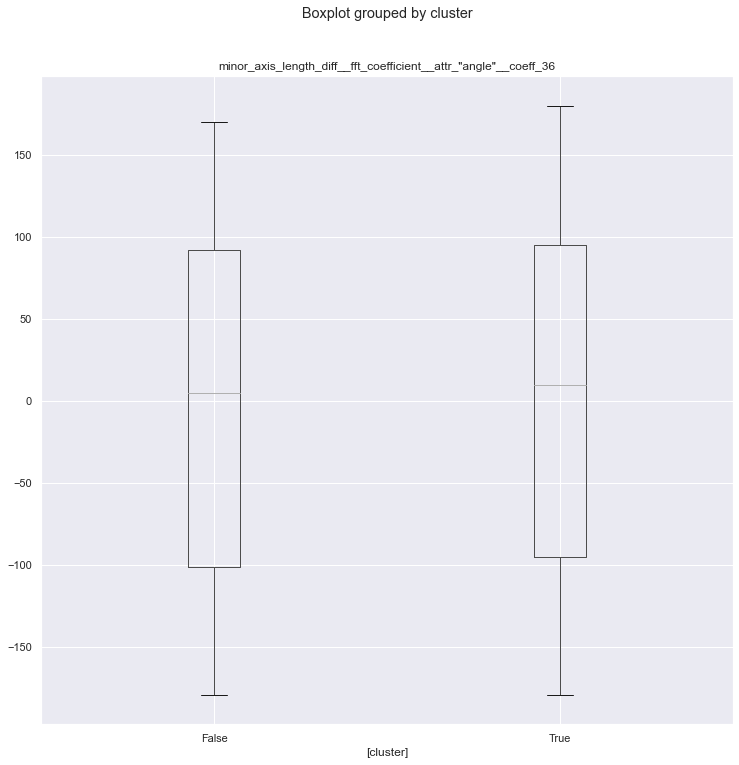

minor_axis_length_diff__fft_coefficient__attr_"angle"__coeff_33


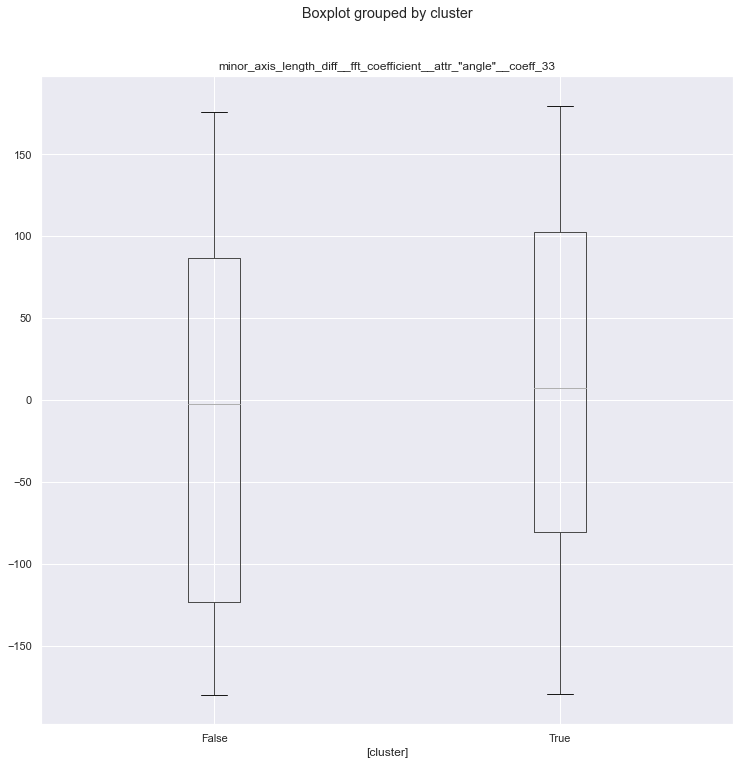

minor_axis_length_diff__change_quantiles__f_agg_"mean"__isabs_False__qh_0.4__ql_0.2


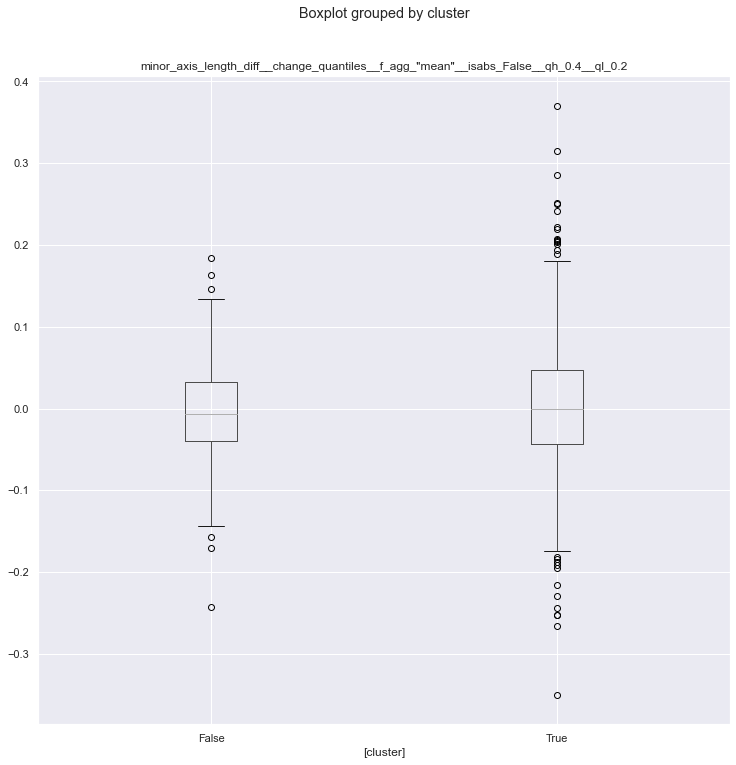

inertia_tensor-0-1_diff__fft_coefficient__attr_"real"__coeff_33


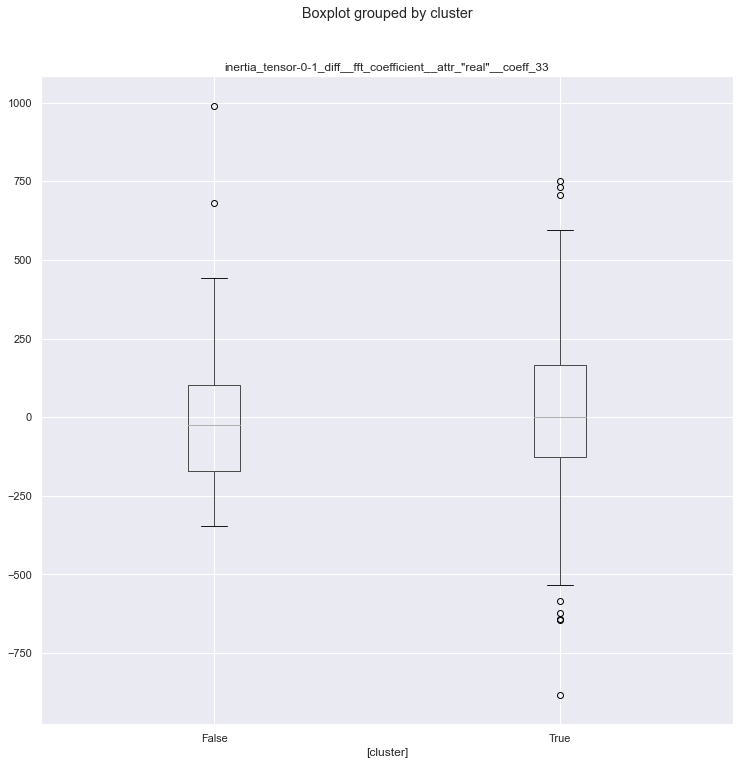

inertia_tensor-0-1_diff__fft_coefficient__attr_"real"__coeff_44


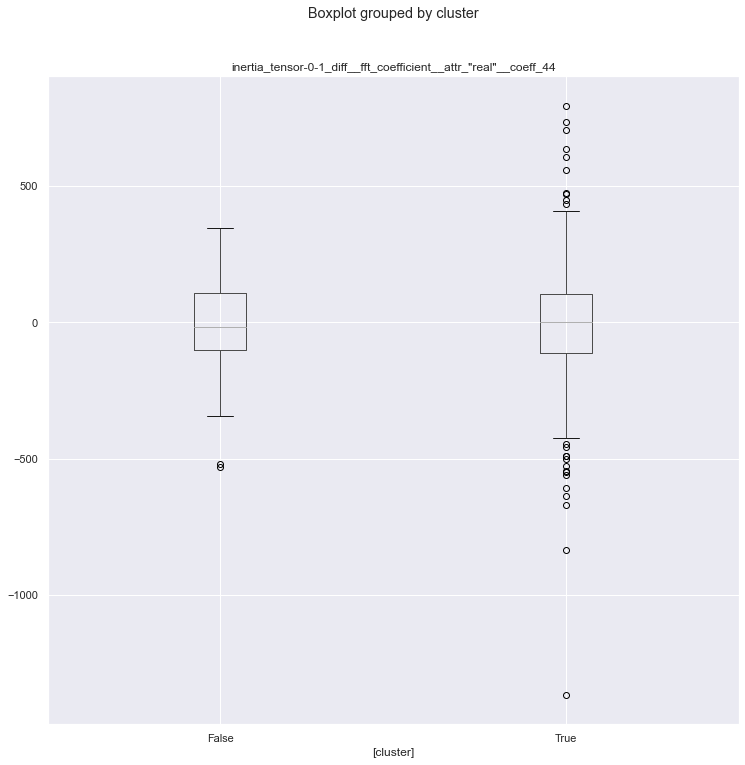

inertia_tensor-0-1_diff__fft_coefficient__attr_"angle"__coeff_64


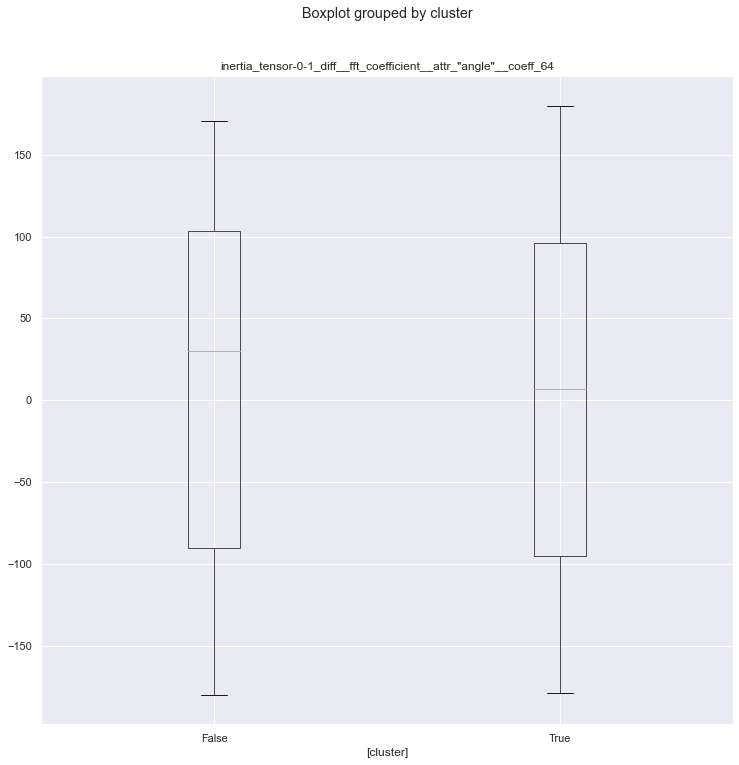

inertia_tensor-0-1_diff__cwt_coefficients__coeff_6__w_5__widths_(2, 5, 10, 20)


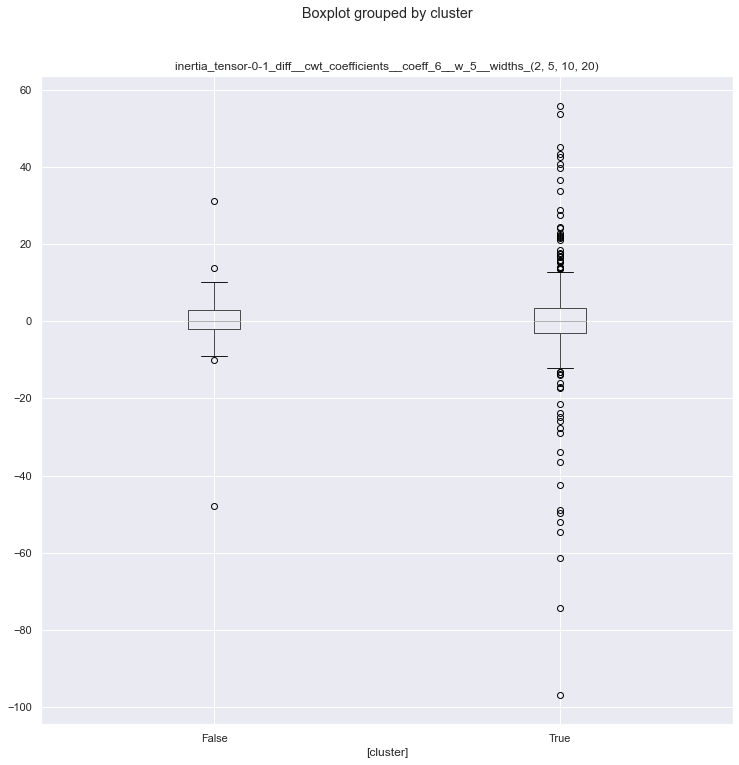

inertia_tensor-0-0_diff__fft_coefficient__attr_"angle"__coeff_56


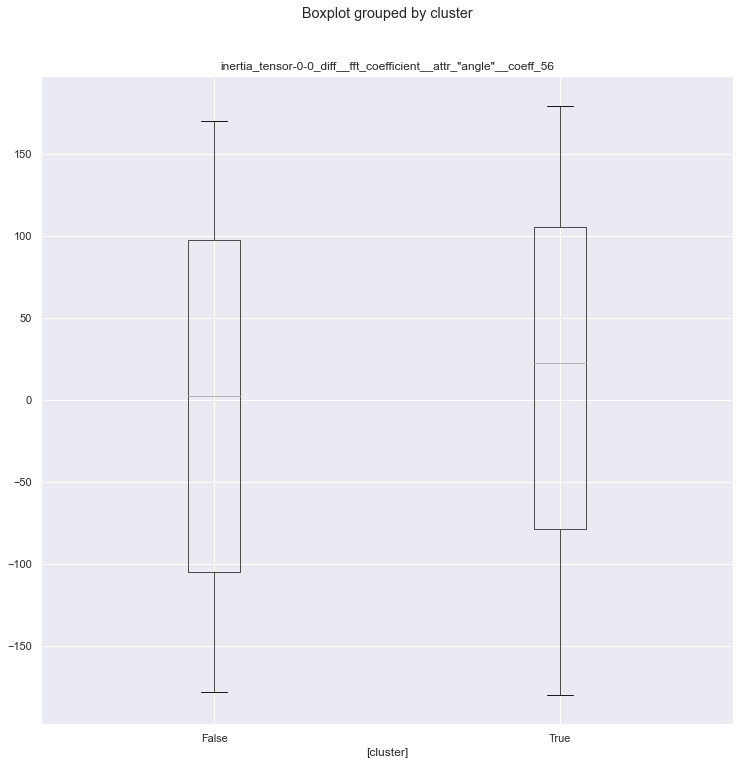

inertia_tensor-0-0_diff__fft_coefficient__attr_"angle"__coeff_50


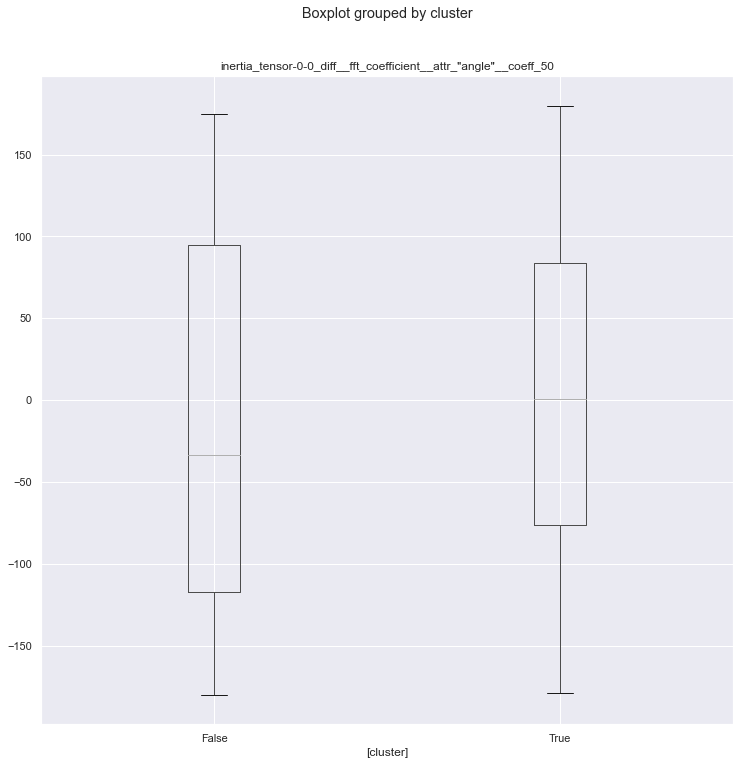

inertia_tensor-0-0_diff__fft_coefficient__attr_"angle"__coeff_48


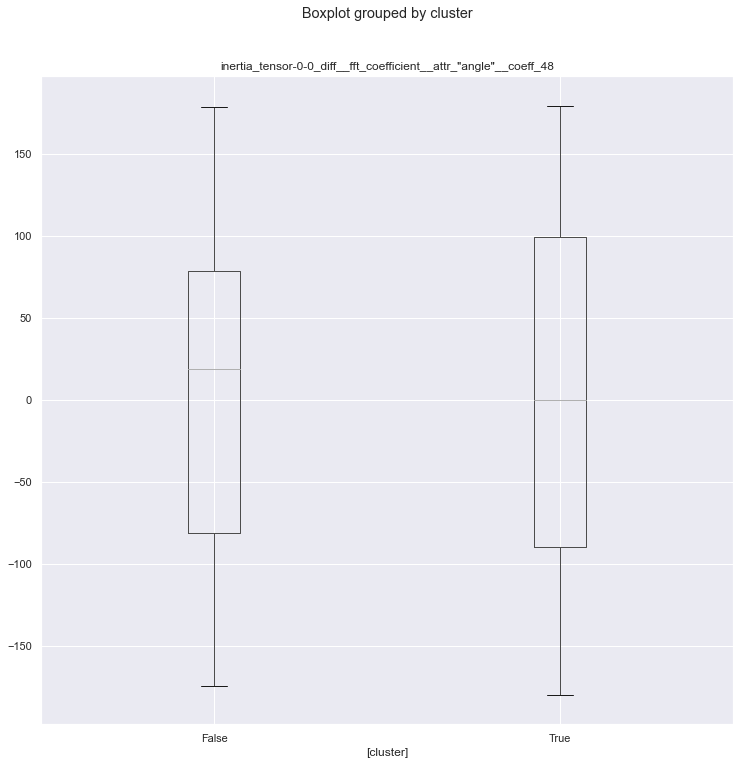

inertia_tensor-0-0_diff__fft_coefficient__attr_"angle"__coeff_10


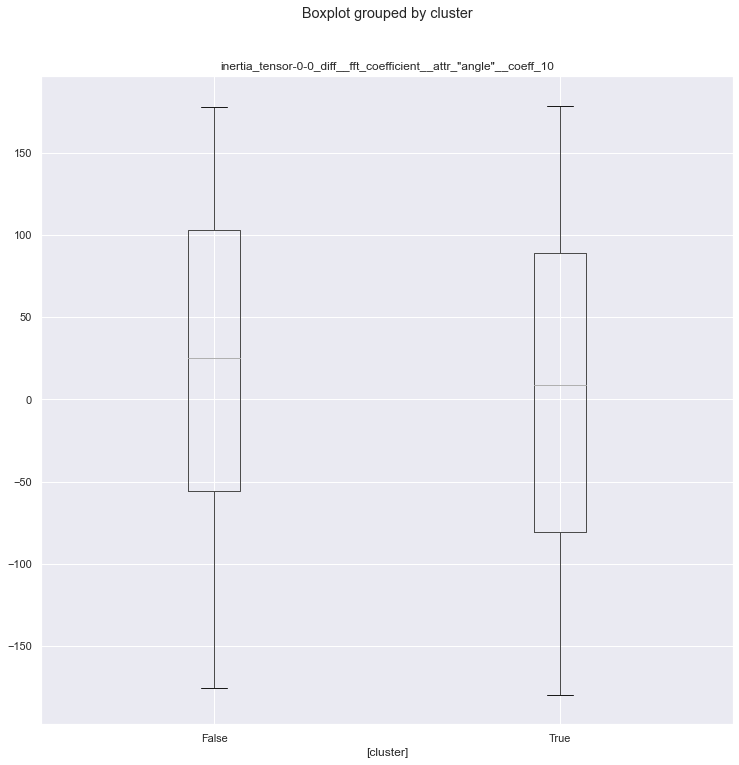

inertia_tensor-0-0_diff__fft_coefficient__attr_"angle"__coeff_95


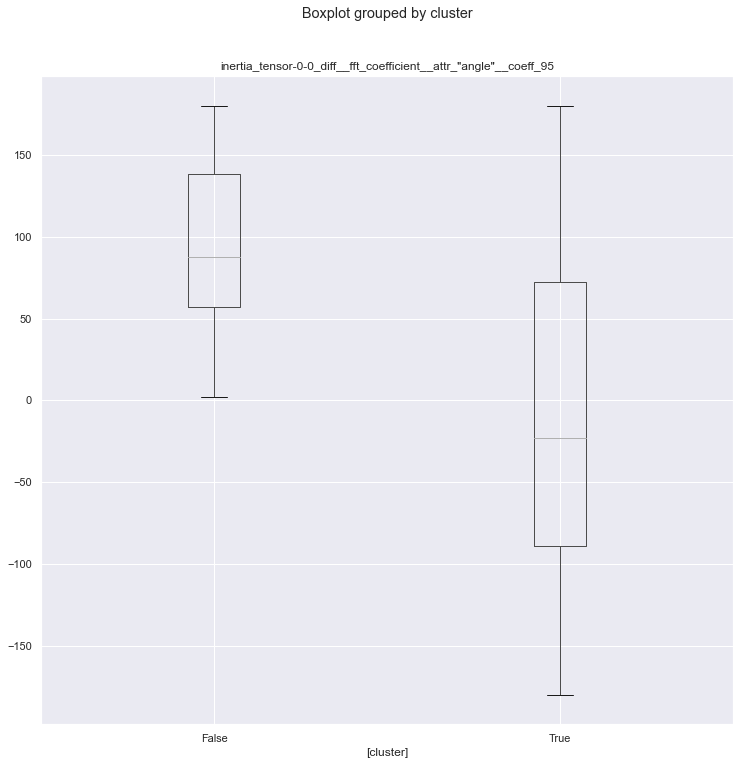

inertia_tensor-0-0_diff__fft_coefficient__attr_"imag"__coeff_14


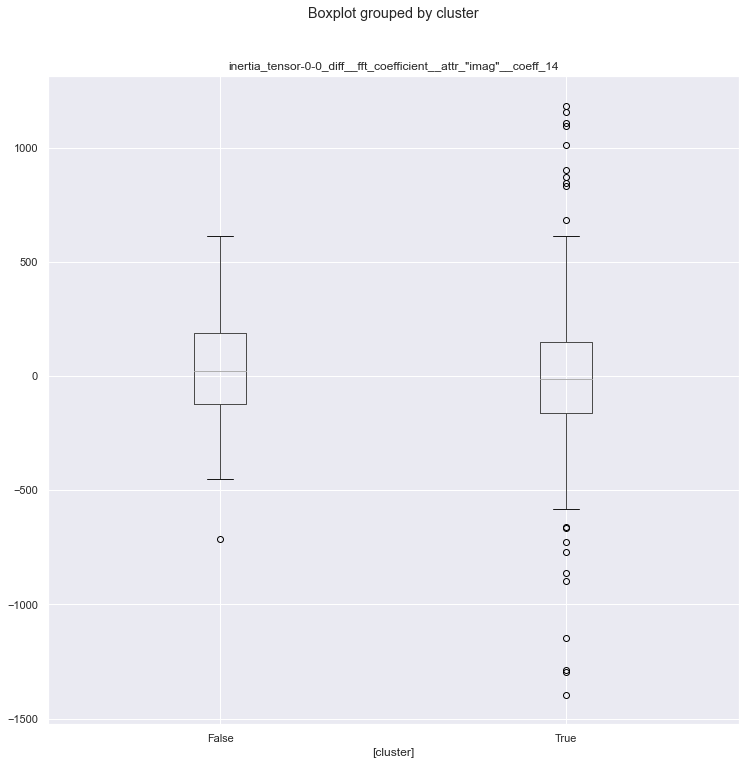

inertia_tensor-0-0_diff__fft_coefficient__attr_"real"__coeff_70


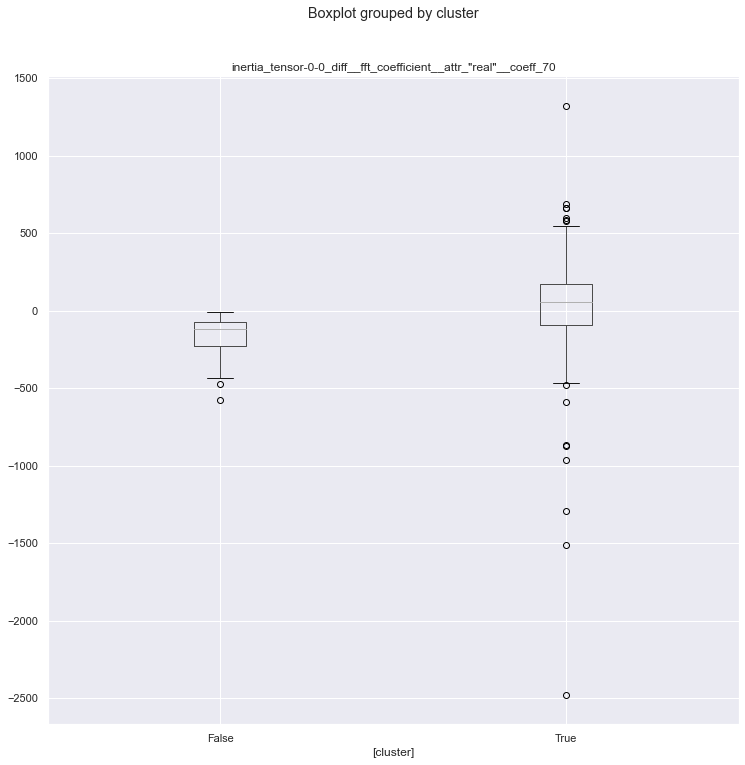

inertia_tensor-0-0_diff__fft_coefficient__attr_"imag"__coeff_41


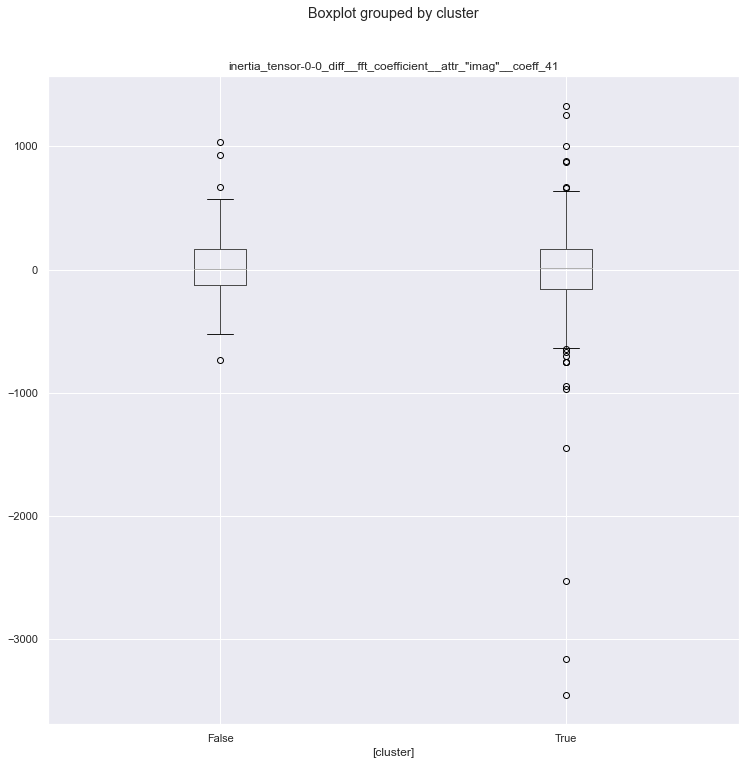

inertia_tensor-0-0_diff__fft_coefficient__attr_"imag"__coeff_52


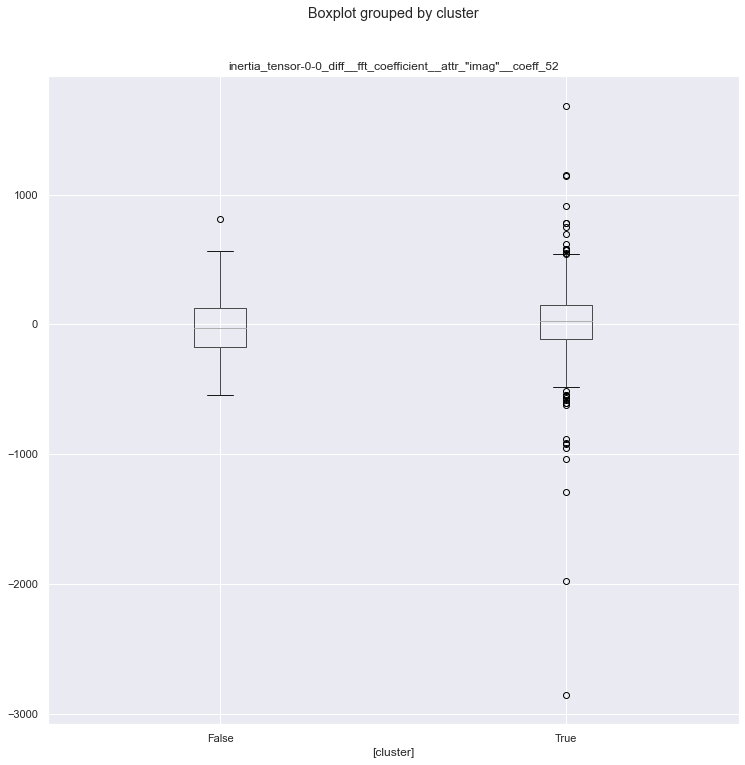

inertia_tensor-0-0_diff__fft_coefficient__attr_"real"__coeff_63


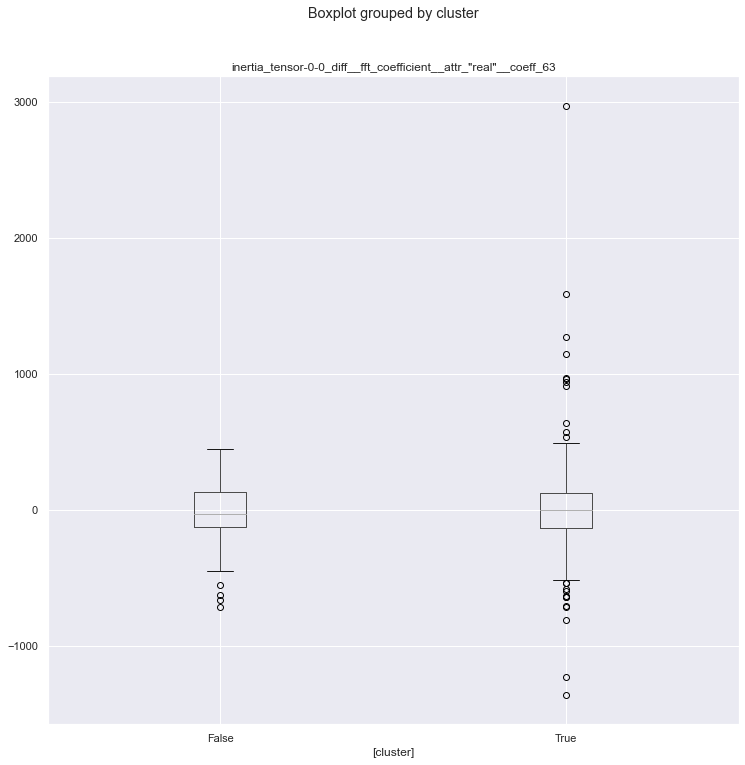

inertia_tensor-0-0_diff__fft_coefficient__attr_"angle"__coeff_25


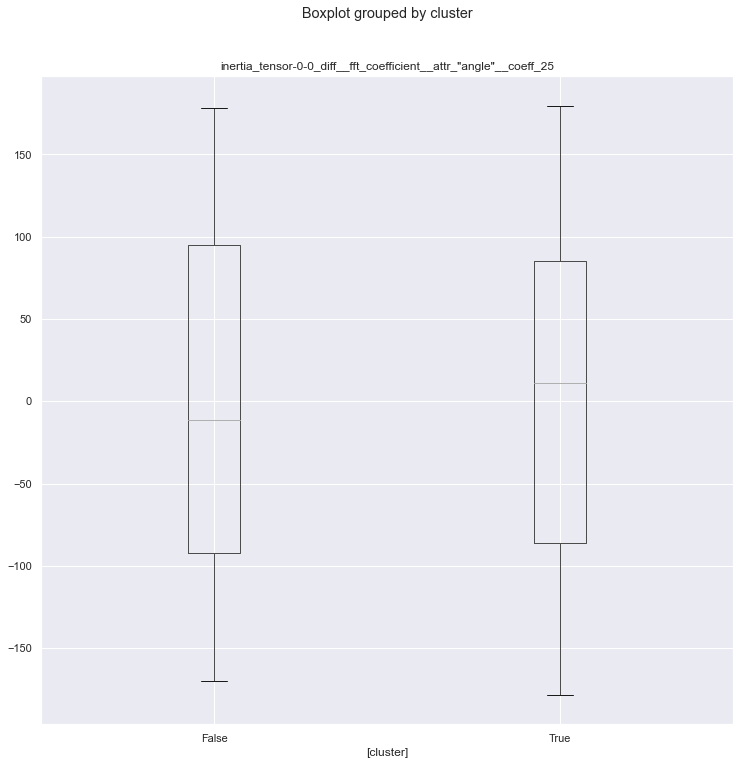

inertia_tensor-0-0_diff__fft_coefficient__attr_"angle"__coeff_81


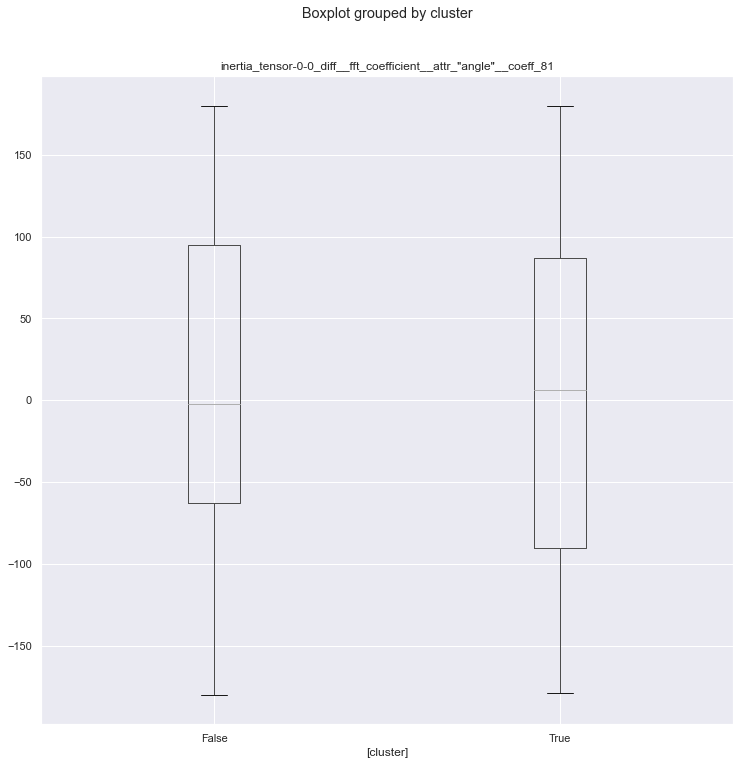

inertia_tensor-0-0_diff__fft_coefficient__attr_"angle"__coeff_59


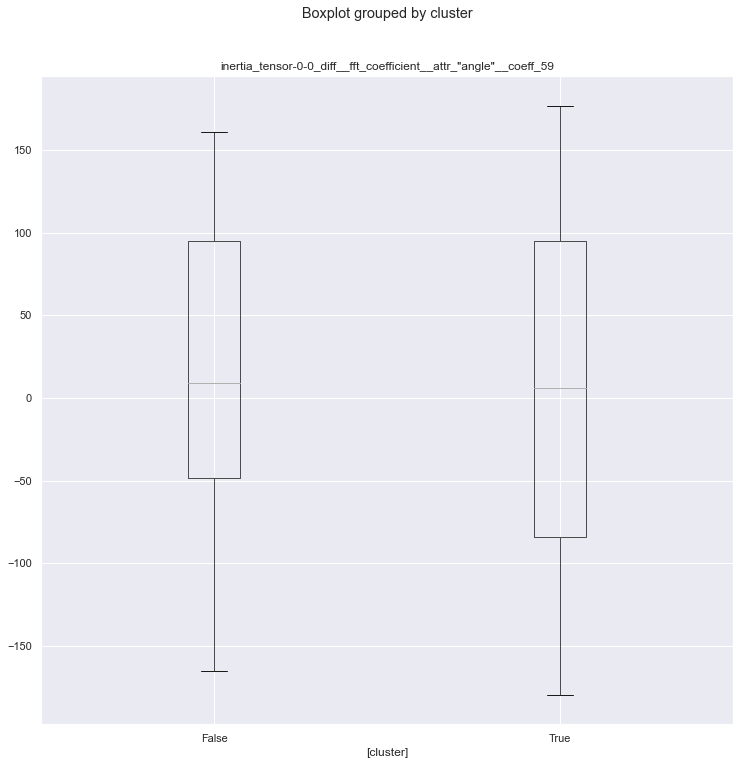

inertia_tensor-0-0_diff__agg_linear_trend__attr_"slope"__chunk_len_50__f_agg_"min"


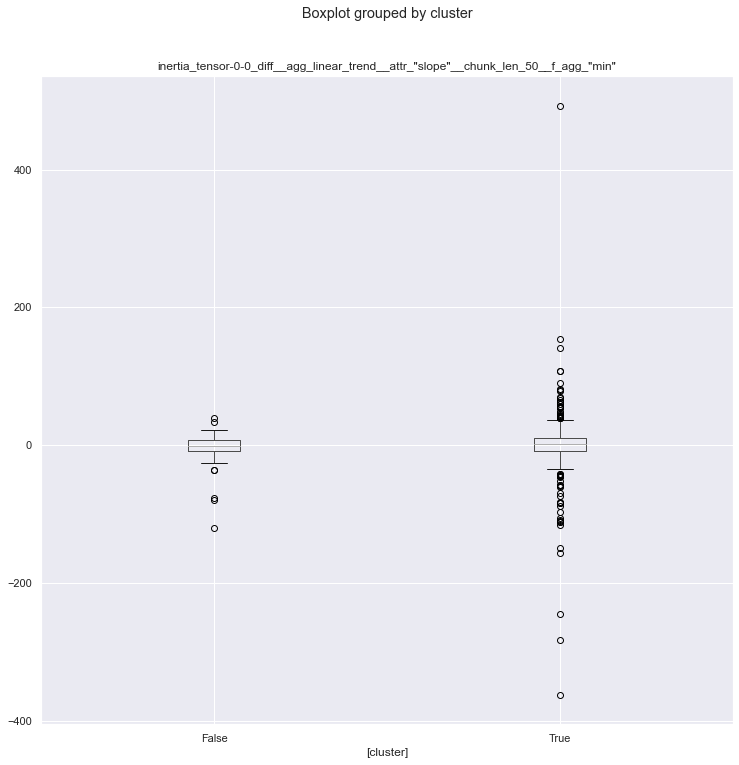

inertia_tensor-1-1_diff__fft_coefficient__attr_"real"__coeff_91


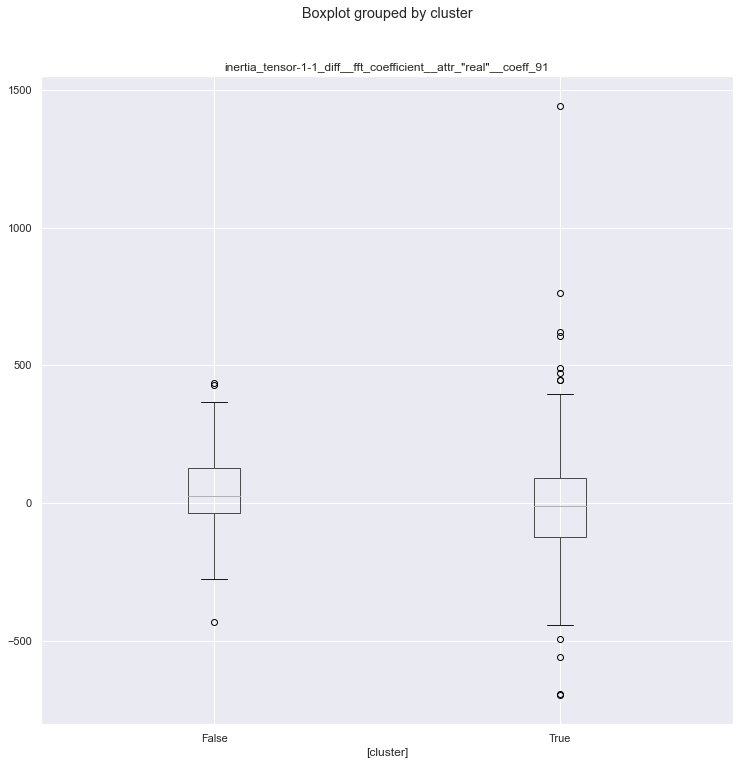

inertia_tensor-1-1_diff__fft_coefficient__attr_"real"__coeff_71


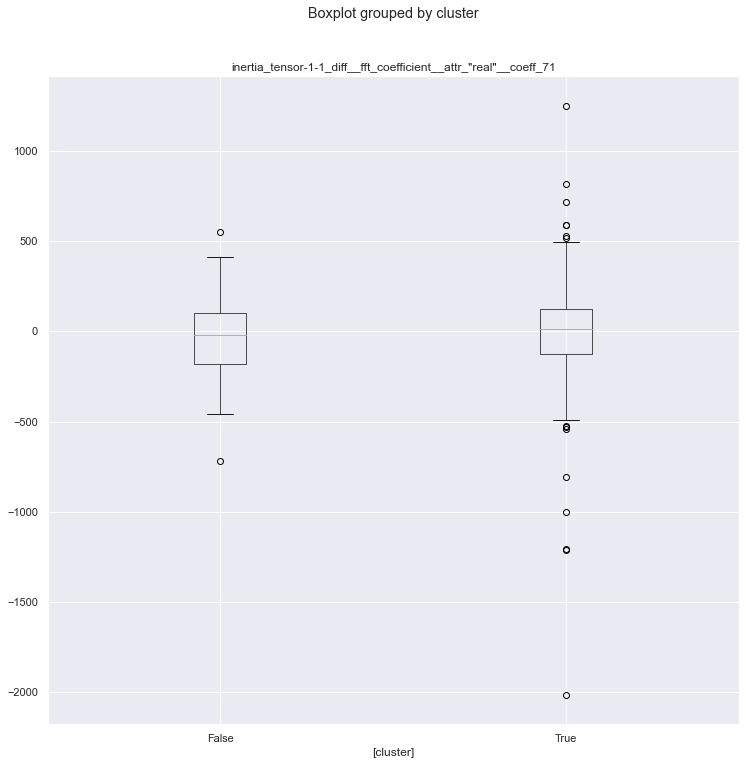

inertia_tensor-1-1_diff__fft_coefficient__attr_"imag"__coeff_70


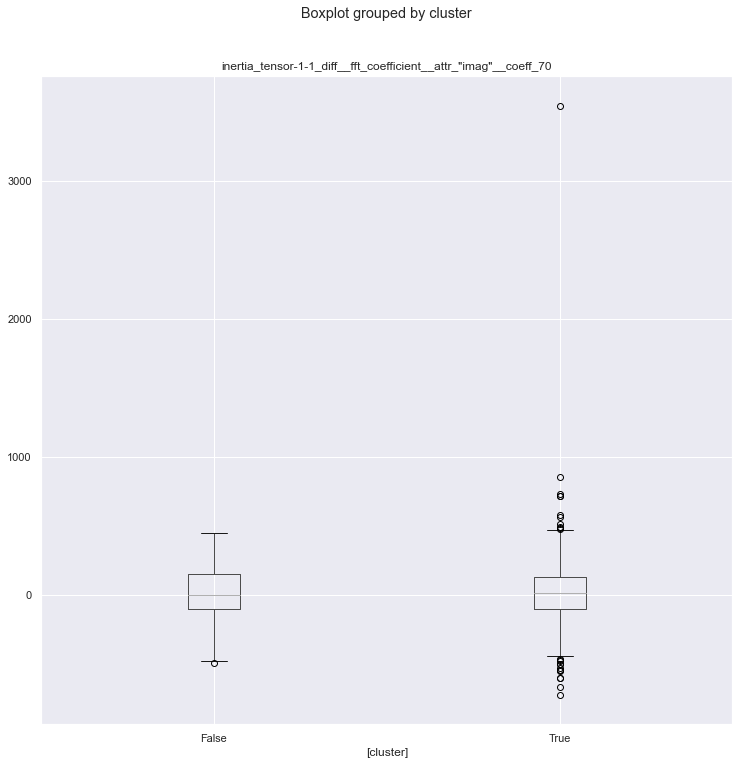

cluster


ValueError: Grouper for 'cluster' not 1-dimensional

In [836]:
for c in selected.columns:
    print(c)
    selected[[c,'cluster']].boxplot(by='cluster')
    plt.show()

In [839]:
pgs_label_df['Class_Grade_y'].astype(int)

D2011.06.29_S0078_I149_1        0
D2011.06.29_S0078_I149_2        1
D2011.06.29_S0078_I149_4        0
D2011.06.29_S0078_I149_5        1
D2011.06.29_S0079_I149_1        1
                               ..
D2019.04.22_S01986_I0149_D_4    0
D2019.04.22_S01986_I0149_D_6    0
D2019.04.22_S01986_I0149_D_9    0
D2019.05.29_S02007_I0149_D_1    1
D2019.05.29_S02007_I0149_D_2    0
Name: Class_Grade_y, Length: 632, dtype: int32

In [846]:
X_t = extracted_feats_lean.fillna(0)

In [855]:
x_train, x_test, y_trai, y_tes = train_test_split(X_t, pgs_label_df['Class_Grade_y'].astype(int))

In [921]:
y_ = pgs_label_df['Class_Grade_y'].astype(int)

In [923]:

kf = KFold(n_splits=5)
kf.get_n_splits(X_t)
feats_imp = np.zeros(X.shape[1])
for train_index, test_index in kf.split(X_t):
    
    x_train = X_t.iloc[train_index]
    x_test = X_t.iloc[test_index]
    y_trai = y_.iloc[train_index]
    y_tes = y_.iloc[test_index]
    
    lgb_train = lgb.Dataset(x_train.values, y_trai, params={'verbose': 1}, free_raw_data=False)
    lgb_eval = lgb.Dataset(x_test.values, y_tes, params={'verbose': -1},free_raw_data=False)
    regr = lgb.train(hyper_params, 
                     lgb_train, 
                     valid_sets=lgb_eval, 
                     verbose_eval=50,
                    early_stopping_rounds=50)
    
    preds = regr.predict(x_test.values)

    print(roc_auc_score(y_tes, preds))

Training until validation scores don't improve for 50 rounds
[50]	valid_0's binary_logloss: 0.644709
Early stopping, best iteration is:
[1]	valid_0's binary_logloss: 0.561595
0.47883064516129037
Training until validation scores don't improve for 50 rounds
[50]	valid_0's binary_logloss: 0.614828
Early stopping, best iteration is:
[1]	valid_0's binary_logloss: 0.553757
0.38986629134412387
Training until validation scores don't improve for 50 rounds
[50]	valid_0's binary_logloss: 0.599089
Early stopping, best iteration is:
[4]	valid_0's binary_logloss: 0.552693
0.5930390492359933
Training until validation scores don't improve for 50 rounds
[50]	valid_0's binary_logloss: 0.666902
Early stopping, best iteration is:
[2]	valid_0's binary_logloss: 0.569247
0.5705441511893125
Training until validation scores don't improve for 50 rounds
[50]	valid_0's binary_logloss: 0.778119
Early stopping, best iteration is:
[3]	valid_0's binary_logloss: 0.630582
0.5946220930232559


In [864]:
preds = regr.predict(x_test.values)

roc_auc_score(y_tes, preds)

0.6629439356712085

In [912]:
from sklearn.metrics import f1_score
threshs = np.linspace(0,.5,300)
f1s = []
for thresh in threshs:
    f1s.append(f1_score(y_tes, preds>thresh))
    
best_thresh = threshs[np.argmax(f1s)]




In [914]:
confusion_matrix(y_tes, preds>best_thresh)

array([[79, 42],
       [14, 23]], dtype=int64)

In [916]:
print(classification_report(y_tes, preds>best_thresh))

              precision    recall  f1-score   support

           0       0.85      0.65      0.74       121
           1       0.35      0.62      0.45        37

    accuracy                           0.65       158
   macro avg       0.60      0.64      0.59       158
weighted avg       0.73      0.65      0.67       158



In [863]:
extracted_feats_lean.info(max_cols=202)

<class 'pandas.core.frame.DataFrame'>
Index: 632 entries, D2011.06.29_S0078_I149_1 to D2019.05.29_S02007_I0149_D_2
Data columns (total 200 columns):
 #   Column                                                                                 Non-Null Count  Dtype  
---  ------                                                                                 --------------  -----  
 0   eccentricity__fft_coefficient__attr_"angle"__coeff_79                                  460 non-null    float64
 1   eccentricity__fft_coefficient__attr_"angle"__coeff_30                                  632 non-null    float64
 2   eccentricity__fft_coefficient__attr_"angle"__coeff_29                                  632 non-null    float64
 3   eccentricity__fft_coefficient__attr_"angle"__coeff_65                                  626 non-null    float64
 4   eccentricity__fft_coefficient__attr_"angle"__coeff_59                                  629 non-null    float64
 5   eccentricity__fft_coefficient__att

In [538]:
more_shap_values_pgs = shap.TreeExplainer(regr).shap_values(X_t)

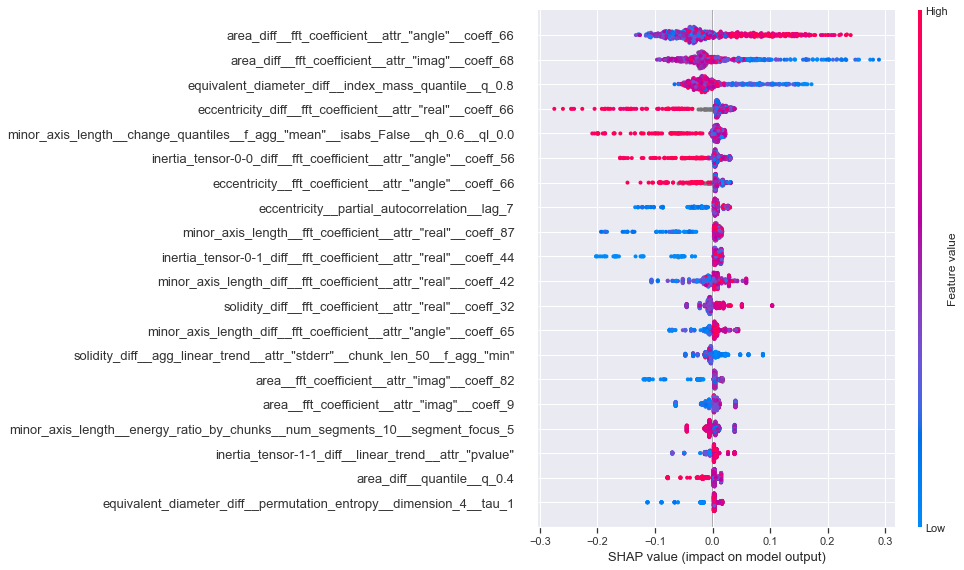

In [540]:
shap.summary_plot(more_shap_values_pgs[0], X_t)

In [402]:
pgs_label_df.loc[pgs_label_df['cluster']==7]['Class_Grade_y'].astype(int).sum()


4

In [319]:
def calc_perc_(ar):
    return 1-(ar[0]-ar[1])/ar[0]

In [320]:
calc_perc_(ar2)

IndexError: index 0 is out of bounds for axis 0 with size 0

In [330]:
percs = []
for i in range(200):

    ar1 = pgs_label.loc[shap_values_pgs[1][:,i]>0].value_counts().values
    ar2 = pgs_label.loc[shap_values_pgs[1][:,i]<0].value_counts().values
    try:
        diff = calc_perc_(ar1)/calc_perc_(ar2)
        if diff<2:
            
            percs.append(diff)
    except:
        pass

In [338]:
np.sum(np.array(percs)>.8)

138

In [293]:
1-(322-109)/322

0.33850931677018636

In [289]:
pgs_label.loc[shap_values_pgs[1][:,172]<0].value_counts()

0    322
1    109
Name: Class_Grade_y, dtype: int64

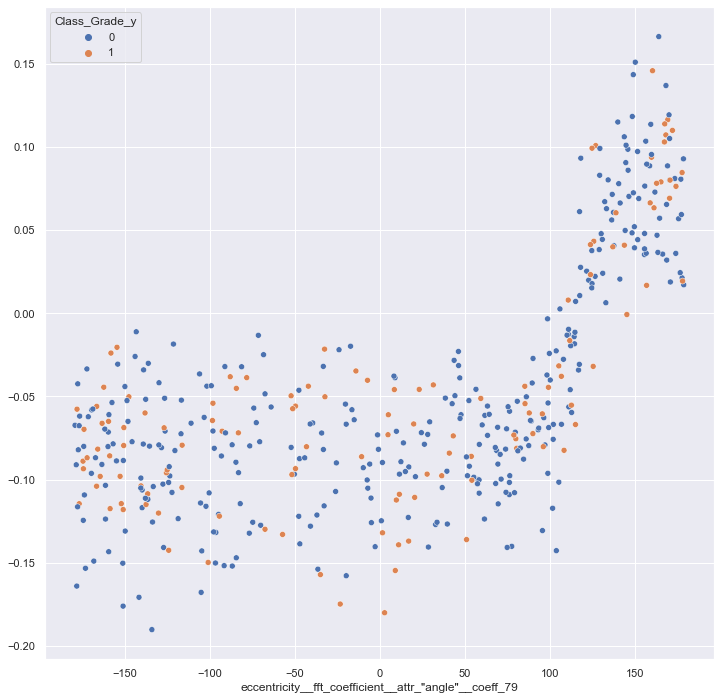

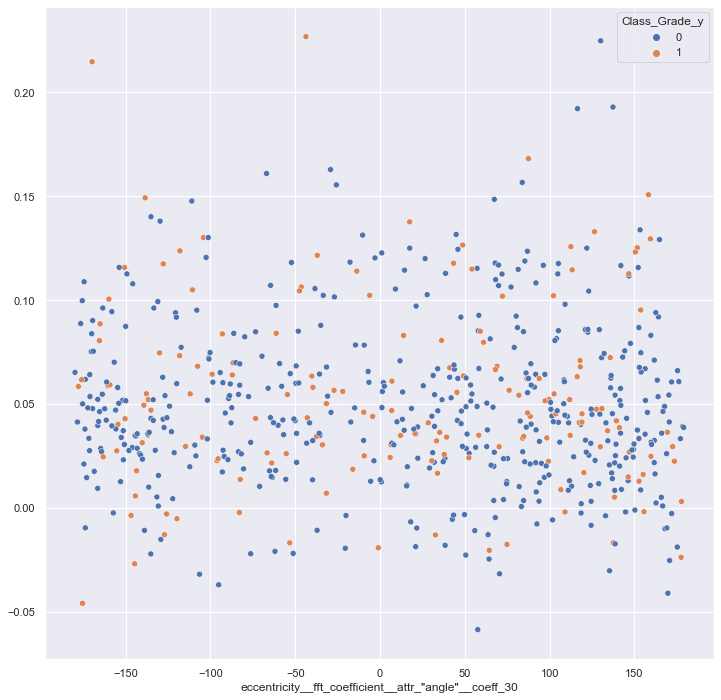

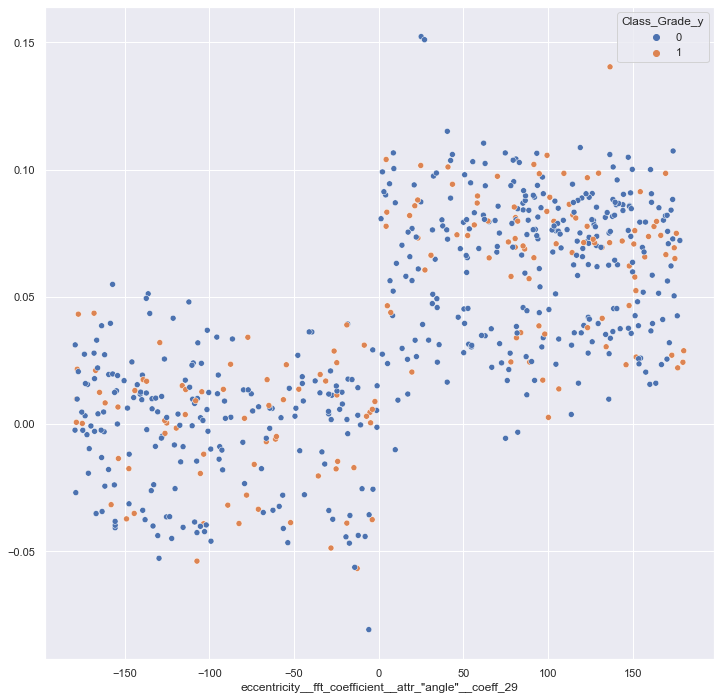

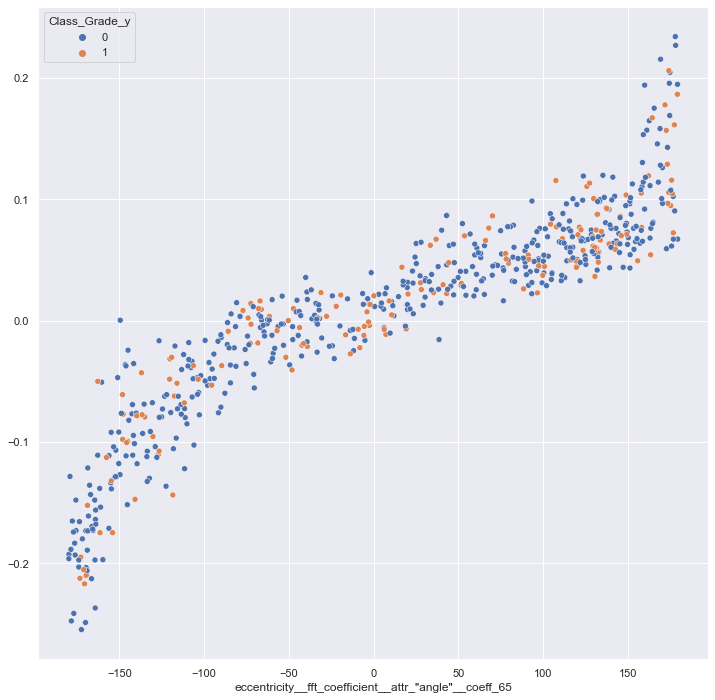

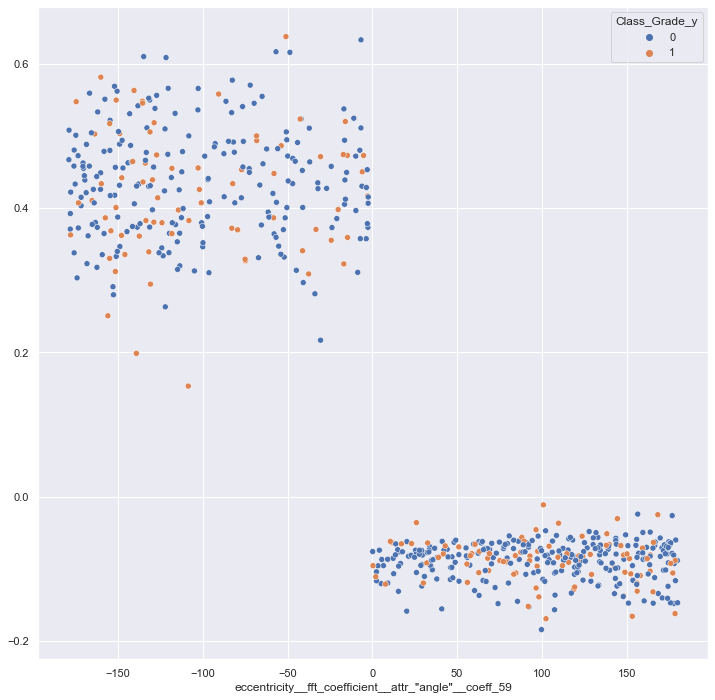

...

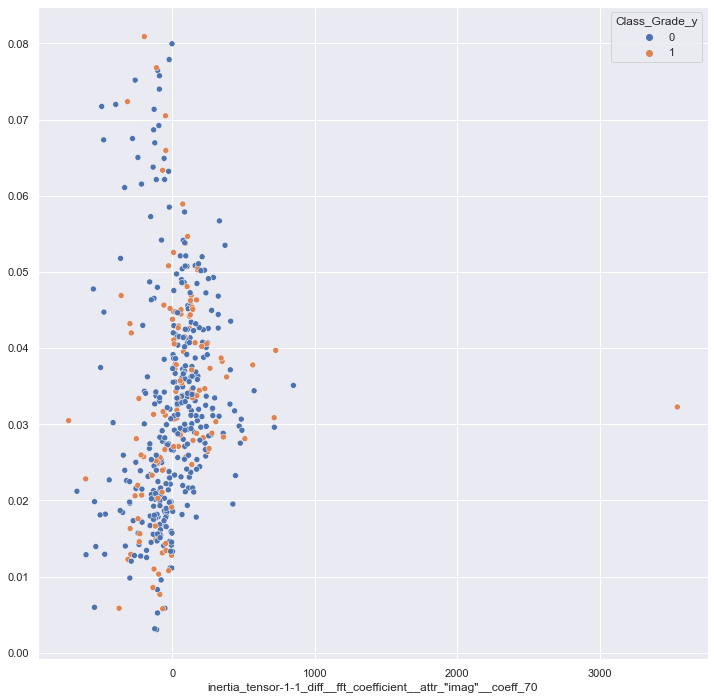

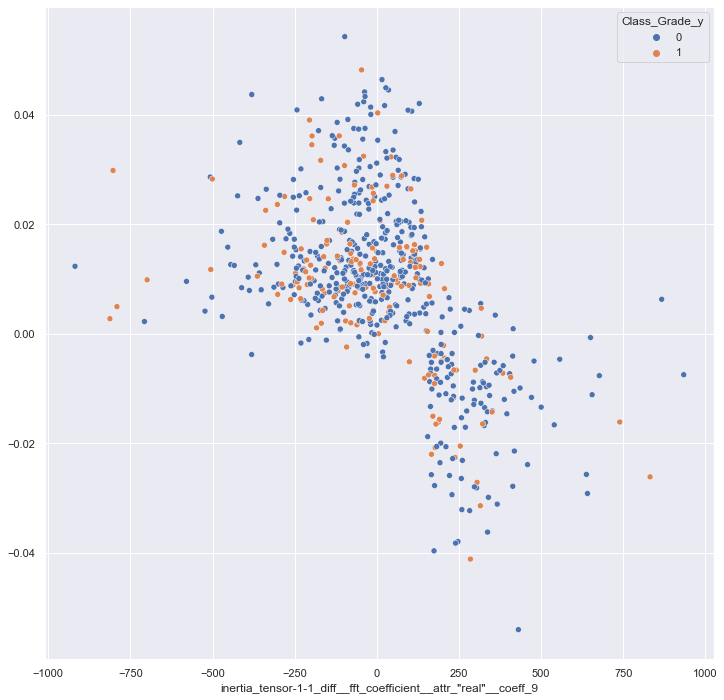

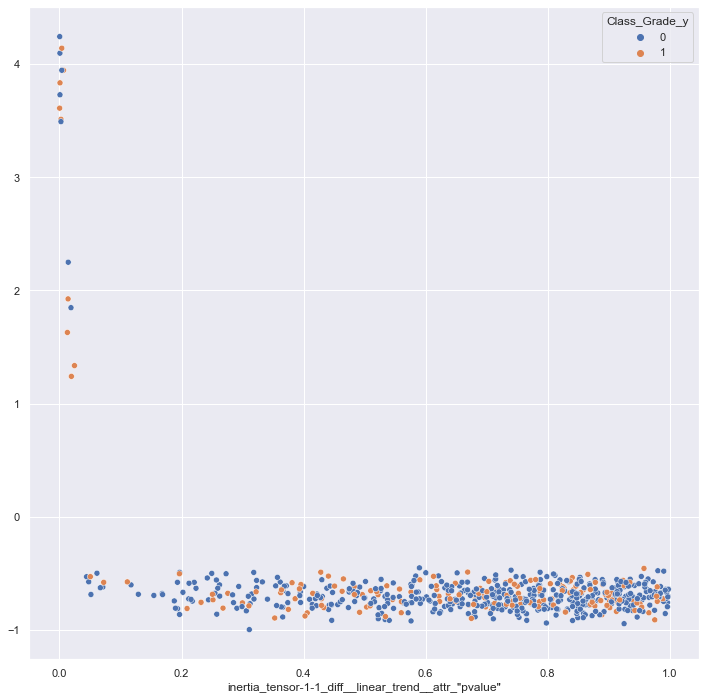

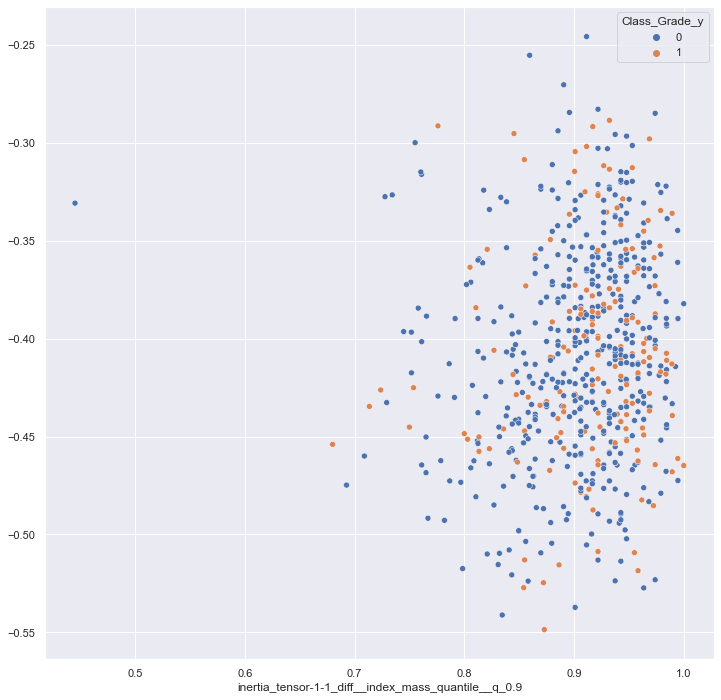

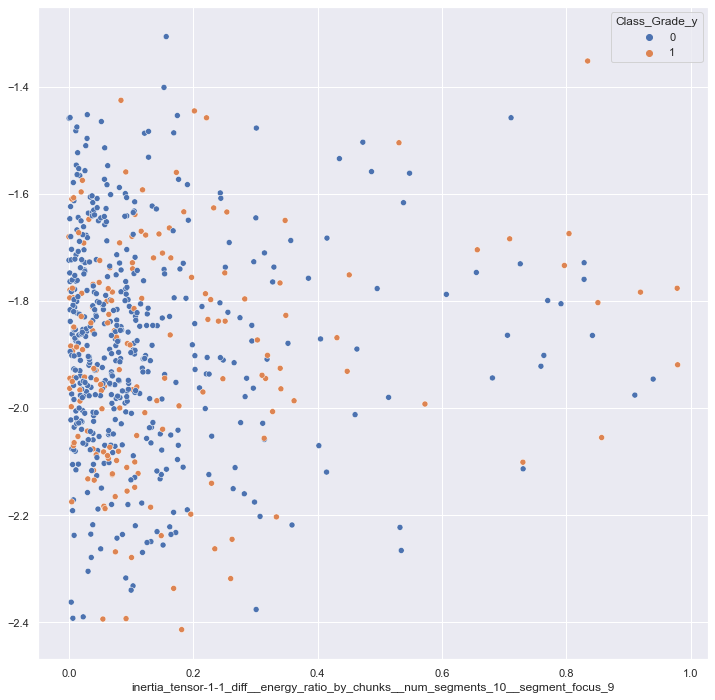

In [340]:
for i in range(200):
    sns.scatterplot(extracted_feats_lean.iloc[:,i],
                    shap_values_pgs[0][:,i],
                                         hue=pgs_label)
    
    plt.show()

In [95]:
X_train

array([[ 3.36709180e+01,  5.45393961e-02,  3.56208736e-01, ...,
         9.91582760e-02,  9.89468637e-01,  9.29788071e-02],
       [-1.41722980e+00,  1.45754133e-01,  3.33000434e-01, ...,
         9.66484641e-02,  9.89187852e-01,  9.75308640e-02],
       [-2.82292994e+01,  3.94361107e-02,  7.61942122e-01, ...,
         9.47030274e-02,  9.98581112e-01,  8.87144104e-02],
       ...,
       [-2.01090194e+01,  1.83030570e-01,  1.37997342e-01, ...,
         9.78271611e-02,  9.89068724e-01,  8.96879617e-02],
       [ 8.78382455e+00,  6.12295342e-02,  1.63281646e-01, ...,
         9.81821834e-02,  9.90842189e-01,  8.60340331e-02],
       [ 7.07861135e+01,  2.11408416e-01,  3.49419595e-01, ...,
         9.46075957e-02,  9.90035187e-01,  9.96191798e-02]])

In [308]:
top_features = np.unique(np.concatenate(top_feats))

In [ ]:
preds = regre.predict(X_test)

In [ ]:
y_test.max()

In [ ]:
preds.max()

In [ ]:
mean_absolute_error(preds, y_test)

In [ ]:
mean_squared_error(preds, y_test, squared=False)

In [ ]:
idx = np.argsort(regr.feature_importances_)[-300:]

In [ ]:
%matplotlib notebook
feats_less.iloc[:, idx[-6]].hist(bins=100)

In [ ]:

feats_less.values[:, idx[-1]]

In [ ]:
regre.feature_importances_[idx]

In [135]:
X_


,Unnamed: 0,area,eccentricity,equivalent_diameter,inertia_tensor-0-0,inertia_tensor-0-1,inertia_tensor-1-0,inertia_tensor-1-1,major_axis_length,minor_axis_length,...,moments_normalized-3-0,moments_normalized-3-1,moments_normalized-3-2,moments_normalized-3-3,perimeter,solidity,id,t,DT,Time
0,0,7932,0.180185,100.495453,628.573860,-10.004083,-10.004083,634.405509,101.343774,99.685051,...,-0.000358,0.000161,0.000025,0.000022,331.220346,0.989644,D2016.01.05_S1181_I149_10,1,0.006967,0.006967
1,0,7803,0.236842,99.674912,622.325329,-17.902466,-17.902466,620.354356,101.135111,98.257643,...,-0.000130,0.000340,-0.000004,0.000042,327.806133,0.989475,D2016.01.05_S1181_I149_10,12,0.006967,0.013934
2,0,7896,0.296763,100.267140,623.140292,-28.353816,-28.353816,635.116674,102.614443,97.991773,...,-0.000087,0.000566,0.000011,0.000068,331.220346,0.988854,D2016.01.05_S1181_I149_10,23,0.006967,0.020901
3,0,7737,0.241269,99.252478,614.385805,-18.390996,-18.390996,617.773185,100.760970,97.784307,...,0.000141,0.000337,-0.000008,0.000044,327.806133,0.988880,D2016.01.05_S1181_I149_10,34,0.006967,0.027868
4,0,7814,0.312012,99.745144,624.975317,-31.809920,-31.809920,620.930018,102.358338,97.248425,...,-0.000258,0.000569,0.000042,0.000083,328.735065,0.987988,D2016.01.05_S1181_I149_10,45,0.006967,0.034834
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
792044,0,8415,0.307121,103.509955,657.754932,-29.075474,-29.075474,690.491885,106.394715,101.252722,...,-0.001204,0.000579,0.000068,0.000077,355.261977,0.968020,D2019.05.29_S02006_I0149_D_8,330,0.010420,3.449161
792045,0,8349,0.266928,103.103234,656.868803,-21.246671,-21.246671,682.192025,105.395540,101.571420,...,-0.001460,0.000377,0.000080,0.000060,356.190909,0.965314,D2019.05.29_S02006_I0149_D_8,331,0.010420,3.459581
792046,0,8351,0.268940,103.115583,655.591814,-20.749374,-20.749374,683.947415,105.443839,101.558970,...,-0.001367,0.000420,0.000079,0.000059,357.605122,0.963206,D2019.05.29_S02006_I0149_D_8,332,0.010420,3.470002
792047,0,8302,0.262976,102.812619,654.971658,-21.289213,-21.289213,676.445331,105.037285,101.340222,...,-0.001362,0.000353,0.000075,0.000060,354.776695,0.966585,D2019.05.29_S02006_I0149_D_8,333,0.010420,3.480422


In [137]:
import tqdm

In [681]:
clean['id'] = LabelEncoder().fit_transform(clean['id'].values[:,None])[:,None]

C:\Users\hp\anaconda3\lib\site-packages\sklearn\utils\validation.py:72: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  return f(**kwargs)


In [682]:
scaler = StandardScaler()

In [683]:
clean['area'] = scaler.fit_transform(clean['area'].values.reshape(-1, 1))

In [684]:
clean['Time'] = scaler.fit_transform(clean['Time'].values.reshape(-1, 1))

In [835]:
clean = test.groupby('id').apply(drop_empty).reset_index(drop=True)
#clean = clean.groupby('id').apply(drop_no_fert).reset_index(drop=True)
clean = clean.groupby('id').apply(drop_early).reset_index(drop=True)
target_area = clean.groupby('id').apply(lambda x: x.loc[x.Time>4.65].area.iloc[0])
#target_means = clean.groupby('id').apply(lambda x: x.loc[x.Time>4.65].means.iloc[0])
#X_ = clean.groupby('id').apply(lambda x: x.loc[x.Time<3.5]).reset_index(drop=True)

In [852]:
pd.DatetimeIndex(val['Time']*8.64e+13)

DatetimeIndex(['1970-01-01 00:15:00.324774958',
               '1970-01-01 00:30:00.649549916',
               '1970-01-01 00:45:00.974324874',
               '1970-01-01 01:00:01.299099832',
               '1970-01-01 01:15:01.623874791',
               '1970-01-01 01:30:01.948649749',
               '1970-01-01 01:45:02.273424707',
               '1970-01-01 02:00:02.598199665',
               '1970-01-01 02:15:02.922974624',
               '1970-01-01 02:30:03.247749582',
               ...
               '1970-01-05 19:47:30.370805663',
               '1970-01-05 20:02:30.695580622',
               '1970-01-05 20:17:31.020355580',
               '1970-01-05 20:32:31.345130538',
               '1970-01-05 20:47:31.669905496',
               '1970-01-05 21:02:31.994680455',
               '1970-01-05 21:17:32.319455413',
               '1970-01-05 21:32:32.644230371',
               '1970-01-05 21:47:32.969005329',
               '1970-01-05 22:02:33.293780287'],
              dtype=

In [855]:
ts = val['area']
ts.index = pd.DatetimeIndex(val['Time']*8.64e+13)

In [858]:
ts.resample('1H').mean()

Time
1970-01-01 00:00:00    7836.400000
1970-01-01 01:00:00    7838.666667
1970-01-01 02:00:00    7818.500000
1970-01-01 03:00:00    7686.500000
1970-01-01 04:00:00    7587.000000
                          ...     
1970-01-05 11:00:00    9890.166667
1970-01-05 12:00:00    9874.833333
1970-01-05 13:00:00    9878.000000
1970-01-05 14:00:00    9889.166667
1970-01-05 15:00:00    9822.000000
Freq: H, Name: area, Length: 112, dtype: float64

In [341]:
feats

NameError: name 'feats' is not defined

In [347]:
clean['id'] = LabelEncoder().fit_transform(clean['id'][:,None])

In [381]:
np.linspace(0,100,30)

array([  0.        ,   3.44827586,   6.89655172,  10.34482759,
        13.79310345,  17.24137931,  20.68965517,  24.13793103,
        27.5862069 ,  31.03448276,  34.48275862,  37.93103448,
        41.37931034,  44.82758621,  48.27586207,  51.72413793,
        55.17241379,  58.62068966,  62.06896552,  65.51724138,
        68.96551724,  72.4137931 ,  75.86206897,  79.31034483,
        82.75862069,  86.20689655,  89.65517241,  93.10344828,
        96.55172414, 100.        ])

In [393]:
resampled_df#.groupby('id')['Time_1'].max()

,id,Time,eccentricity,minor_axis_length,major_axis_length,area,solidity,Time_1
0,0,1970-01-01 00:00:00,0.111802,100.728117,101.440785,8023.000000,0.989333,0.000005
1,0,1970-01-01 00:30:00,0.157138,100.431612,101.809525,8028.333333,0.988666,0.017396
2,0,1970-01-01 01:00:00,0.175007,98.799334,100.662324,7809.666667,0.989700,0.038266
3,0,1970-01-01 01:30:00,0.239554,97.261541,100.188789,7651.666667,0.990126,0.059136
4,0,1970-01-01 02:00:00,0.156106,97.216802,98.622087,7528.333333,0.989050,0.080006
...,...,...,...,...,...,...,...,...
494755,2169,1970-01-05 15:30:00,0.345273,131.839649,140.478590,14544.333333,0.992108,4.643542
494756,2169,1970-01-05 16:00:00,0.364106,133.696722,143.551993,15068.666667,0.991600,4.664412
494757,2169,1970-01-05 16:30:00,0.358089,136.847972,146.566883,15748.000000,0.990274,4.685282
494758,2169,1970-01-05 17:00:00,0.362711,139.681184,149.898960,16436.333333,0.991055,4.706152


In [412]:
resampled_df.groupby('id').area.mean()


id
0       8707.590643
1       8707.590643
2       8707.590643
3       8707.590643
4       8707.590643
           ...     
2165    8707.590643
2166    8707.590643
2167    8707.590643
2168    8707.590643
2169    8707.590643
Name: area, Length: 2170, dtype: float64

<IPython.core.display.Javascript object>


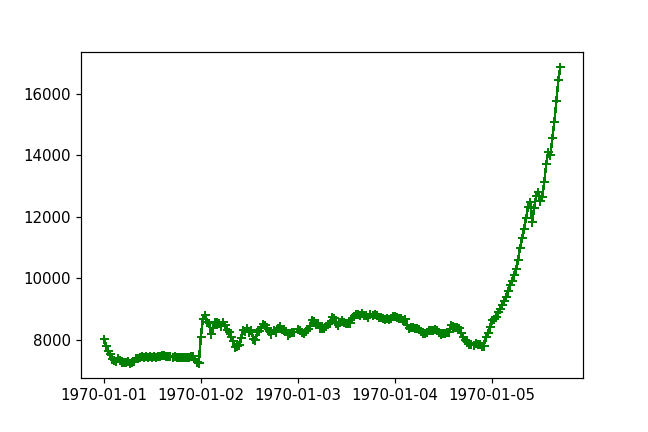

In [410]:
count = 0
%matplotlib notebook
count_big = 0
count_small = 0 
for g, val in resampled_df.groupby('id'):
   # if val.area.values[-1]>5500:
    ts = val.loc[val['Time_1']<=6]['area']
    ts.index = pd.DatetimeIndex(val.loc[val['Time_1']<=6]['Time_1']*8.64e+13)
    
    if ts.max()>12000:
        
        plt.plot(ts.resample('30min').mean(), color='green',marker='+', linewidth=1)
        plt.show()
        count_big+=1
    else:
        
        plt.plot(ts.resample('30min').mean(), color='red',marker='*', linewidth=1)
        plt.show()
        count_small+=1
    
    if (count_small>10)&(count_big>10):
        break

In [411]:

count_small

0

In [685]:
def get_sequences(df):
    group = df.groupby('id')
    
    seq_dict = {}
    for idx, g in tqdm.tqdm(group):
        seq_dict[idx] = {'time': g['Time'].values,
                         'area': g['area'].values
            
        }
        
    return seq_dict

In [686]:
seq_dict = get_sequences(clean[['id', 'Time', 'area']])

100%|████████████████████████████████████████████████████████████████████████████| 2170/2170 [00:00<00:00, 4159.46it/s]


In [697]:
window_size = 50

In [807]:
device='cuda'

In [827]:
class SAINT(nn.Module):
    def __init__(self, n_inp=100, n_head=2, n_hidden=64, n_layers=2, dropout=0.1, device='cpu'):
        super(SAINT, self).__init__()
        temp = nn.Transformer()
        self.n_inp = n_inp
        self.attn_mask = temp.generate_square_subsequent_mask(n_inp).to(device)
        self.dropout = nn.Dropout()
        #self.enc_norm = torch.nn.BatchNorm1d(100)

        self.embryo_embedding = nn.Embedding(num_embeddings=2170, embedding_dim=50)
        self.embryo_linear = nn.Linear(1, 50, bias=False)
        self.time_embedding = nn.Linear(1, 50, bias=False)
        self.area_embedding = nn.Linear(1, 50, bias=False)
        self.position_emb_enc = nn.Embedding(num_embeddings=n_inp, embedding_dim=50)
        
        encoder_layer = nn.TransformerEncoderLayer(d_model=50,
                                                   dim_feedforward = 128, nhead=5)
        self.encoder_1 = torch.nn.TransformerEncoder(encoder_layer, 3)
        
        self.final = nn.Linear(50, 1)
        self.device = device

    def positional_encoding(self, content_id):
        with torch.no_grad():
            return torch.arange(0, content_id.shape[1]).to(self.device). \
                unsqueeze(0).repeat(content_id.shape[0], 1)

    def forward(self, embryo_id, time, area):
        # u_emp = self.user_emb(user)
        embryo_emb = self.embryo_embedding(embryo_id)
        embryo_emb = self.embryo_linear(embryo_emb.unsqueeze(2))
        time_emb = self.time_embedding(time.unsqueeze(2))
        
        area = torch.roll(area,1,1)
        area[:,0] = 15
        area_emb = self.time_embedding(area.unsqueeze(2))
        
        pos_emb = self.position_emb_enc(self.positional_encoding(time))
        
        embedded_src = embryo_emb + time_emb + area_emb
        embedded_src += pos_emb
        embedded_src = embedded_src.transpose(0, 1)

        #src_mask = padding_mask  # & self.atn_mask
        #tgt_mask = padding_mask
        attn_mask = self.attn_mask
        
        enc_1 = self.encoder_1(embedded_src, mask = attn_mask)
        
        output = enc_1.transpose(0, 1)
        output = self.final(output)

        return output

In [828]:
model = SAINT(n_inp=window_size, device=device)

In [829]:
model.to(device)

SAINT(
  (dropout): Dropout(p=0.5, inplace=False)
  (embryo_embedding): Embedding(2170, 50)
  (embryo_linear): Linear(in_features=1, out_features=50, bias=False)
  (time_embedding): Linear(in_features=1, out_features=50, bias=False)
  (area_embedding): Linear(in_features=1, out_features=50, bias=False)
  (position_emb_enc): Embedding(50, 50)
  (encoder_1): TransformerEncoder(
    (layers): ModuleList(
      (0): TransformerEncoderLayer(
        (self_attn): MultiheadAttention(
          (out_proj): Linear(in_features=50, out_features=50, bias=True)
        )
        (linear1): Linear(in_features=50, out_features=128, bias=True)
        (dropout): Dropout(p=0.1, inplace=False)
        (linear2): Linear(in_features=128, out_features=50, bias=True)
        (norm1): LayerNorm((50,), eps=1e-05, elementwise_affine=True)
        (norm2): LayerNorm((50,), eps=1e-05, elementwise_affine=True)
        (dropout1): Dropout(p=0.1, inplace=False)
        (dropout2): Dropout(p=0.1, inplace=False)
    

In [564]:
#target_area = clean.groupby('id').apply(lambda x: x.loc[x.Time>4.65].area.iloc[0])

In [565]:
#target_area.index  = label_enc.transform(np.array(target_area.index))

In [627]:
#target_area = scaler.fit_transform(target_area.values[:,None])


In [832]:
window_size = 50

In [700]:
import random
random_keys = [key for key in seq_dict.keys()]
random.shuffle(random_keys)

,Unnamed: 0,area,eccentricity,equivalent_diameter,inertia_tensor-0-0,inertia_tensor-0-1,inertia_tensor-1-0,inertia_tensor-1-1,major_axis_length,minor_axis_length,...,moments_normalized-3-0,moments_normalized-3-1,moments_normalized-3-2,moments_normalized-3-3,perimeter,solidity,id,t,DT,Time
0,0,-0.337514,0.180185,100.495453,628.573860,-10.004083,-10.004083,634.405509,101.343774,99.685051,...,-0.000358,0.000161,0.000025,0.000022,331.220346,0.989644,0,1,0.006967,-1.700386
1,0,-0.425763,0.236842,99.674912,622.325329,-17.902466,-17.902466,620.354356,101.135111,98.257643,...,-0.000130,0.000340,-0.000004,0.000042,327.806133,0.989475,0,12,0.006967,-1.695562
2,0,-0.362141,0.296763,100.267140,623.140292,-28.353816,-28.353816,635.116674,102.614443,97.991773,...,-0.000087,0.000566,0.000011,0.000068,331.220346,0.988854,0,23,0.006967,-1.690739
3,0,-0.470914,0.241269,99.252478,614.385805,-18.390996,-18.390996,617.773185,100.760970,97.784307,...,0.000141,0.000337,-0.000008,0.000044,327.806133,0.988880,0,34,0.006967,-1.685915
4,0,-0.418238,0.312012,99.745144,624.975317,-31.809920,-31.809920,620.930018,102.358338,97.248425,...,-0.000258,0.000569,0.000042,0.000083,328.735065,0.987988,0,45,0.006967,-1.681091
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1107254,0,-0.195903,0.246710,101.798314,633.996666,-8.546979,-8.546979,671.228500,103.776437,100.568652,...,0.000120,-0.000043,-0.000034,0.000025,352.433550,0.963081,2169,467,0.010420,1.671454
1107255,0,-0.256105,0.287239,101.246489,622.240707,-13.834648,-13.834648,670.494763,103.859890,99.483118,...,0.000325,0.000023,-0.000044,0.000039,349.119841,0.965927,2169,468,0.010420,1.678669
1107256,0,-0.232161,0.285921,101.466324,630.076176,-20.692383,-20.692383,666.703742,104.001748,99.659998,...,0.000385,0.000252,-0.000044,0.000054,350.776695,0.965839,2169,469,0.010420,1.685884
1107257,0,-0.197272,0.271358,101.785805,633.136534,-15.944452,-15.944452,671.476759,104.095413,100.189609,...,0.000208,0.000130,-0.000052,0.000039,352.190909,0.963757,2169,470,0.010420,1.693100


,Unnamed: 0,area,eccentricity,equivalent_diameter,inertia_tensor-0-0,inertia_tensor-0-1,inertia_tensor-1-0,inertia_tensor-1-1,major_axis_length,minor_axis_length,...,moments_normalized-3-0,moments_normalized-3-1,moments_normalized-3-2,moments_normalized-3-3,perimeter,solidity,id,t,DT,Time
0,0,7932,0.180185,100.495453,628.573860,-10.004083,-10.004083,634.405509,101.343774,99.685051,...,-0.000358,0.000161,0.000025,0.000022,331.220346,0.989644,D2016.01.05_S1181_I149_10,1,0.006967,0.006967
1,0,7803,0.236842,99.674912,622.325329,-17.902466,-17.902466,620.354356,101.135111,98.257643,...,-0.000130,0.000340,-0.000004,0.000042,327.806133,0.989475,D2016.01.05_S1181_I149_10,12,0.006967,0.013934
2,0,7896,0.296763,100.267140,623.140292,-28.353816,-28.353816,635.116674,102.614443,97.991773,...,-0.000087,0.000566,0.000011,0.000068,331.220346,0.988854,D2016.01.05_S1181_I149_10,23,0.006967,0.020901
3,0,7737,0.241269,99.252478,614.385805,-18.390996,-18.390996,617.773185,100.760970,97.784307,...,0.000141,0.000337,-0.000008,0.000044,327.806133,0.988880,D2016.01.05_S1181_I149_10,34,0.006967,0.027868
4,0,7814,0.312012,99.745144,624.975317,-31.809920,-31.809920,620.930018,102.358338,97.248425,...,-0.000258,0.000569,0.000042,0.000083,328.735065,0.987988,D2016.01.05_S1181_I149_10,45,0.006967,0.034834
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1107254,0,8139,0.246710,101.798314,633.996666,-8.546979,-8.546979,671.228500,103.776437,100.568652,...,0.000120,-0.000043,-0.000034,0.000025,352.433550,0.963081,D2019.05.29_S02006_I0149_D_8,467,0.010420,4.876759
1107255,0,8051,0.287239,101.246489,622.240707,-13.834648,-13.834648,670.494763,103.859890,99.483118,...,0.000325,0.000023,-0.000044,0.000039,349.119841,0.965927,D2019.05.29_S02006_I0149_D_8,468,0.010420,4.887180
1107256,0,8086,0.285921,101.466324,630.076176,-20.692383,-20.692383,666.703742,104.001748,99.659998,...,0.000385,0.000252,-0.000044,0.000054,350.776695,0.965839,D2019.05.29_S02006_I0149_D_8,469,0.010420,4.897600
1107257,0,8137,0.271358,101.785805,633.136534,-15.944452,-15.944452,671.476759,104.095413,100.189609,...,0.000208,0.000130,-0.000052,0.000039,352.190909,0.963757,D2019.05.29_S02006_I0149_D_8,470,0.010420,4.908020


In [799]:
def create_batches(dic, target):
    batches_time = []
    batches_area = []
    batches_y = []
    ids = []
    for key in random_keys:
        value = dic[key]
        t = value['time']
        area = value['area']
        
        rem = len(t)%window_size
        #print(len(t))
        if rem!=0:
            t_full = t[:-rem]
            area_full = area[:-rem]
        else:
            t_full = t
            area_full = area
            
        batches_time.extend(np.split(t_full, len(t_full)/window_size))
        batches_area.extend(np.split(area_full, len(t_full)/window_size))
        batches_y.extend([target[key] for _ in range(len(t_full)//window_size)])
        ids.extend([np.array([key for _ in range(window_size)]) for _ in range(len(t_full)//window_size)])
        
    return batches_time, batches_area, batches_y, ids

In [800]:
batches_time, batches_area, batches_y, ids = create_batches(seq_dict, target_area)

In [801]:
ids

[array([143, 143, 143, 143, 143, 143, 143, 143, 143, 143, 143, 143, 143,
        143, 143, 143, 143, 143, 143, 143, 143, 143, 143, 143, 143, 143,
        143, 143, 143, 143, 143, 143, 143, 143, 143, 143, 143, 143, 143,
        143, 143, 143, 143, 143, 143, 143, 143, 143, 143, 143]),
 array([143, 143, 143, 143, 143, 143, 143, 143, 143, 143, 143, 143, 143,
        143, 143, 143, 143, 143, 143, 143, 143, 143, 143, 143, 143, 143,
        143, 143, 143, 143, 143, 143, 143, 143, 143, 143, 143, 143, 143,
        143, 143, 143, 143, 143, 143, 143, 143, 143, 143, 143]),
 array([143, 143, 143, 143, 143, 143, 143, 143, 143, 143, 143, 143, 143,
        143, 143, 143, 143, 143, 143, 143, 143, 143, 143, 143, 143, 143,
        143, 143, 143, 143, 143, 143, 143, 143, 143, 143, 143, 143, 143,
        143, 143, 143, 143, 143, 143, 143, 143, 143, 143, 143]),
 array([143, 143, 143, 143, 143, 143, 143, 143, 143, 143, 143, 143, 143,
        143, 143, 143, 143, 143, 143, 143, 143, 143, 143, 143, 143, 143,
  

In [802]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim

In [803]:
class LSTM(nn.Module):
    def __init__(self, input_size=1, hidden_layer_size=100, output_size=1):
        super().__init__()
        self.hidden_layer_size = hidden_layer_size

        self.lstm = nn.LSTM(input_size, hidden_layer_size)

        self.linear_1 = nn.Linear(hidden_layer_size, output_size)
        
        self.linear_2 = nn.Linear(window_size, output_size)

        self.hidden_cell = (torch.zeros(1,300,self.hidden_layer_size),
                            torch.zeros(1,300,self.hidden_layer_size))

    def forward(self, input_seq):
        lstm_out, self.hidden_cell = self.lstm(input_seq, self.hidden_cell)
        linear = self.linear_1(lstm_out).squeeze(2)
        #linear2 = self.linear_2(linear)
        return linear[:,-1]

In [678]:
model = LSTM()
loss_function = nn.MSELoss()

model.to('cuda')

LSTM(
  (lstm): LSTM(1, 100)
  (linear_1): Linear(in_features=100, out_features=1, bias=True)
  (linear_2): Linear(in_features=300, out_features=1, bias=True)
)

In [712]:
batch_size = 128

In [713]:
batches_time_tensor = torch.split(torch.tensor(batches_time), batch_size)

In [714]:
batches_area_tensor = torch.split(torch.tensor(batches_area), batch_size)
batches_target_tensor = torch.split(torch.tensor(batches_y), batch_size)

In [804]:
ids_tensor = torch.split(torch.tensor(ids), batch_size)

In [805]:
len(ids_tensor)

167

In [817]:
val_batches_time = batches_time_tensor[-5:]
val_batches_area = batches_area_tensor[-5:]
val_batches_target = batches_target_tensor[-5:]
val_batches_ids = ids_tensor[-5:]

In [826]:
def validate():
    model.eval()
    preds = []
    labels = []
    with torch.no_grad():
        val_loss = 0
        for b_idx in tqdm.tqdm(range(5)):
        
            
            ids_batch = val_batches_ids[b_idx][:,0].long().to(device)
            time = val_batches_time[b_idx].float().to(device)
            area = val_batches_area[b_idx].float().to(device)

            y_pred = model(ids_batch, time, area)

            single_loss = loss_function(y_pred[:,:,0], area)
            
            val_loss += single_loss.item()
            #labels.append(val_batches_target[b_idx].flatten()\
                                                            
            #preds.append(y_pred.detach().cpu().numpy())
        print('Val loss: ', val_loss/5)
    #return preds, labels

In [825]:
validate()

100%|███████████████████████████████████████████████████████████████████████████████████| 5/5 [00:00<00:00, 128.77it/s]

torch.Size([128, 50, 1])
torch.Size([128, 50])
torch.Size([128, 50, 1])
torch.Size([128, 50])
torch.Size([128, 50, 1])
torch.Size([128, 50])
torch.Size([128, 50, 1])
torch.Size([128, 50])
torch.Size([42, 50, 1])
torch.Size([42, 50])
Val loss:  0.1517181009054184


TypeError: cannot unpack non-iterable NoneType object

In [830]:
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

In [831]:

epochs = 150

for i in range(epochs):
    model.train()
    loss = 0
    for b_idx in tqdm.tqdm(range(len(batches_area_tensor[:-5]))):
        optimizer.zero_grad()
                                 
        #model.hidden_cell = (torch.zeros(1, window_size, model.hidden_layer_size).to('cuda'),
                        #torch.zeros(1, window_size, model.hidden_layer_size).to('cuda'))
        ids_batch = ids_tensor[b_idx][:,0].long().to(device)
        time = batches_time_tensor[b_idx].float().to(device)
        area = batches_area_tensor[b_idx].float().to(device)
        
        y_pred = model(ids_batch, time, area)

        single_loss = loss_function(y_pred[:,:,0], area)
        single_loss.backward()
        loss += single_loss.item()                         
        optimizer.step()

    validate()
    print(f'epoch: {i} loss: {loss/len(batches_area_tensor[:-5])}')

print(f'epoch: {i:3} loss: {single_loss.item():10.10f}')

  2%|██                                                                                | 4/162 [00:00<00:05, 29.54it/s]

Val loss:  0.3456099212169647
epoch: 0 loss: 0.3373890200882782


  2%|██                                                                                | 4/162 [00:00<00:05, 31.39it/s]

Val loss:  0.3231500804424286
epoch: 1 loss: 0.24993226631188098


  2%|██                                                                                | 4/162 [00:00<00:05, 30.76it/s]

Val loss:  0.2822271317243576
epoch: 2 loss: 0.21282809039140926


  2%|██                                                                                | 4/162 [00:00<00:05, 31.21it/s]

Val loss:  0.27381527721881865
epoch: 3 loss: 0.19140043827118697


  2%|██                                                                                | 4/162 [00:00<00:05, 31.22it/s]

Val loss:  0.2673666700720787
epoch: 4 loss: 0.18405365755344616


  2%|██                                                                                | 4/162 [00:00<00:05, 30.31it/s]

Val loss:  0.2606501176953316
epoch: 5 loss: 0.17868818912977052


  2%|██                                                                                | 4/162 [00:00<00:05, 30.68it/s]

Val loss:  0.22970686256885528
epoch: 6 loss: 0.17178716257582477


  2%|█▌                                                                                | 3/162 [00:00<00:05, 29.83it/s]

Val loss:  0.24345348179340362
epoch: 7 loss: 0.16345131526022783


  2%|█▌                                                                                | 3/162 [00:00<00:05, 29.54it/s]

Val loss:  0.19961824715137483
epoch: 8 loss: 0.15199112703586803


  2%|██                                                                                | 4/162 [00:00<00:05, 30.75it/s]

Val loss:  0.1499089129269123
epoch: 9 loss: 0.13637372653609442


  2%|██                                                                                | 4/162 [00:00<00:05, 30.65it/s]

Val loss:  0.2033653289079666
epoch: 10 loss: 0.10359847936549305


  2%|██                                                                                | 4/162 [00:00<00:05, 30.38it/s]

Val loss:  0.19795823991298675
epoch: 11 loss: 0.06897892016503546


  2%|██                                                                                | 4/162 [00:00<00:04, 31.61it/s]

Val loss:  0.17232570052146912
epoch: 12 loss: 0.05906859286313439


  2%|██                                                                                | 4/162 [00:00<00:04, 31.66it/s]

Val loss:  0.18759367167949675
epoch: 13 loss: 0.05369183196927662


  2%|██                                                                                | 4/162 [00:00<00:05, 31.52it/s]

Val loss:  0.1611674427986145
epoch: 14 loss: 0.05043548478940387


  2%|██                                                                                | 4/162 [00:00<00:05, 31.32it/s]

Val loss:  0.11584097146987915
epoch: 15 loss: 0.04742289542645952


  2%|██                                                                                | 4/162 [00:00<00:05, 30.76it/s]

Val loss:  0.1605856567621231
epoch: 16 loss: 0.048575988648758256


  2%|█▌                                                                                | 3/162 [00:00<00:05, 29.98it/s]

Val loss:  0.14198390394449234
epoch: 17 loss: 0.04595618503007256


  2%|█▌                                                                                | 3/162 [00:00<00:05, 29.95it/s]

Val loss:  0.12837308496236802
epoch: 18 loss: 0.0448933569714427


  2%|██                                                                                | 4/162 [00:00<00:04, 31.60it/s]

Val loss:  0.13473924547433852
epoch: 19 loss: 0.04350363050392012


  2%|█▌                                                                                | 3/162 [00:00<00:05, 29.54it/s]

Val loss:  0.15225377529859543
epoch: 20 loss: 0.04676154856052664


  2%|██                                                                                | 4/162 [00:00<00:05, 31.04it/s]

Val loss:  0.1267635405063629
epoch: 21 loss: 0.04474512844082014


 17%|██████████████                                                                   | 28/162 [00:00<00:04, 31.13it/s]


KeyboardInterrupt: 

In [781]:
%debug

> <ipython-input-769-a0010b5b4939>(40)forward()
     38         pos_emb = self.position_emb_enc(self.positional_encoding(time))
     39 
---> 40         embedded_src = embryo_emb + time_emb + area_emb
     41         embedded_src += pos_emb
     42         embedded_src = embedded_src.transpose(0, 1)

ipdb> embryo_emb.shape
torch.Size([122, 50, 50])
ipdb> exit


In [782]:
ids_batch.shape

torch.Size([122])

In [780]:
time.shape

torch.Size([128, 50])

In [779]:
single_loss

tensor(0.4357, grad_fn=<MseLossBackward>)

In [285]:
model.hidden_cell[0].shape

torch.Size([1, 100, 20])

In [286]:
model(testing_tensor)

tensor([[-0.1227],
        [-0.1301]], grad_fn=<AddmmBackward>)

In [261]:
final_(out).squeeze(2).shape

torch.Size([2, 10])